In [420]:
import os, sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib
from matplotlib import cm

plt.style.use(['science','ieee', "no-latex", "std-colors"])

df1 = pd.read_csv("../fdcm_test.csv")
df2 = pd.read_csv("../amide2.csv")

In [40]:
df = pd.concat([df1, df2])

In [41]:
df

,Unnamed: 0,frame,error,a1,a2,d1
0,0,1,0.407838,116.0,121.0,-180.0
1,1,2,0.578881,126.0,121.0,-180.0
2,2,3,0.985518,136.0,121.0,-180.0
3,3,4,1.069095,136.0,131.0,-180.0
4,4,5,0.677706,126.0,131.0,-180.0
...,...,...,...,...,...,...
31,31,30,6.047937,116.0,101.0,-45.0
32,32,33,2.871625,96.0,111.0,-45.0
33,33,34,2.767893,96.0,121.0,-45.0
34,34,36,3.773501,116.0,121.0,-45.0


/home/unibas/boittier/miniconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:337: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


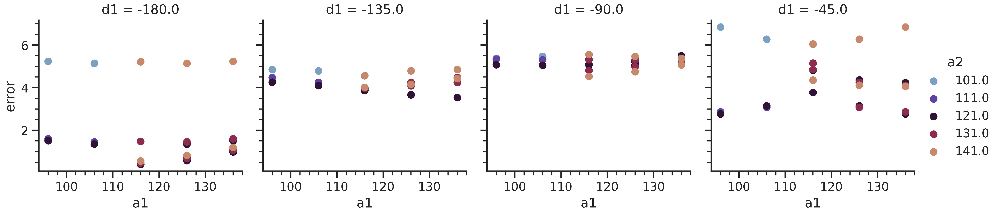

In [66]:
sns.set_theme(style="ticks")

grid = sns.FacetGrid(df, col="d1", hue="a2", palette="twilight",
                     col_wrap=4, size=3, aspect=1, legend_out=True)


g = grid.map(plt.scatter, "a1", "error", marker="o").add_legend()


plt.savefig("angle_dih_dep.pdf", bbox_inches="tight")

In [60]:
df2

,Unnamed: 0,frame,error,a1,a2,d1
0,0,1,0.407838,116.0,121.0,-180.0
1,1,2,1.352123,106.0,121.0,-180.0
2,2,3,1.510569,96.0,121.0,-180.0
3,3,4,1.599392,96.0,111.0,-180.0
4,4,6,1.482040,116.0,111.0,-180.0
5,5,7,5.220776,116.0,101.0,-180.0
6,6,5,1.461050,106.0,111.0,-180.0
7,7,8,5.146955,106.0,101.0,-180.0
8,8,9,5.233970,96.0,101.0,-180.0
9,9,10,4.851753,96.0,101.0,-135.0


/home/unibas/boittier/miniconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:337: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


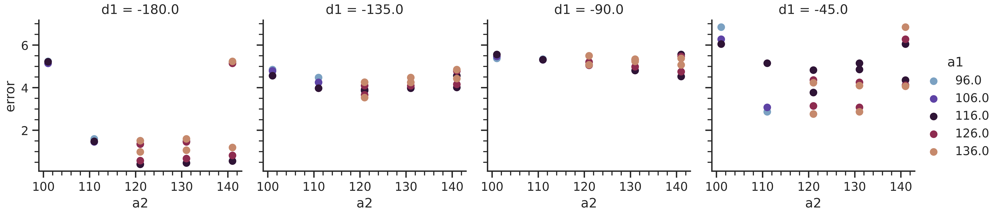

In [65]:
sns.set_theme(style="ticks")

grid = sns.FacetGrid(df, col="d1", hue="a1", palette="twilight",
                     col_wrap=4, size=3, aspect=1, legend_out=True)


g = grid.map(plt.scatter, "a2", "error", marker="o").add_legend()


plt.savefig("angle_dih_dep2.pdf", bbox_inches="tight")

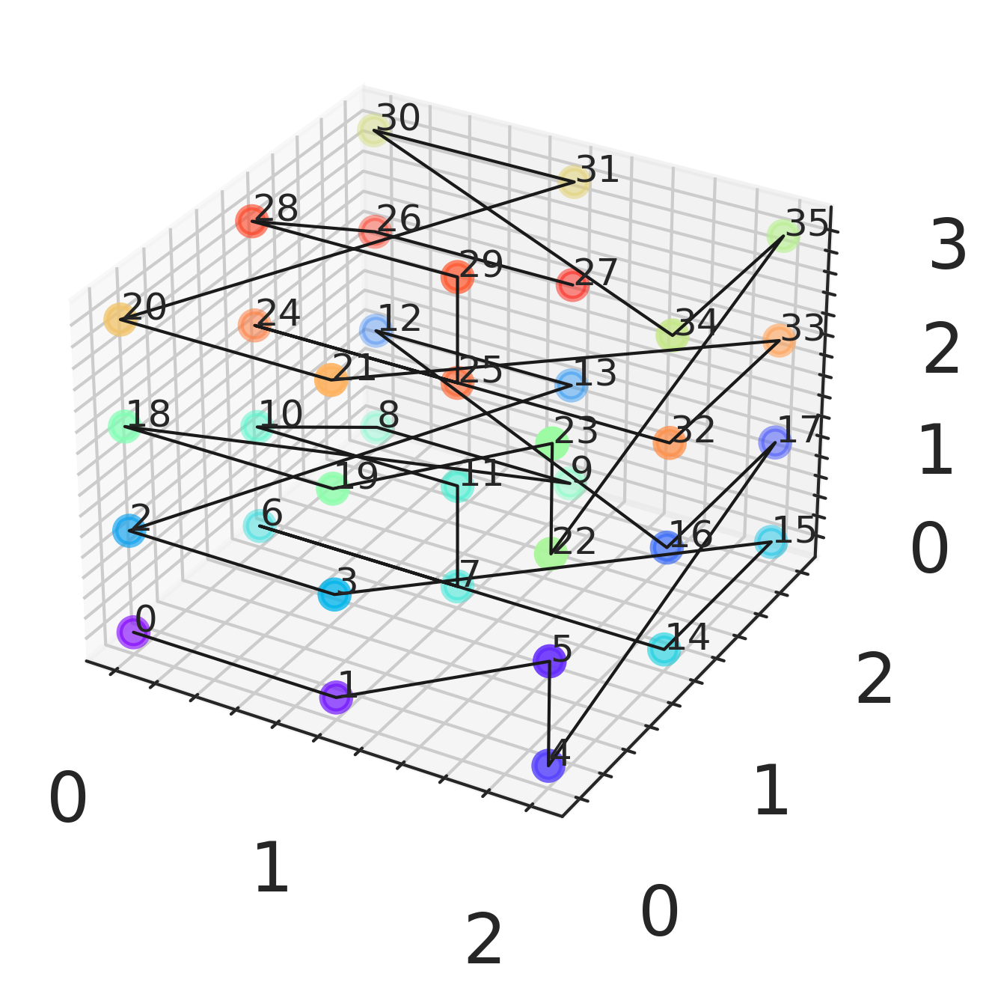

In [373]:
import pymorton 

def morton_sort(df, key1, key2, key3):
    # for each image, generate a tuple of len==3, representing the image's average RGB value
    xyz_values = [(int(x),int(y),int(z)) for x,y,z in 
                  zip(df[key1], df[key2], df[key3])]
    # using the average RGB values, compute the Z-order of each image
    hashed_imgs = list(zip(df["frame"],
                       [pymorton.interleave(*x) for x in xyz_values]))
    # returns a sorted-by-color list of photos found within the directory
    sorted_list = sorted(hashed_imgs, key=lambda y: y[1])
    return sorted_list, xyz_values

sorted_list, xyz_values = morton_sort(morton, "a1_", "a2_", "d1_")
xs = []
ys = []
zs = []
frames = []
for frame, hash_ in sorted_list:
    a, b, c = xyz_values[frame]
    frames.append(frame)
    xs.append(a)
    ys.append(b)
    zs.append(c)

norm = matplotlib.colors.Normalize(vmin=1, vmax=37)
cmap = cm.rainbow
m = cm.ScalarMappable(norm=norm, cmap=cmap)


fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(xs, ys, zs, ".-", c=m.to_rgba(range(1,37)))
ax.plot(xs, ys, zs, "-", c="k", linewidth=0.5)
for i, (x,y,z,frame) in enumerate(zip(xs, ys, zs, frames)):
#     if i%2 == 0:
#         pass
        ax.text(x, y, z, f"{frame}", size=6)
# cbar = fig.colorbar(m, ax=ax, orientation="horizontal", pad=0.23)

plt.savefig("z_order_path.pdf", bbox_inches="tight")

In [372]:
sorted_list

[(0, 0),
 (1, 1),
 (5, 2),
 (4, 3),
 (17, 4),
 (16, 5),
 (12, 6),
 (13, 7),
 (2, 8),
 (3, 10),
 (15, 12),
 (14, 14),
 (6, 16),
 (7, 17),
 (11, 20),
 (10, 21),
 (8, 24),
 (9, 28),
 (18, 32),
 (19, 33),
 (23, 34),
 (22, 35),
 (35, 36),
 (34, 37),
 (30, 38),
 (31, 39),
 (20, 40),
 (21, 42),
 (33, 44),
 (32, 46),
 (24, 48),
 (25, 49),
 (29, 52),
 (28, 53),
 (26, 56),
 (27, 60)]

In [359]:
# plt.plot(range(len(xs)), xs, "-o")
# plt.show()
# plt.plot(range(len(ys)), ys, "-o")
# plt.show()
# plt.plot(range(len(zs)), zs, "-o")
# plt.show()

In [422]:
morton = pd.read_csv("../morton_test.csv")
morton_25 = pd.read_csv("../morton_1_25.csv")

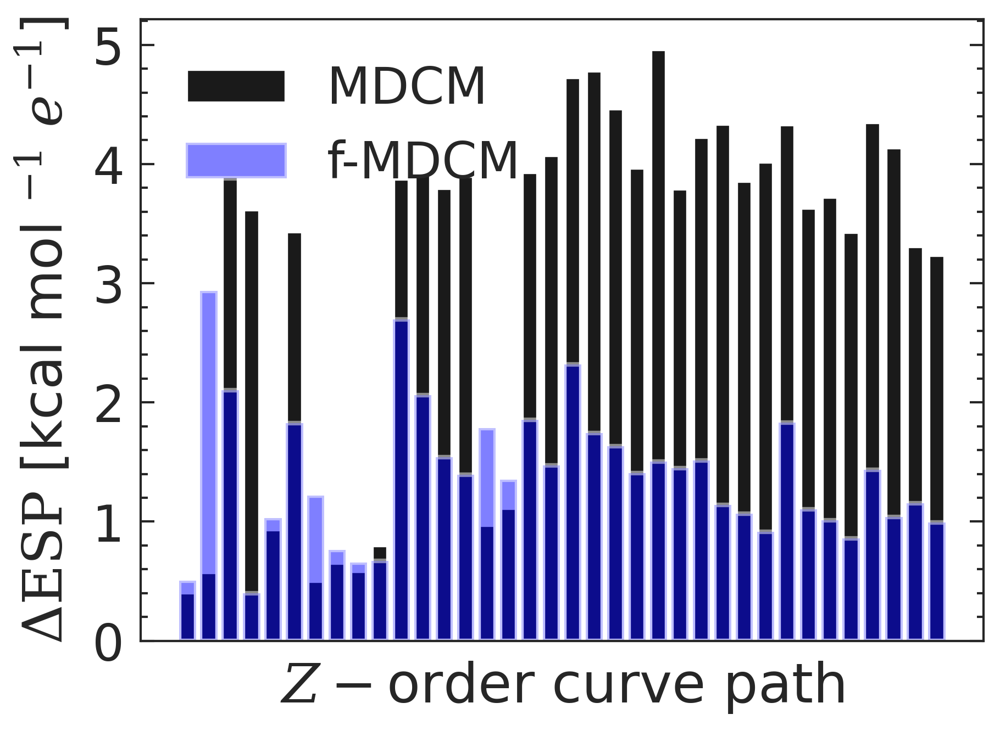

In [195]:
plt.bar(range(len(morton["error"])), morton["error"], color="k", label="MDCM")
plt.bar(range(len(morton["error"])), morton_25["error"], color="blue", alpha=0.5, label="f-MDCM")
plt.ylabel("$\Delta \mathrm{ESP}$ [kcal mol $^{-1}$ $e^{-1}$]")
plt.xlabel("$Z-$order curve path")
plt.xticks([])
plt.legend()
plt.savefig("zorder.png", bbox_inches="tight", dpi=300)

In [363]:
s_a1 = list(set(morton["a1"]))
s_a1.sort()
s_a2 = list(set(morton["a2"]))
s_a2.sort()
s_d1 = list(set(morton["d1"]))
s_d1.sort()
morton["a1_"] = morton["a1"].apply(s_a1.index)
morton["a2_"] = morton["a2"].apply(s_a2.index)
morton["d1_"] = morton["d1"].apply(s_d1.index)
morton

,Unnamed: 0,frame,error,a1,a2,d1,a1_,a2_,d1_
0,0,0,0.408281,116.0,121.0,-180.0,0,0,0
1,1,1,0.578881,126.0,121.0,-180.0,1,0,0
2,2,17,3.904428,116.0,121.0,-135.0,0,0,1
3,3,16,3.620638,126.0,121.0,-135.0,1,0,1
4,4,2,0.938004,136.0,121.0,-180.0,2,0,0
5,5,15,3.437630,136.0,121.0,-135.0,2,0,1
6,6,5,0.504429,116.0,131.0,-180.0,0,1,0
7,7,4,0.657411,126.0,131.0,-180.0,1,1,0
8,8,6,0.585737,116.0,141.0,-180.0,0,2,0
9,9,7,0.801981,126.0,141.0,-180.0,1,2,0


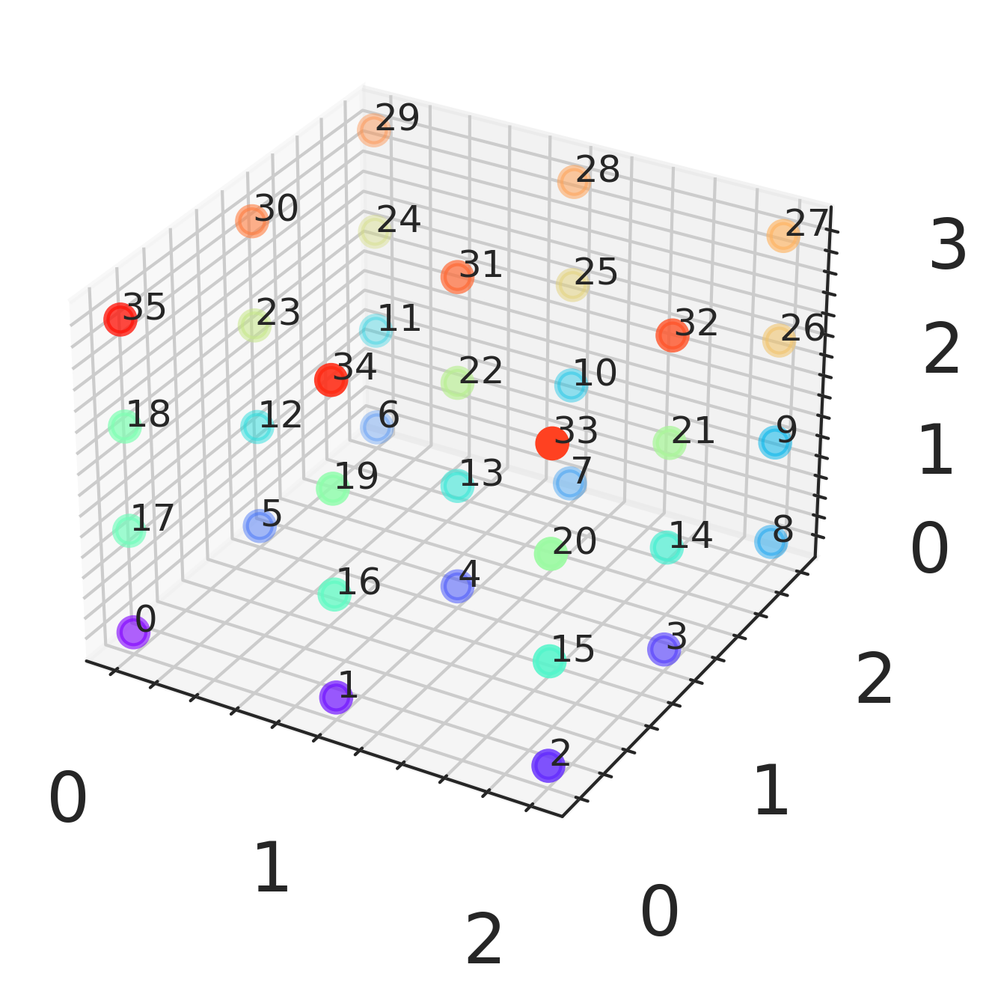

In [365]:
morton_sorted = morton.sort_values("frame")
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(morton_sorted["a1_"], morton_sorted["a2_"], 
           morton_sorted["d1_"], c=m.to_rgba(range(1,37)))

for i, (x,y,z,frame) in enumerate(zip(morton_sorted["a1_"], morton_sorted["a2_"], morton_sorted["d1_"], morton_sorted["frame"])):
    ax.text(x, y, z, f"{frame}", size=6)

In [378]:
# def key_to_frame(morton, i):
#     _ = morton[morton["a1_"] == i[0]]
#     _ = _[_["a2_"] == i[1]]
#     _ = _[_["d1_"] == i[2]]
#     return int(_["frame"])

# visited = []

# for i in zip(morton["a1_"], morton["a2_"], morton["d1_"]):
#     print(i)
#     n = neighbours(np.array(i), ranges)
#     frame = key_to_frame(morton, i)
#     print("visiting: frame_", frame)
#     visited.append(frame)
#     print(n)
#     n = [key_to_frame(morton, i) for i in n]
#     print("neighbours: ", n)
#     for neighbour in n:
#         if neighbour not in visited:
#             print("    visiting: frame_", neighbour)
#             visited.append(neighbour)
            


In [799]:
def neighbours(point, ranges):
    neighbours = []
    for i, dim in enumerate(point):
        if ranges[i][0] <= (dim - 1) <= ranges[i][1]:
            n = point.copy()
            n[i] = dim - 1
            neighbours.append(tuple(n))
        if ranges[i][0] <= (dim + 1) <= ranges[i][1]:
            n = point.copy()
            n[i] = dim + 1
            neighbours.append(tuple(n))
            
    return neighbours


def key_to_frame(df, i):
    _ = df[df["a1_"] == i[0]]
    _ = _[_["a2_"] == i[1]]
    _ = _[_["d1_"] == i[2]]
    return int(_["frame"])

df_ = pd.DataFrame({"frame": frames, "a1_": xs, "a2_": ys, "d1_": zs})

gradients = []
colors = []
alphas = []

ranges = [[0, 2], [0, 2], [0, 3]]

visited = []

last_visited = 0
last_pos = [0,0,0]

for key, j in sorted_list:
    r = df_[df_["frame"] == key]
    i = np.array([int(r["a1_"]), int(r["a2_"]), int(r["d1_"])])
    
    gradients.append([last_pos, i])
    colors.append("r")
    alphas.append(1)
    
    ns = neighbours(i, ranges)
    frame = key_to_frame(df_, i)
    print("visiting: frame_", frame)
    visited.append(frame)
    
    n = [key_to_frame(df_, ii) for ii in ns]
    #print("neighbours: ", n)
    for index, neighbour in enumerate(n):
        if neighbour not in visited:
            print("    visiting: frame_", neighbour)
            visited.append(neighbour)
            gradients.append([i, ns[index]])
            colors.append("k")
            alphas.append(0.4)
            
    last_pos = i
            

visiting: frame_ 27
    visiting: frame_ 26
    visiting: frame_ 20
    visiting: frame_ 4
    visiting: frame_ 36
visiting: frame_ 5
    visiting: frame_ 6
    visiting: frame_ 10
visiting: frame_ 26
    visiting: frame_ 25
    visiting: frame_ 21
    visiting: frame_ 37
visiting: frame_ 4
    visiting: frame_ 11
visiting: frame_ 3
    visiting: frame_ 2
    visiting: frame_ 28
visiting: frame_ 45
    visiting: frame_ 44
    visiting: frame_ 46
    visiting: frame_ 42
    visiting: frame_ 18
    visiting: frame_ 50
visiting: frame_ 44
    visiting: frame_ 43
    visiting: frame_ 19
    visiting: frame_ 51
visiting: frame_ 19
    visiting: frame_ 12
visiting: frame_ 13
    visiting: frame_ 14
visiting: frame_ 18
    visiting: frame_ 17
visiting: frame_ 12
visiting: frame_ 43
    visiting: frame_ 52
visiting: frame_ 11
visiting: frame_ 16
    visiting: frame_ 23
    visiting: frame_ 15
    visiting: frame_ 47
visiting: frame_ 14
    visiting: frame_ 9
visiting: frame_ 17
    visiting: f

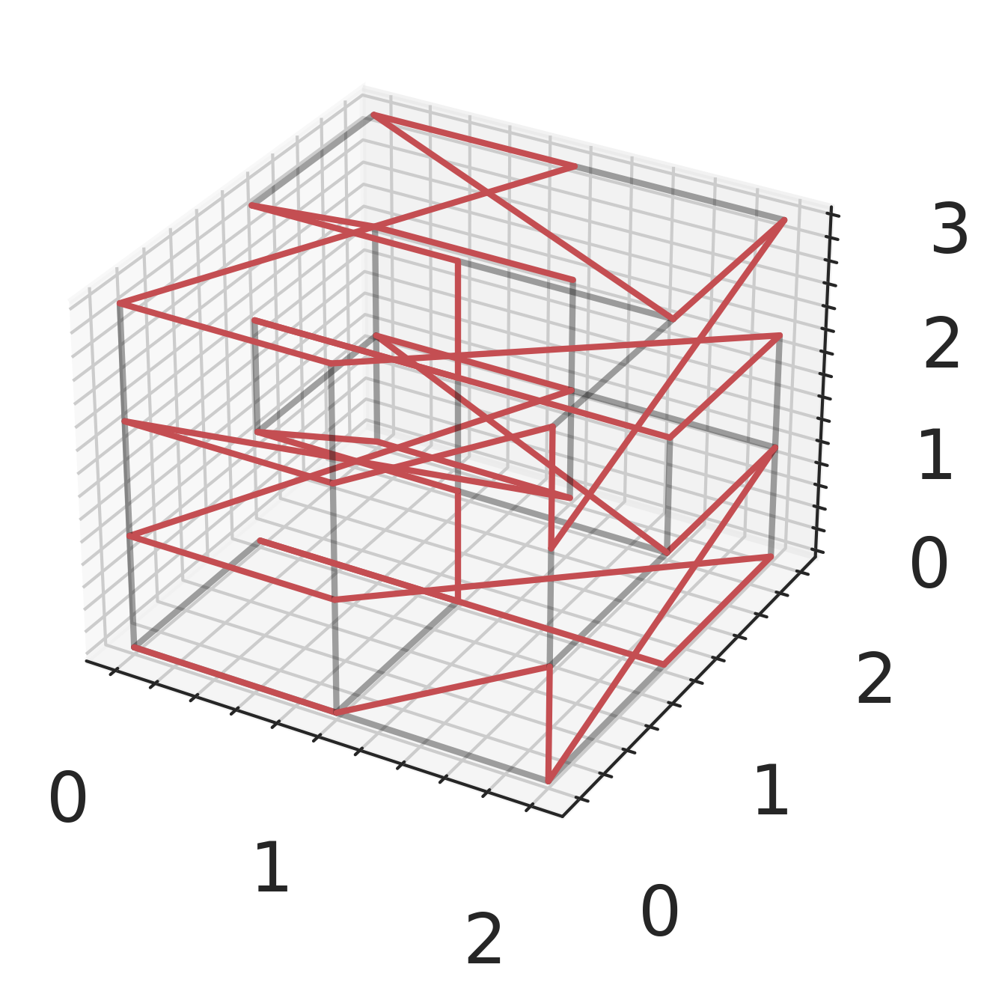

In [421]:

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for i, g in enumerate(gradients):
    ax.plot(*np.array(g).T, c=colors[i], alpha=alphas[i])
#     ax.plot()


In [413]:

sorted_list

[(0, 0),
 (1, 1),
 (5, 2),
 (4, 3),
 (17, 4),
 (16, 5),
 (12, 6),
 (13, 7),
 (2, 8),
 (3, 10),
 (15, 12),
 (14, 14),
 (6, 16),
 (7, 17),
 (11, 20),
 (10, 21),
 (8, 24),
 (9, 28),
 (18, 32),
 (19, 33),
 (23, 34),
 (22, 35),
 (35, 36),
 (34, 37),
 (30, 38),
 (31, 39),
 (20, 40),
 (21, 42),
 (33, 44),
 (32, 46),
 (24, 48),
 (25, 49),
 (29, 52),
 (28, 53),
 (26, 56),
 (27, 60)]

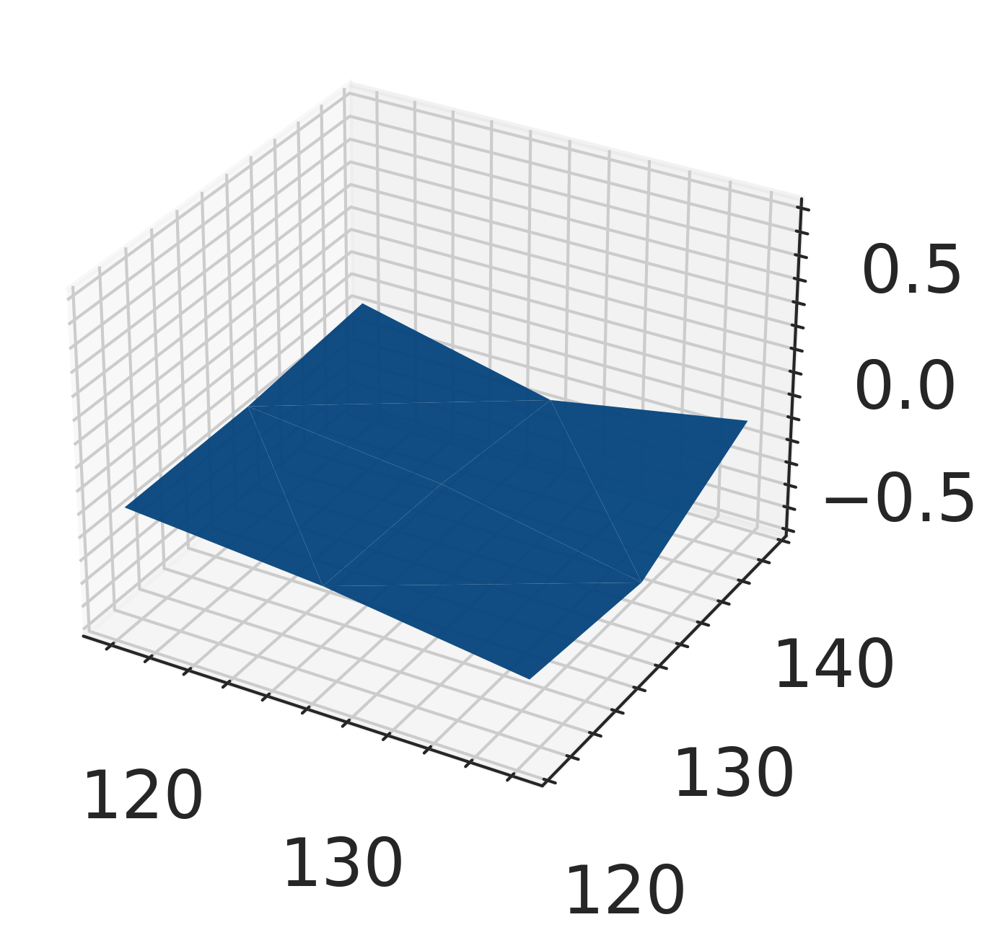

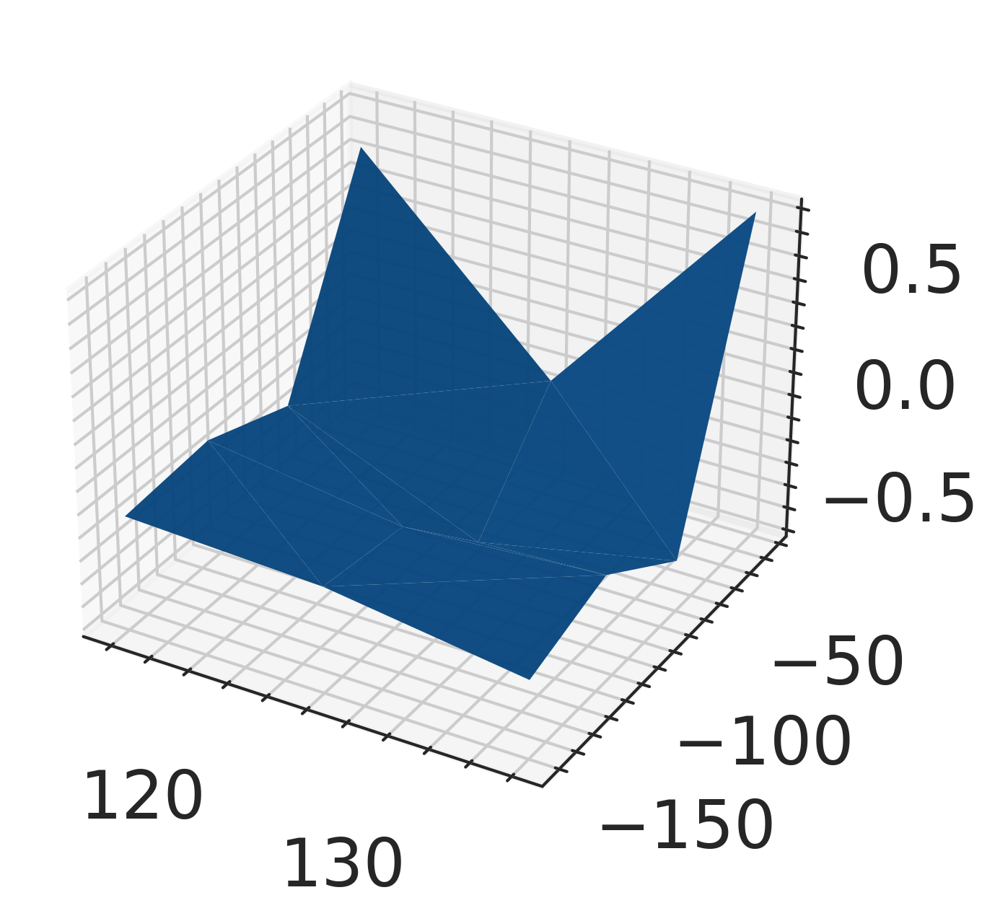

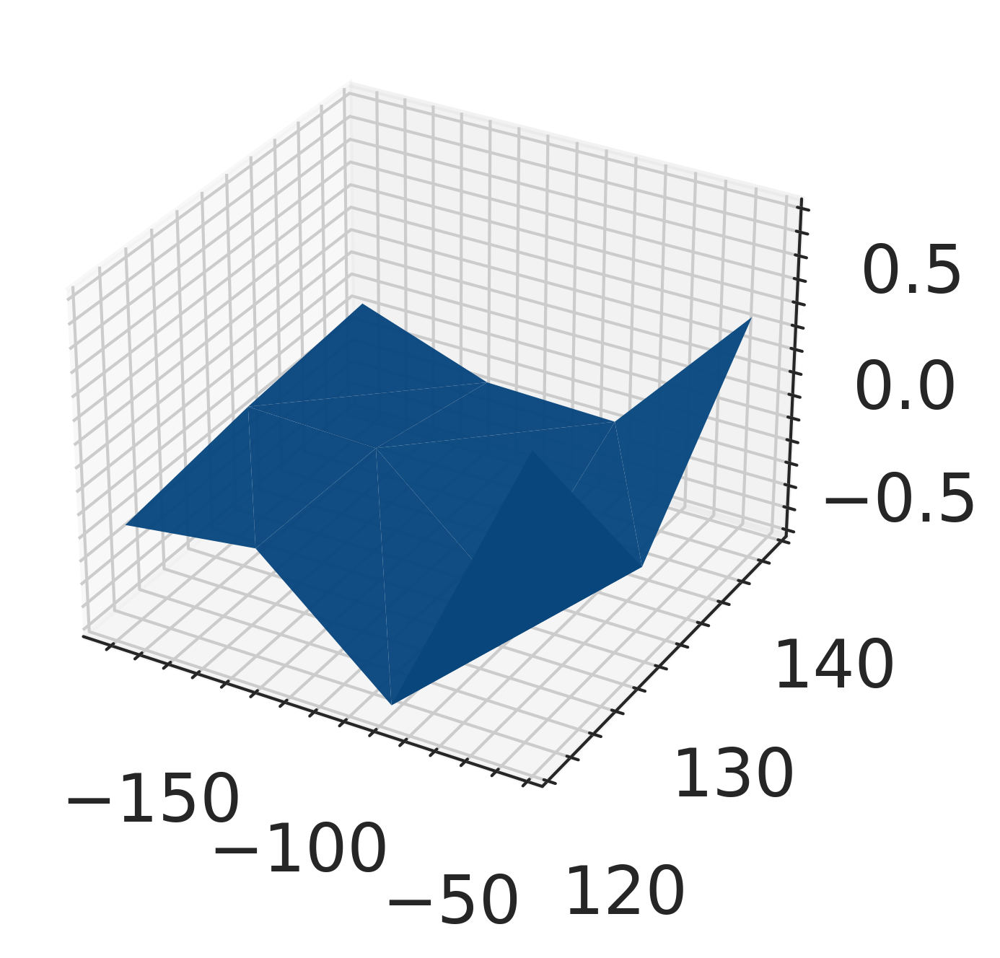

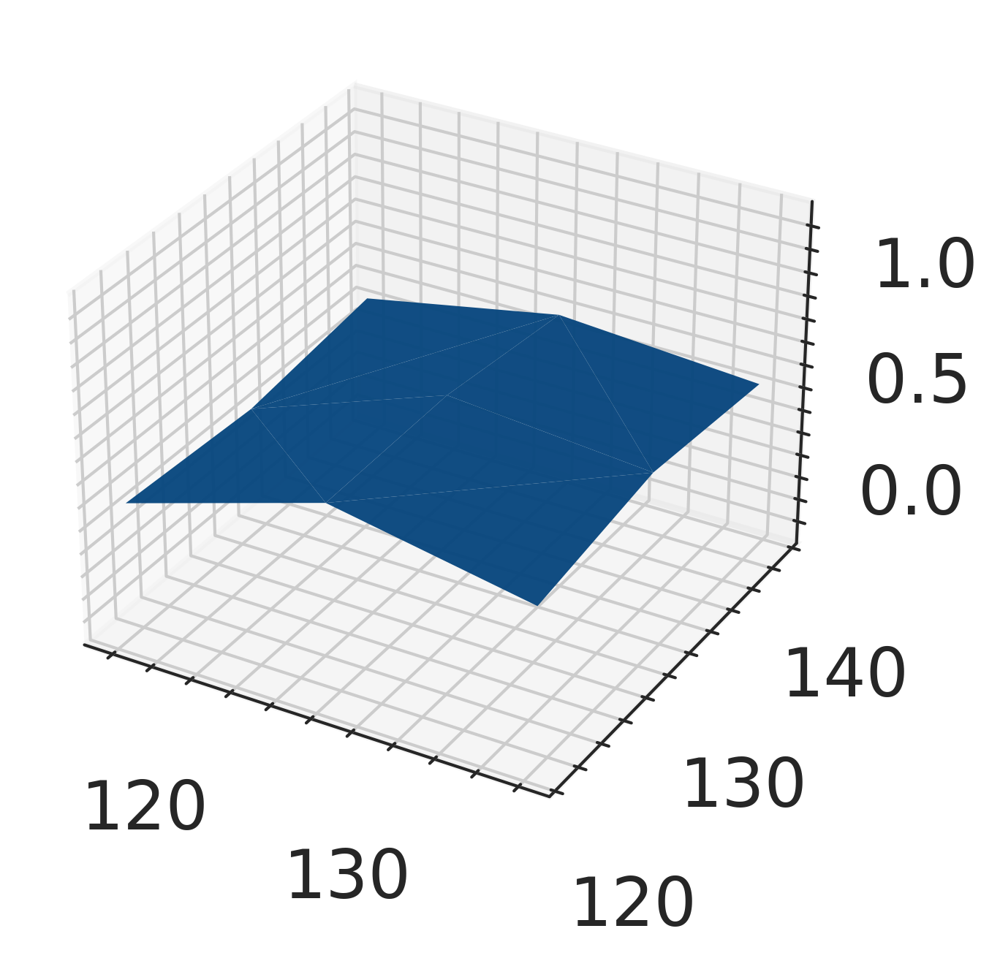

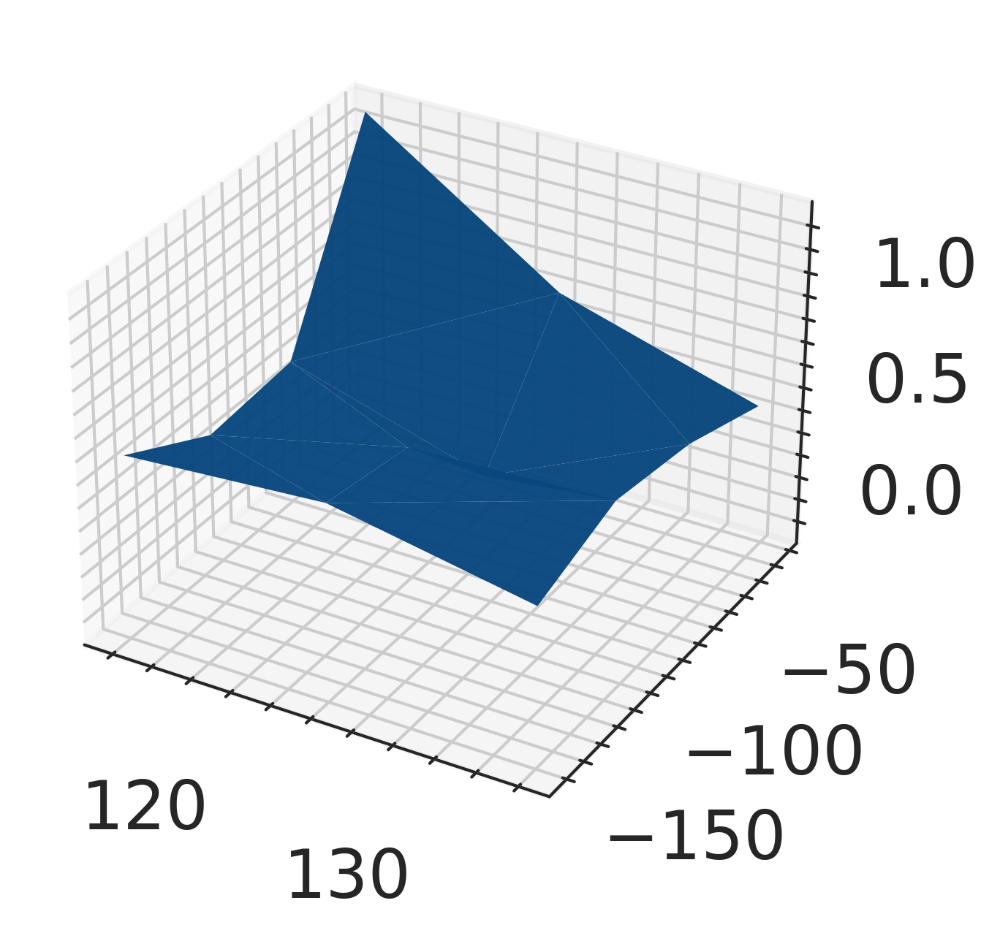

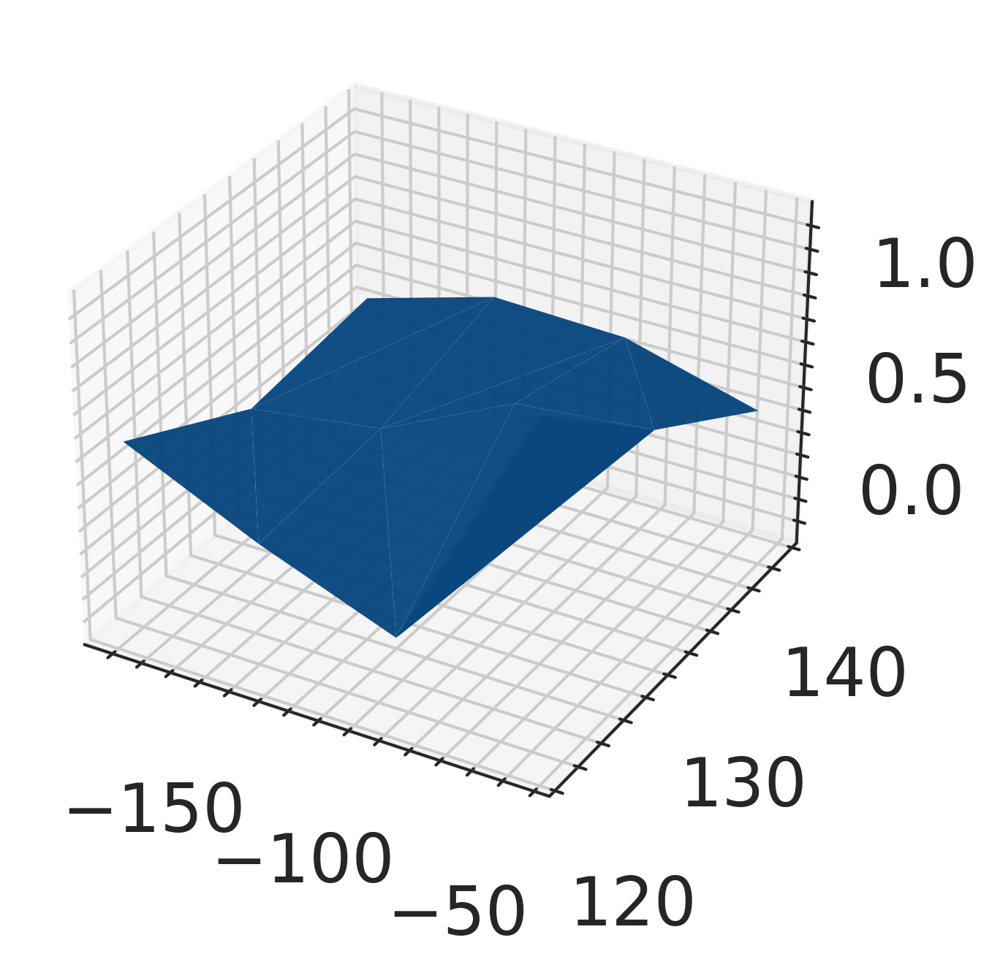

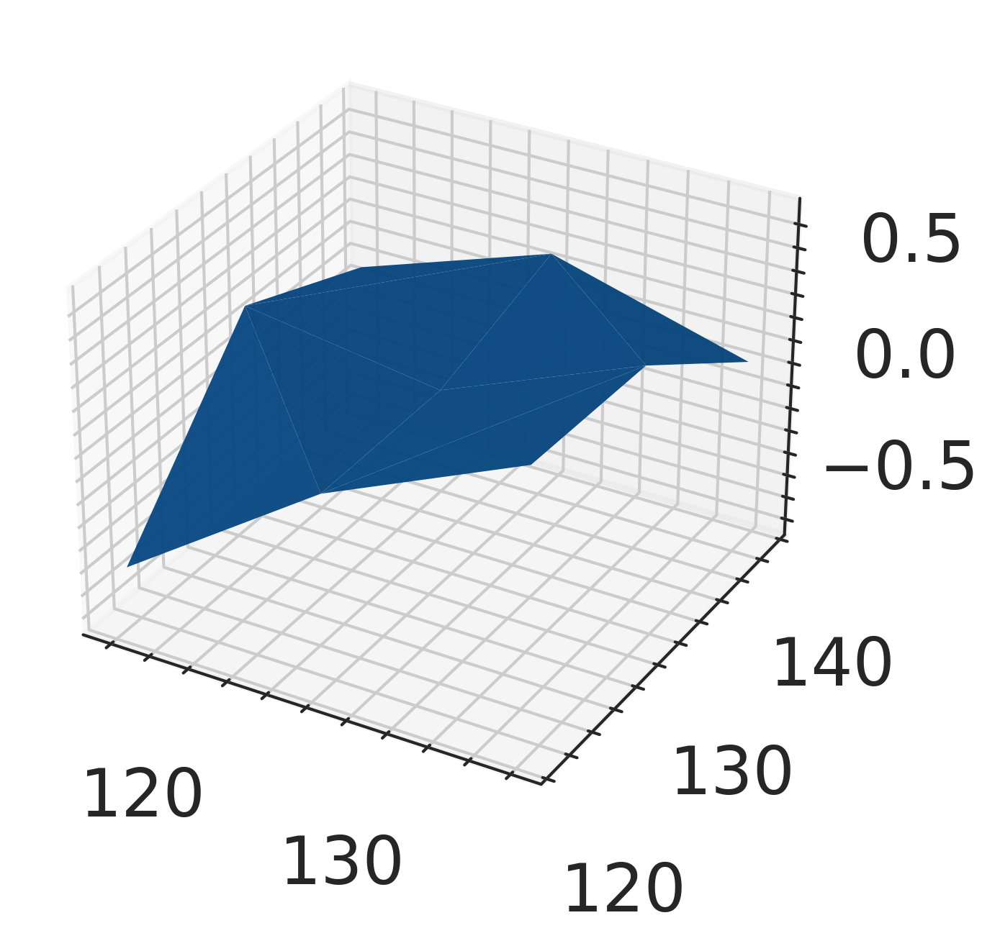

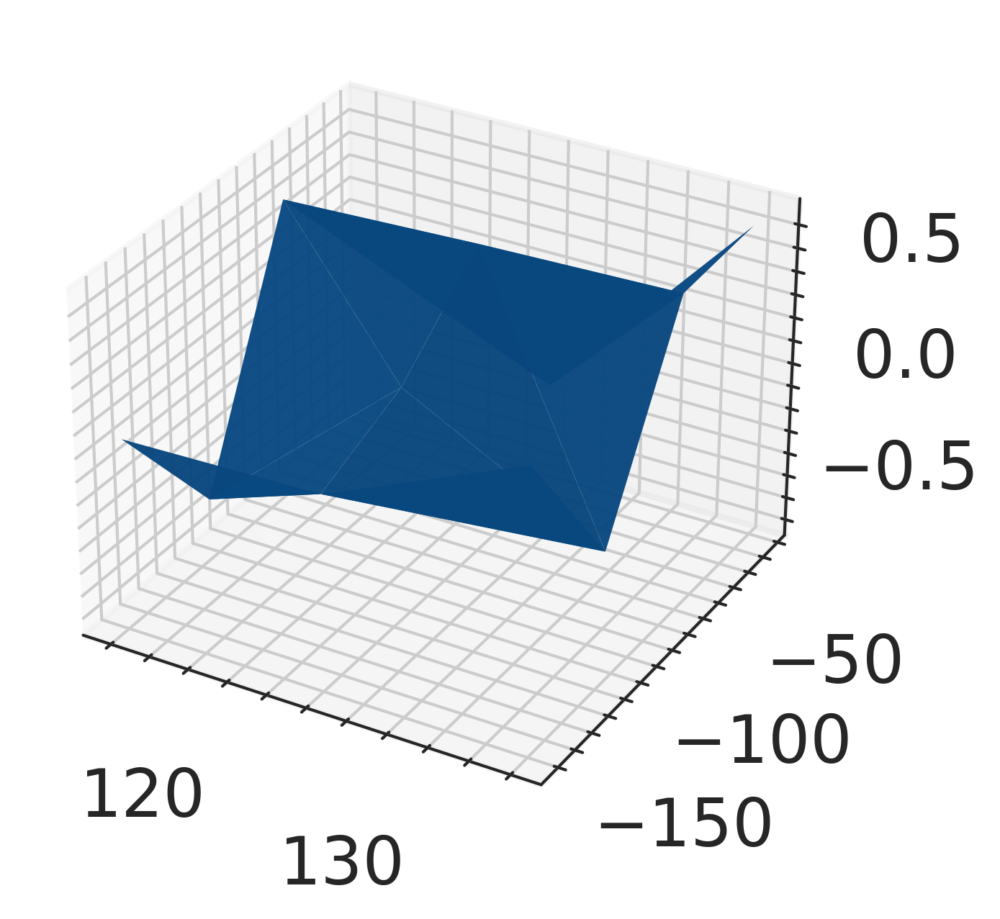

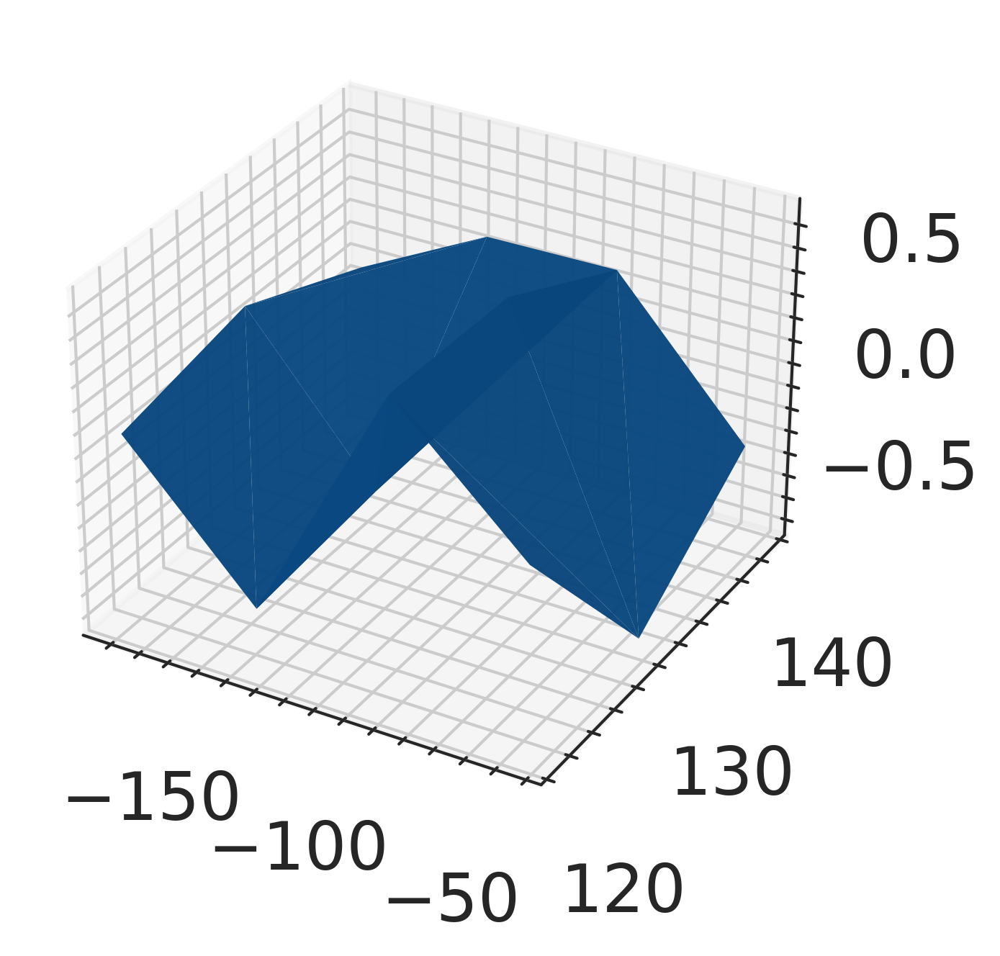

In [461]:
for x in ["x", "y", "z"]:
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_trisurf(morton_25["a1"], morton_25["a2"], morton_25[f"{x}_c1"], linewidth=0, alpha=0.97)
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_trisurf(morton_25["a1"], morton_25["d1"], morton_25[f"{x}_c1"], linewidth=0, alpha=0.97)
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_trisurf(morton_25["d1"], morton_25["a2"], morton_25[f"{x}_c1"], linewidth=0, alpha=0.97)


<AxesSubplot:xlabel='Unnamed: 0'>

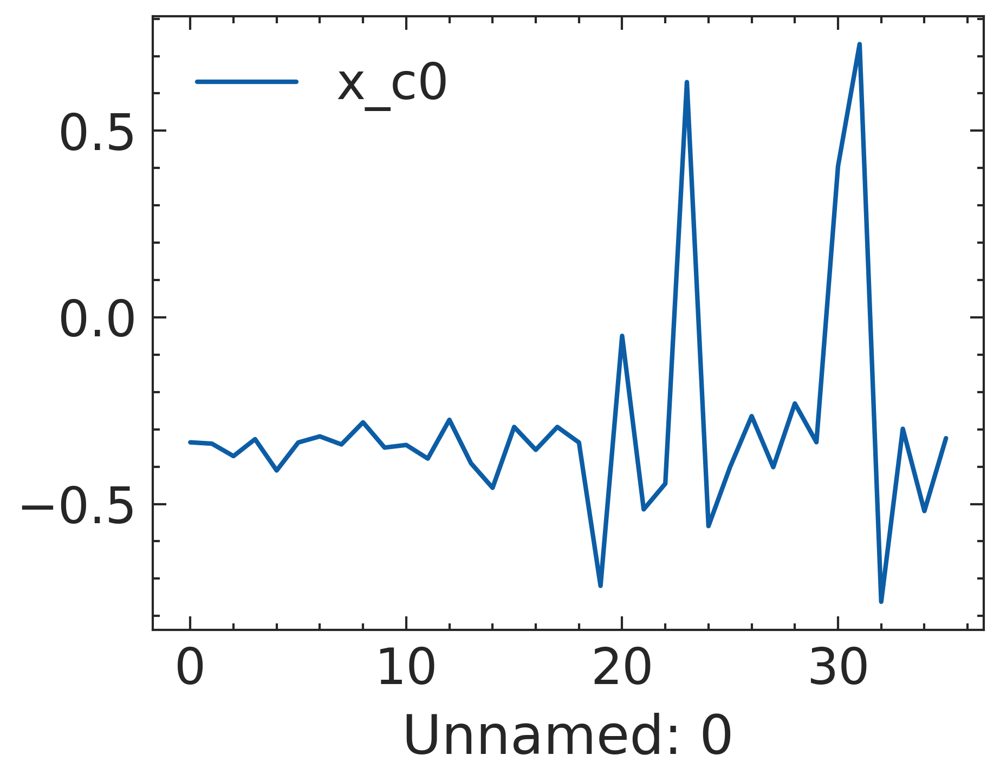

In [463]:
morton_25.plot("Unnamed: 0", "x_c0")

<AxesSubplot:xlabel='Unnamed: 0'>

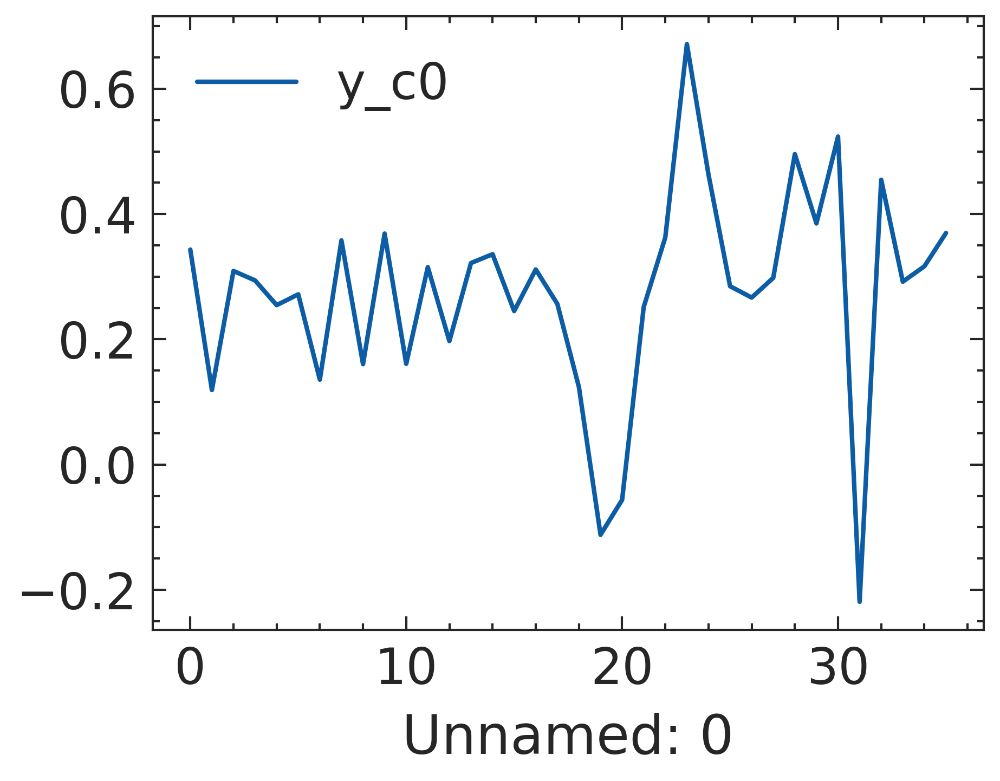

In [464]:
morton_25.plot("Unnamed: 0", "y_c0")

<AxesSubplot:xlabel='Unnamed: 0'>

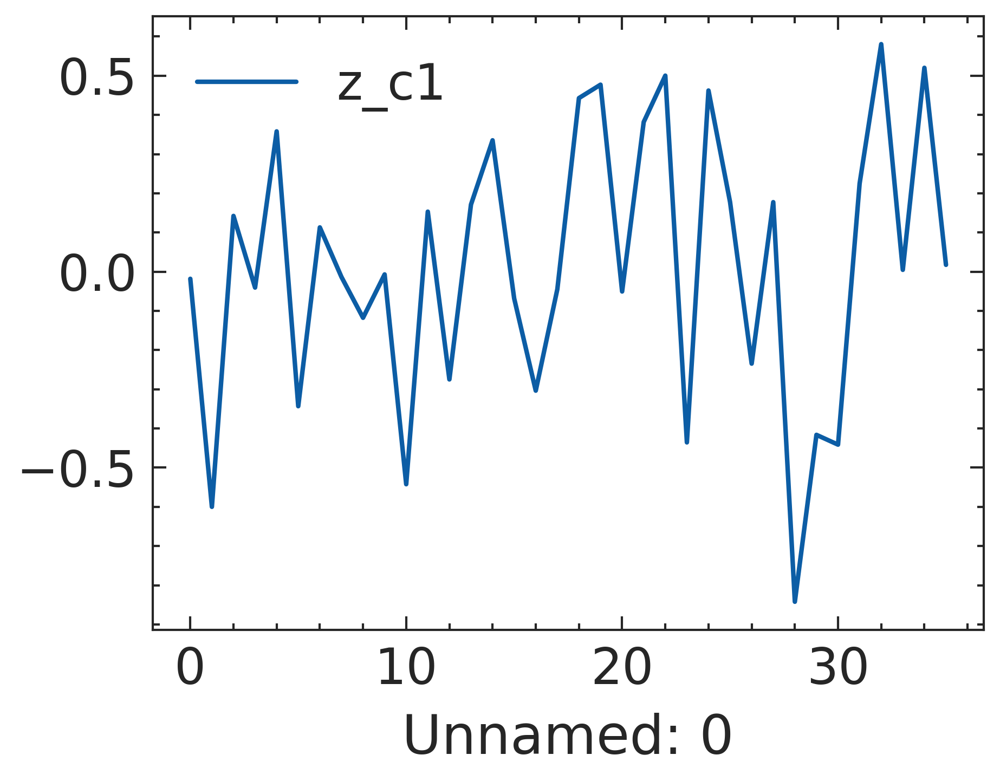

In [467]:
morton_25.plot("Unnamed: 0", "z_c1")

In [477]:
import cclib
gaussian_scan_output = "/home/unibas/boittier/RDKit_G2/amide1.pdb/SCAN_1_2_3_4_S_36_10.0/test/SCAN_amide1.pdb.out"
data_path = "/data/unibas/boittier/morton_1_25"
csv_out_name = "morton_1_25.csv"

#gaussian_scan_output = "/home/unibas/boittier/RDKit_G2/amide1.pdb/SCAN_1_2_3_4_S_36_10.0/SCAN_amide2.pdb.out"
#data_path = "/data/unibas/boittier/amide2/"
#csv_out_name = "amide2.csv"

p = cclib.io.ccopen(gaussian_scan_output)
p = p.parse()
scan_names = p.scannames
scan_parms = np.array(p.scanparm)

print(scan_names)

a1 = [int(x//1) for x in scan_parms[0]]
a2 = [int(x//1) for x in scan_parms[1]]
d1 = [int(x//1) for x in scan_parms[2]]

# a1 = {i : x for i, x in enumerate(a1)}
# a2 = {i : x for i, x in enumerate(a2)}
# d1 = {i : x for i, x in enumerate(d1)}

len(set(d1))

['A(1,2,8)', 'A(2,8,10)', 'D(1,2,8,10)']


10

visiting: frame_ 12
    visiting: frame_ 13
    visiting: frame_ 11
    visiting: frame_ 19
visiting: frame_ 13
    visiting: frame_ 14
    visiting: frame_ 10
    visiting: frame_ 18
visiting: frame_ 11
    visiting: frame_ 4
    visiting: frame_ 20
visiting: frame_ 10
    visiting: frame_ 9
    visiting: frame_ 5
    visiting: frame_ 21
visiting: frame_ 19
    visiting: frame_ 44
visiting: frame_ 18
    visiting: frame_ 17
    visiting: frame_ 45
visiting: frame_ 20
    visiting: frame_ 27
    visiting: frame_ 43
visiting: frame_ 21
    visiting: frame_ 22
    visiting: frame_ 26
    visiting: frame_ 42
visiting: frame_ 14
    visiting: frame_ 15
visiting: frame_ 15
    visiting: frame_ 8
    visiting: frame_ 16
visiting: frame_ 9
    visiting: frame_ 6
visiting: frame_ 8
    visiting: frame_ 7
    visiting: frame_ 23
visiting: frame_ 17
    visiting: frame_ 46
visiting: frame_ 16
    visiting: frame_ 47
visiting: frame_ 22
    visiting: frame_ 25
    visiting: frame_ 41
visiting: fr

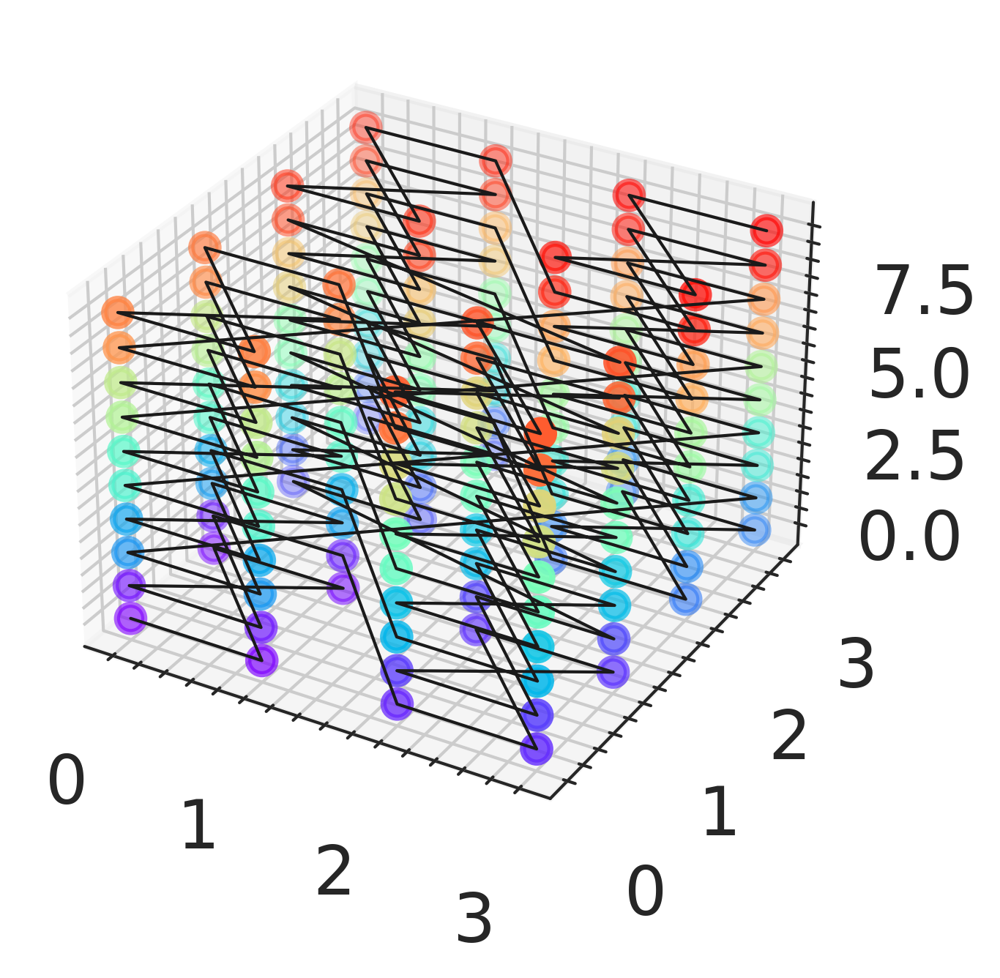

In [789]:
def neighbours(point, ranges):
    neighbours = []
    for i, dim in enumerate(point):
        if ranges[i][0] <= (dim - 1) <= ranges[i][1]:
            n = point.copy()
            n[i] = dim - 1
            neighbours.append(tuple(n))
        if ranges[i][0] <= (dim + 1) <= ranges[i][1]:
            n = point.copy()
            n[i] = dim + 1
            neighbours.append(tuple(n))
            
    return neighbours


def key_to_frame(df, i):
    _ = df[df["a1_"] == i[0]]
    _ = _[_["a2_"] == i[1]]
    _ = _[_["d1_"] == i[2]]
    return int(list(_["frame"])[0])

def add_morton_int(morton):
    s_a1 = list(set(morton["a1"]))
    s_a1.sort()
    s_a2 = list(set(morton["a2"]))
    s_a2.sort()
    s_d1 = list(set(morton["d1"]))
    s_d1.sort()
    morton["a1_"] = morton["a1"].apply(s_a1.index)
    morton["a2_"] = morton["a2"].apply(s_a2.index)
    morton["d1_"] = morton["d1"].apply(s_d1.index)
    return morton


import pymorton 

def morton_sort(df, key1, key2, key3):
    # for each image, generate a tuple of len==3, representing the image's average RGB value
    xyz_values = [(int(x),int(y),int(z)) for x,y,z in 
                  zip(df[key1], df[key2], df[key3])]
    # using the average RGB values, compute the Z-order of each image
    hashed_imgs = list(zip(df["frame"],
                       [pymorton.interleave(*x) for x in xyz_values]))
    # returns a sorted-by-color list of photos found within the directory
    sorted_list = sorted(hashed_imgs, key=lambda y: y[1])
    return sorted_list, xyz_values


df_ = pd.DataFrame({"frame": list(range(len(a1))), "a1": a1, "a2": a2, 
                                  "d1": d1})
df_ = add_morton_int(df_)


sorted_list, xyz_values = morton_sort(df_, "a1_", "a2_", "d1_")
xs = []
ys = []
zs = []
frames = []
for frame, hash_ in sorted_list:
    a, b, c = xyz_values[frame]
    frames.append(frame)
    xs.append(a)
    ys.append(b)
    zs.append(c)

norm = matplotlib.colors.Normalize(vmin=1, vmax=161)
cmap = cm.rainbow
m = cm.ScalarMappable(norm=norm, cmap=cmap)


fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(xs, ys, zs, ".-", c=m.to_rgba(range(1,161)))
ax.plot(xs, ys, zs, "-", c="k", linewidth=0.5)
for i, (x,y,z,frame) in enumerate(zip(xs, ys, zs, frames)):
#     if i%2 == 0:
        pass
#         ax.text(x, y, z, f"{frame}", size=6)
# cbar = fig.colorbar(m, ax=ax, orientation="horizontal", pad=0.23)

plt.savefig("z_order_path.pdf", bbox_inches="tight")

####

gradients = []
colors = []
alphas = []

ranges = [[0, 3], [0, 3], [0, 9]]

visited = []
sub_visit = 0
last_visited = 0
last_pos = [0,0,0]

for key, j in sorted_list:
    r = df_[df_["frame"] == key]
    i = np.array([int(r["a1_"]), int(r["a2_"]), int(r["d1_"])])
    
    gradients.append([last_pos, i])
    colors.append("r")
    alphas.append(1)
    
    ns = neighbours(i, ranges)
    frame = key_to_frame(df_, i)
    print("visiting: frame_", frame)
    visited.append(frame)
    
    n = [key_to_frame(df_, ii) for ii in ns]
    #print("neighbours: ", n)
    for index, neighbour in enumerate(n):
        if neighbour not in visited:
            sub_visit += 1
            print("    visiting: frame_", neighbour)
            visited.append(neighbour)
            gradients.append([i, ns[index]])
            colors.append("k")
            alphas.append(0.4)
            
    last_pos = i

print(sub_visit)

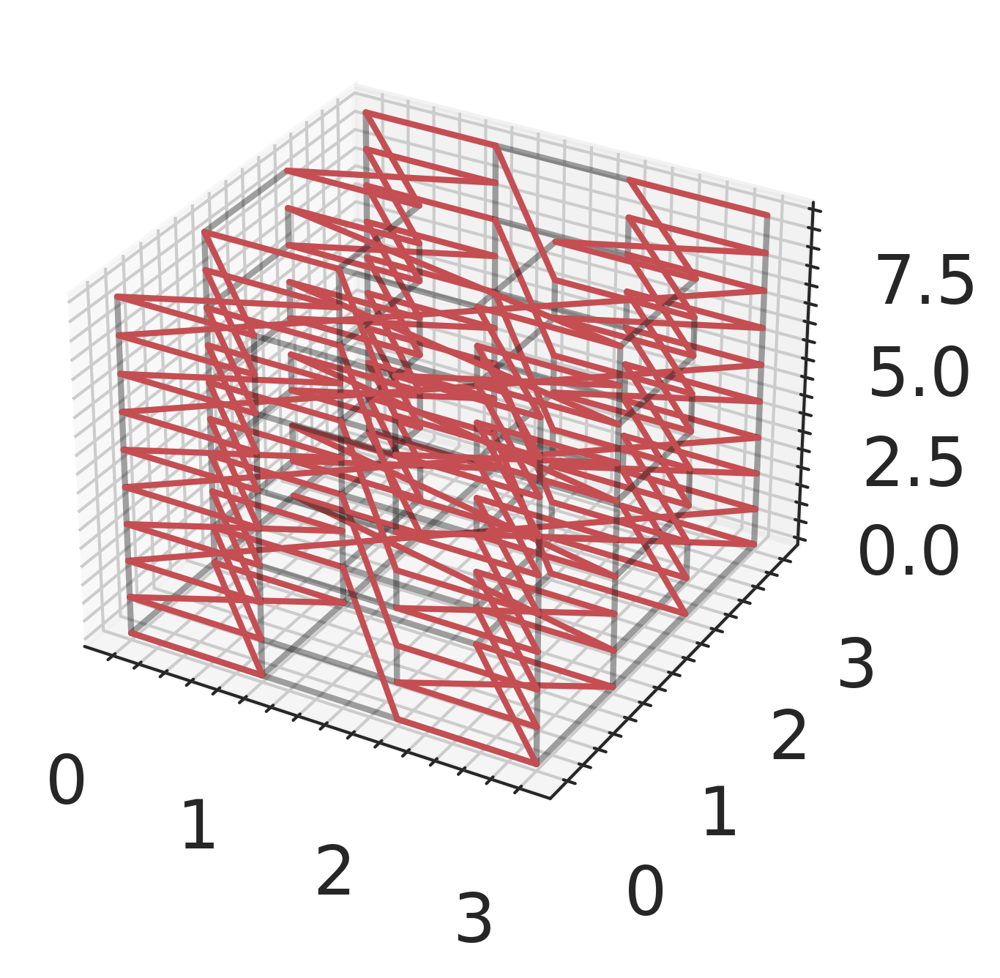

In [790]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for i, g in enumerate(gradients):
    ax.plot(*np.array(g).T, c=colors[i], alpha=alphas[i])
#     ax.plot()

In [487]:
s = "vmd "
for i,h in sorted_list:
    s+=f"SCAN_amide1.pdb-{i}.xyz "
print(s)

vmd SCAN_amide1.pdb-12.xyz SCAN_amide1.pdb-13.xyz SCAN_amide1.pdb-11.xyz SCAN_amide1.pdb-10.xyz SCAN_amide1.pdb-19.xyz SCAN_amide1.pdb-18.xyz SCAN_amide1.pdb-20.xyz SCAN_amide1.pdb-21.xyz SCAN_amide1.pdb-14.xyz SCAN_amide1.pdb-15.xyz SCAN_amide1.pdb-9.xyz SCAN_amide1.pdb-8.xyz SCAN_amide1.pdb-17.xyz SCAN_amide1.pdb-16.xyz SCAN_amide1.pdb-22.xyz SCAN_amide1.pdb-23.xyz SCAN_amide1.pdb-4.xyz SCAN_amide1.pdb-5.xyz SCAN_amide1.pdb-3.xyz SCAN_amide1.pdb-2.xyz SCAN_amide1.pdb-27.xyz SCAN_amide1.pdb-26.xyz SCAN_amide1.pdb-28.xyz SCAN_amide1.pdb-29.xyz SCAN_amide1.pdb-6.xyz SCAN_amide1.pdb-7.xyz SCAN_amide1.pdb-1.xyz SCAN_amide1.pdb-0.xyz SCAN_amide1.pdb-25.xyz SCAN_amide1.pdb-24.xyz SCAN_amide1.pdb-30.xyz SCAN_amide1.pdb-31.xyz SCAN_amide1.pdb-44.xyz SCAN_amide1.pdb-45.xyz SCAN_amide1.pdb-43.xyz SCAN_amide1.pdb-42.xyz SCAN_amide1.pdb-51.xyz SCAN_amide1.pdb-50.xyz SCAN_amide1.pdb-52.xyz SCAN_amide1.pdb-53.xyz SCAN_amide1.pdb-46.xyz SCAN_amide1.pdb-47.xyz SCAN_amide1.pdb-41.xyz SCAN_amide1.pdb-4

In [528]:
order = [i for i,x in sorted_list]
before = []
after = []
s = ""
isBefore = True
for i in order:
    if isBefore:
        before.append(i)
    else:
        after.append(i)
    if i == 0:
        isBefore = False
    s += f"{i} "
    
before.reverse()

s = ""
for i in before:
    s += f"{i} "
print(s)
print()
s = ""
for i in range(1,160):
    s += f"{i} "
print(s)

0 1 7 6 29 28 26 27 2 3 5 4 23 22 16 17 8 9 15 14 21 20 18 19 10 11 13 12 

1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 


Unnamed: 0    159.000000
frame         159.000000
error           6.306496
a1            116.000000
a2            121.000000
                 ...    
q_c19          -0.992374
q_c20           0.058780
q_c21           0.221421
q_c22          -0.468575
q_c23           0.249620
Length: 102, dtype: float64

3.5881912787831256 6.30649553


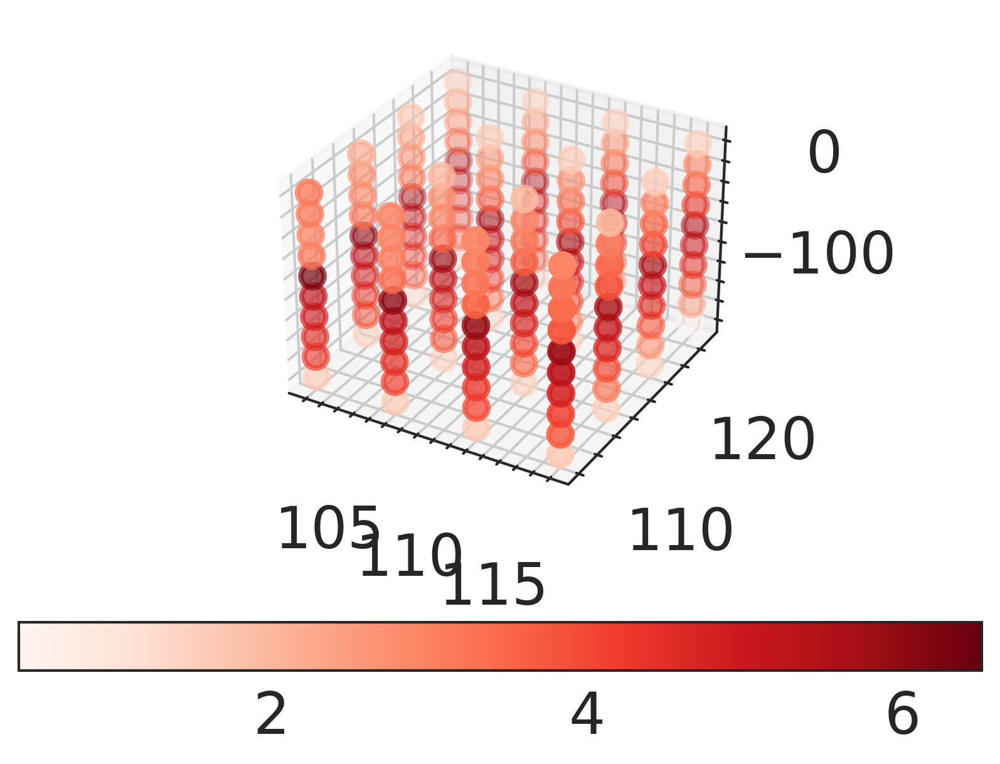

In [752]:
morton_large = pd.read_csv("../morton-large.csv")
norm = matplotlib.colors.Normalize(vmin=0.4, vmax=6.5)
cmap = cm.Reds
m = cm.ScalarMappable(norm=norm, cmap=cmap)
cs = m.to_rgba(morton_large["error"])
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(morton_large["a1"], morton_large["a2"], 
           morton_large["d1"], c=cs)
plt.colorbar(m, orientation="horizontal")
plt.savefig("error_grid_scan.pdf")
e = morton_large["error"]
print(np.mean(e), np.max(e))

1.98444854805375 4.677771533


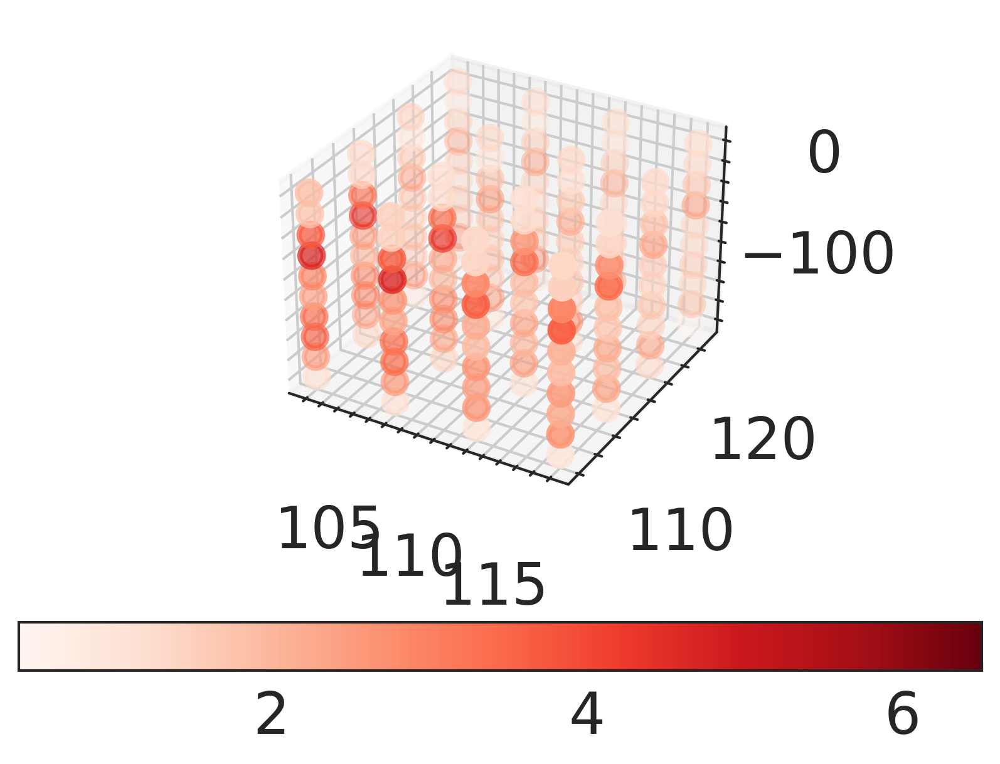

In [753]:
morton_large5 = pd.read_csv("../morton-large5.csv")
norm = matplotlib.colors.Normalize(vmin=0.4, vmax=6.5)
cmap = cm.Reds
m = cm.ScalarMappable(norm=norm, cmap=cmap)
cs = m.to_rgba(morton_large5["error"])
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(morton_large5["a1"], morton_large5["a2"], 
           morton_large5["d1"], c=cs)
plt.colorbar(m, orientation="horizontal")
plt.savefig("error_grid_morton.pdf")
e = morton_large5["error"]
print(np.mean(e), np.max(e))

1.8177708506862502 5.573402658


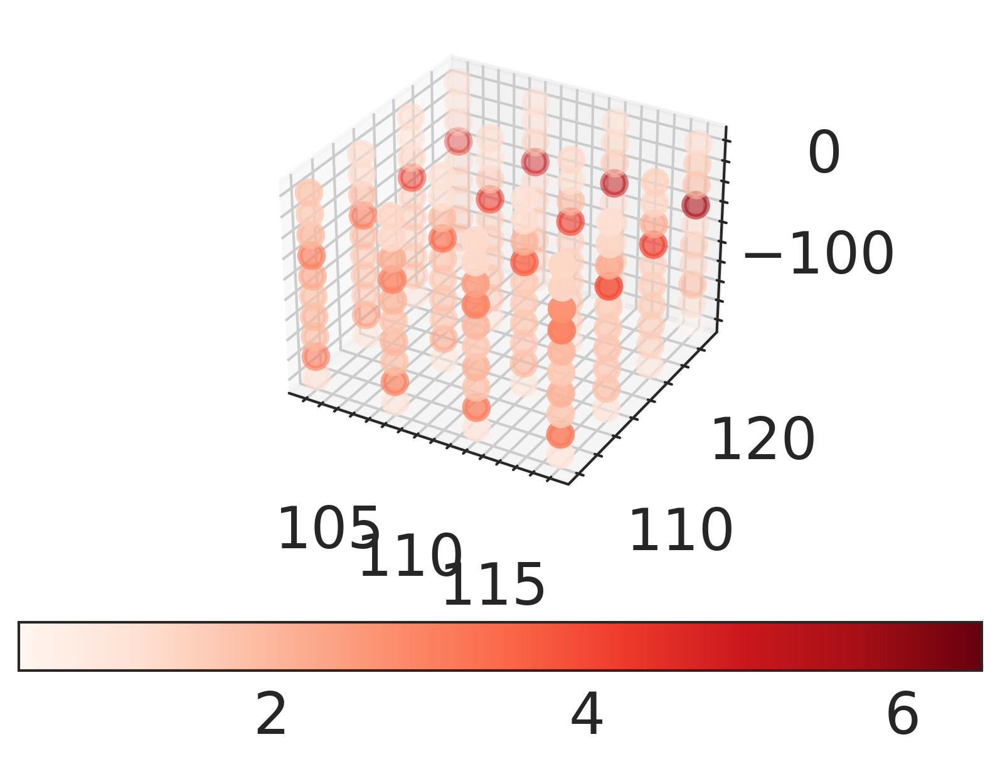

In [768]:
morton_large_c5 = pd.read_csv("../morton-large-control5.csv")
norm = matplotlib.colors.Normalize(vmin=0.4, vmax=6.5)
cmap = cm.Reds
m = cm.ScalarMappable(norm=norm, cmap=cmap)
cs = m.to_rgba(morton_large_c5["error"])
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(morton_large_c5["a1"], morton_large_c5["a2"], 
           morton_large_c5["d1"], c=cs)
plt.colorbar(m, orientation="horizontal")
plt.savefig("error_grid_scan_loop.pdf")
e = morton_large_c5["error"]
print(np.mean(e), np.max(e))

In [555]:
morton_large_c5["error"].sum()

290.8433361098

In [556]:
morton_large5["error"].sum()

317.5117676886

In [686]:
#  3D plots

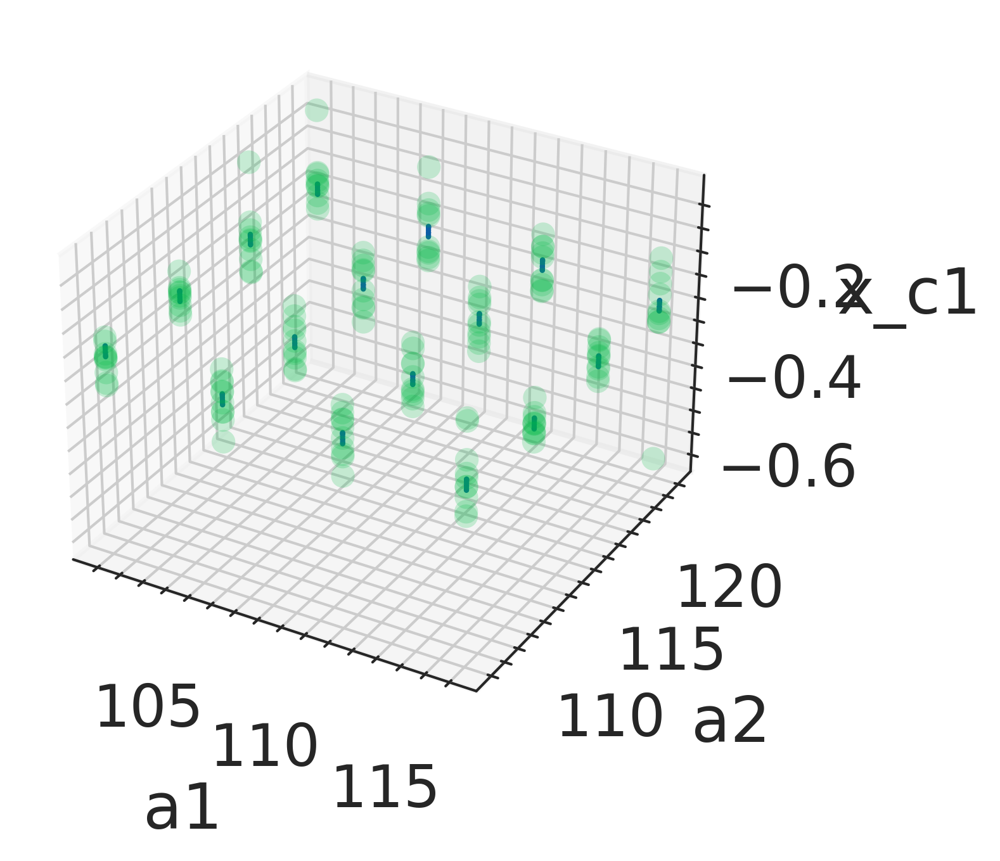

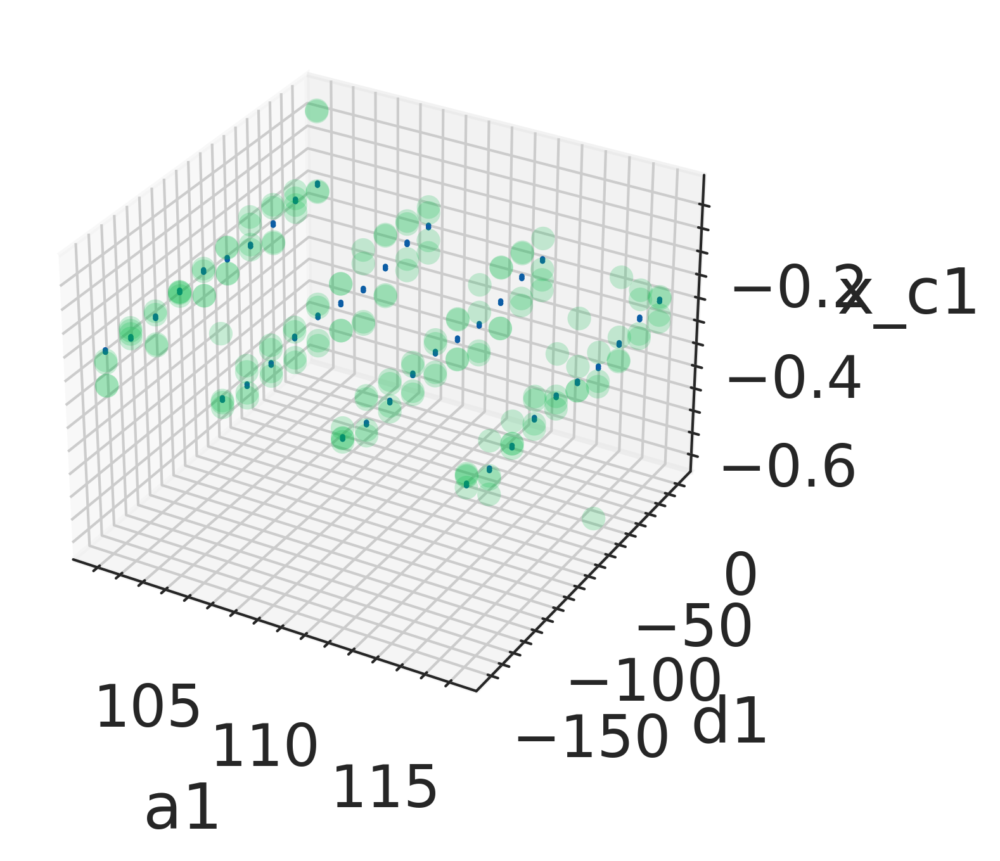

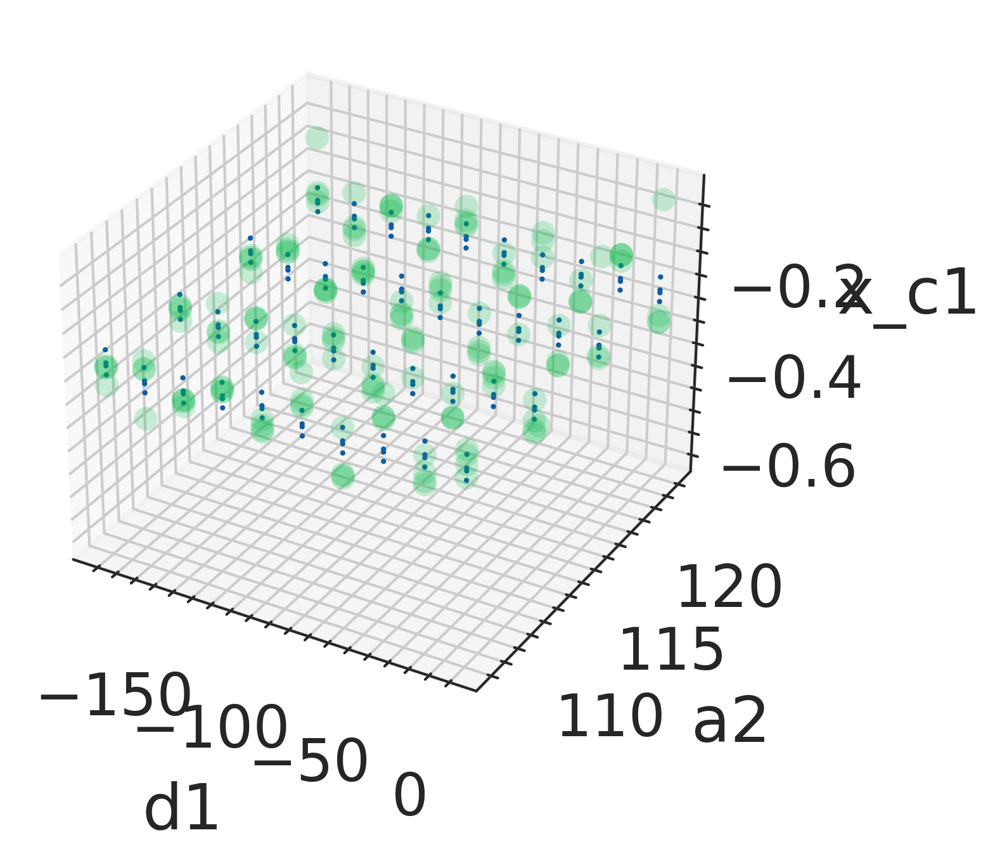

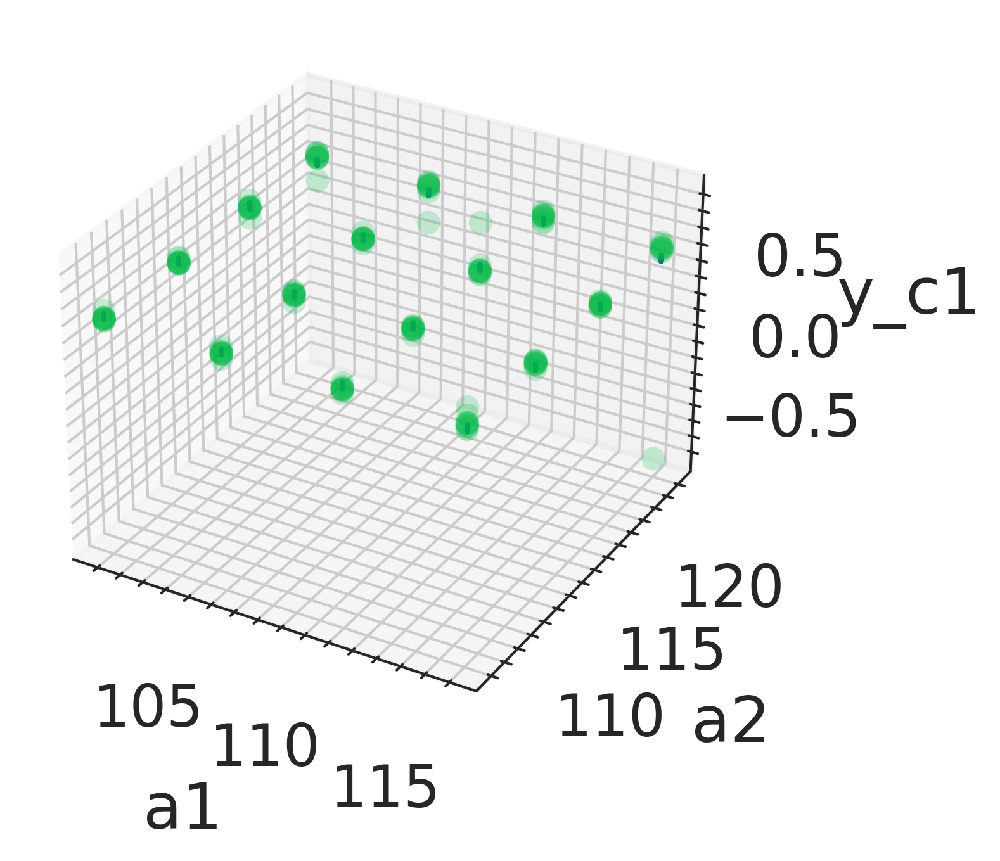

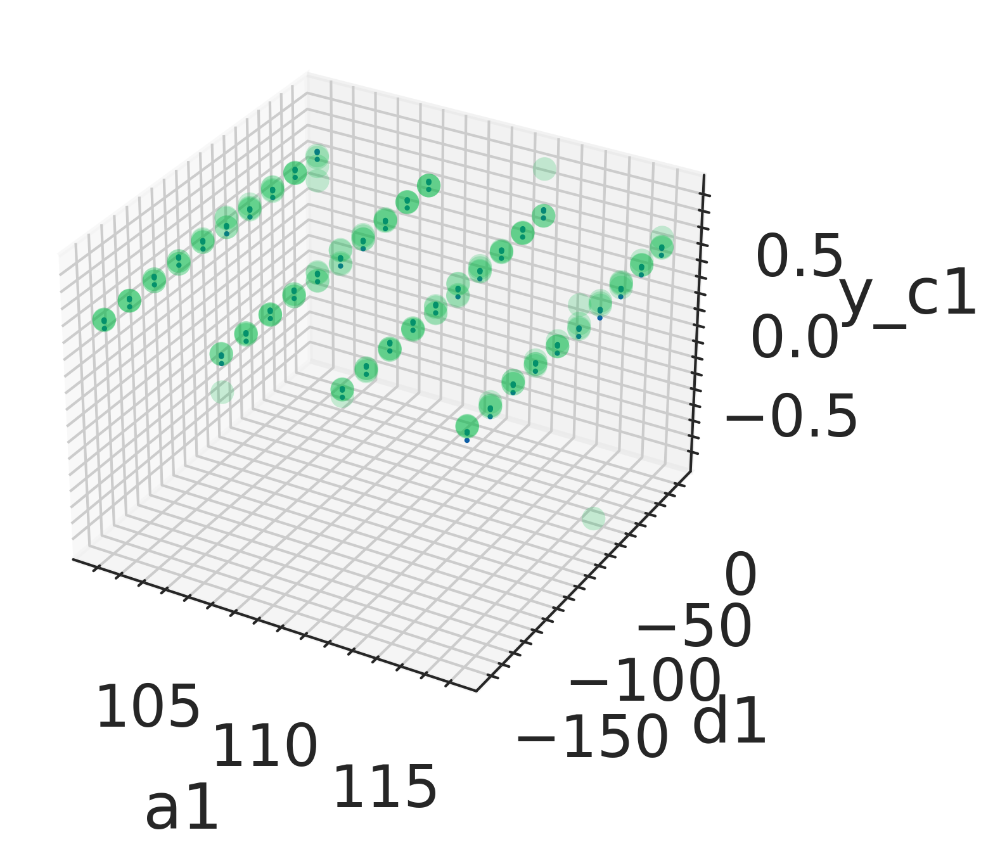

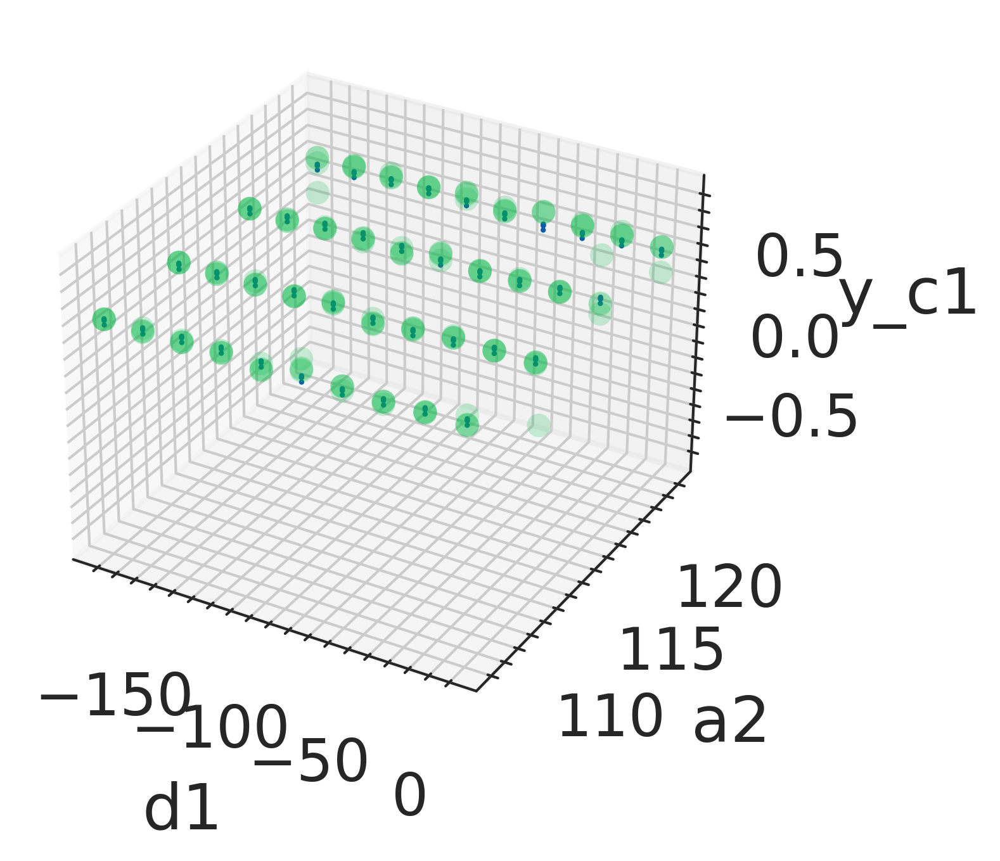

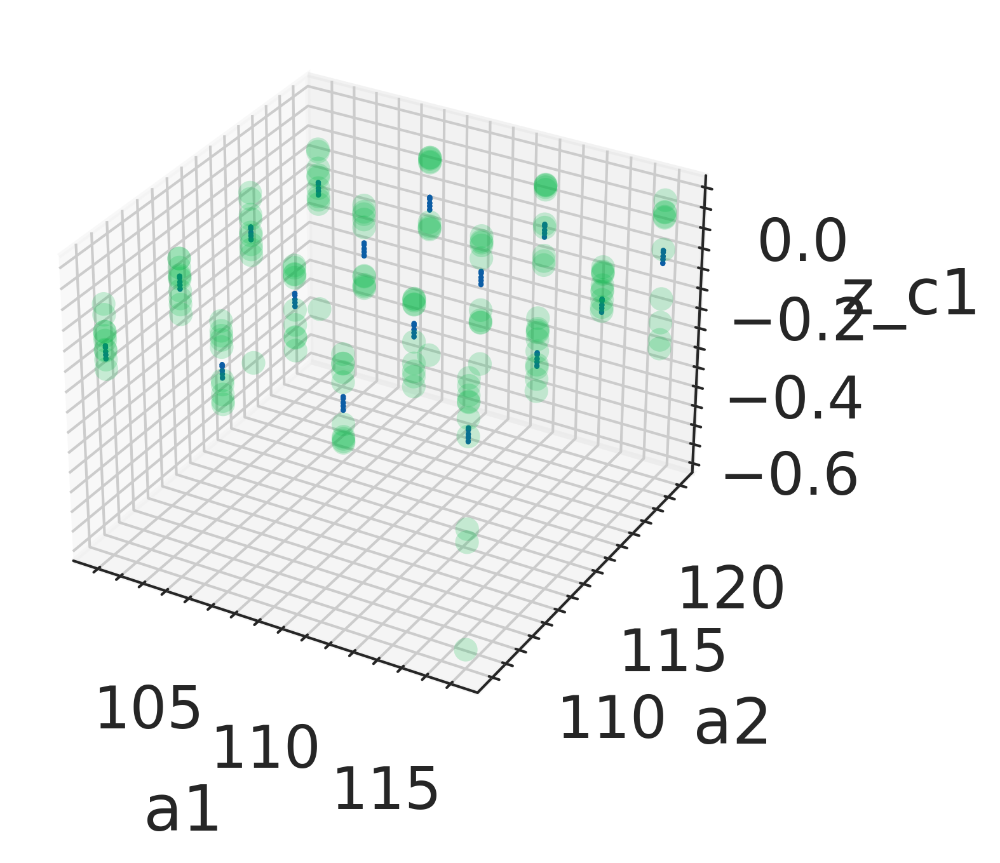

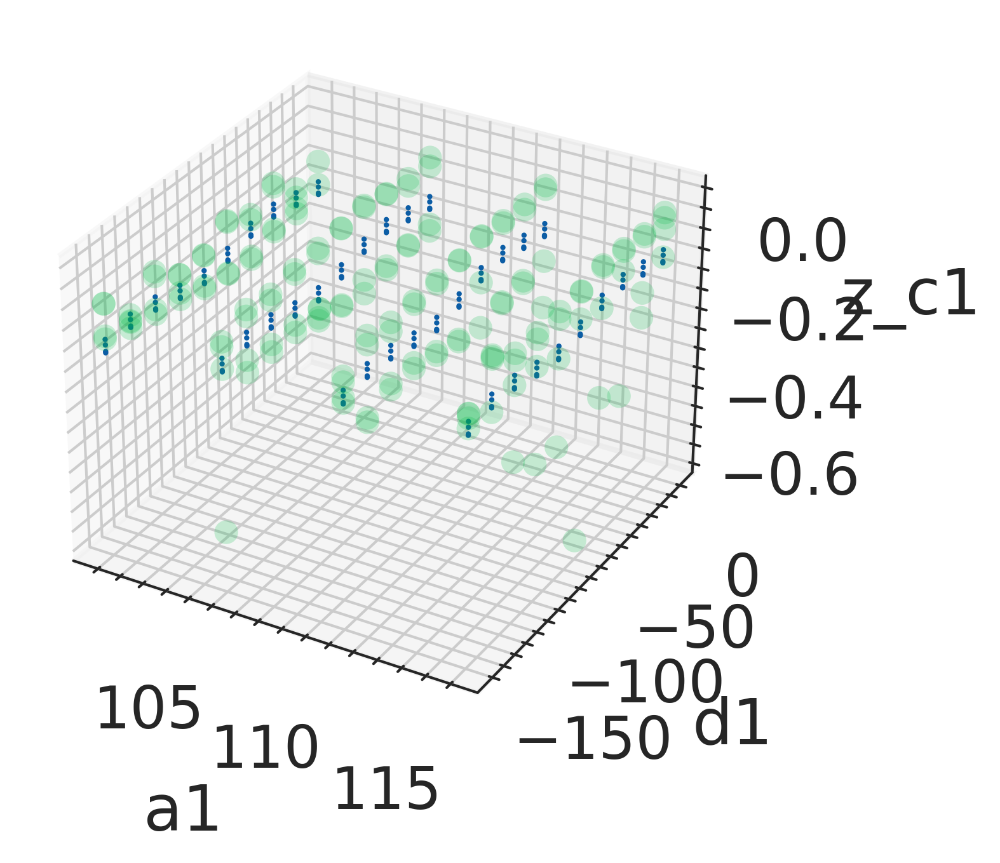

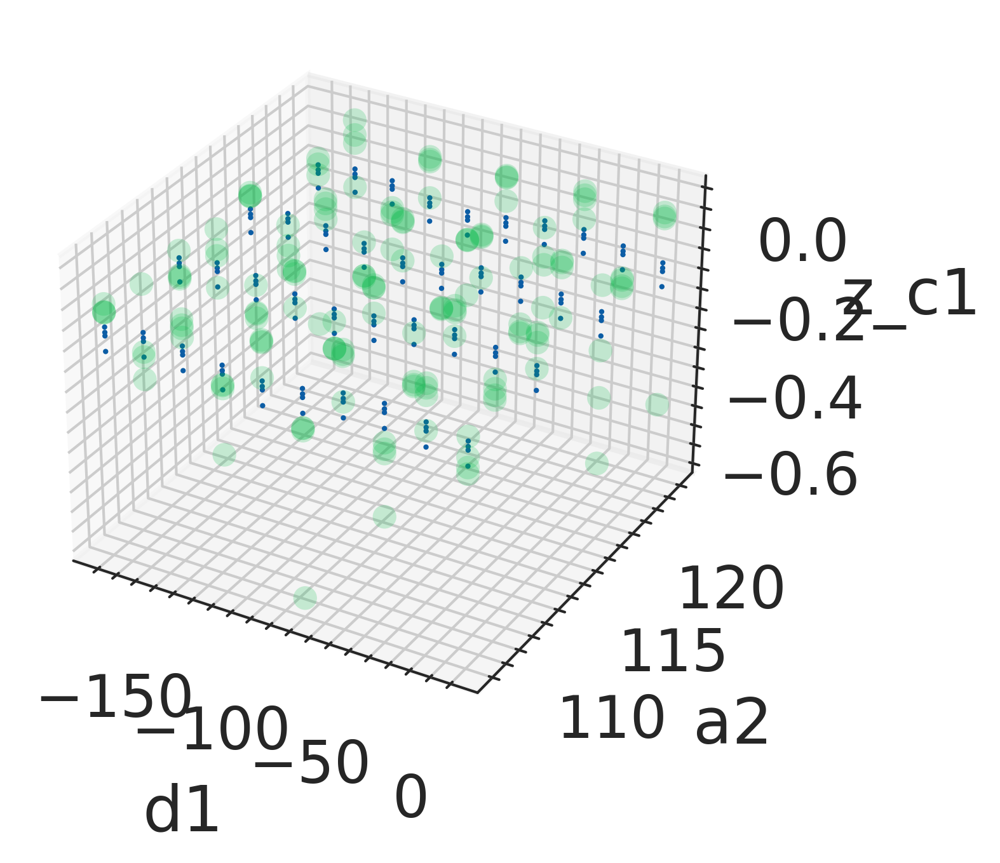

In [827]:
morton_25 = morton_fit
morton_2 = morton_large_c5
i = 1
for x in ["x", "y", "z"]:
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(morton_25["a1"], morton_25["a2"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=1, s=1)
    ax.scatter(morton_2["a1"], morton_2["a2"], morton_2[f"{x}_c{i}"], linewidth=0, alpha=0.2)
    ax.set_xlabel("a1")
    ax.set_ylabel("a2")
    ax.set_zlabel(f"{x}_c{i}")
    plt.savefig(f"{x}_c{i}_grid_scan_a1a2.pdf")
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(morton_25["a1"], morton_25["d1"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=1, s=1)
    ax.scatter(morton_2["a1"], morton_2["d1"], morton_2[f"{x}_c{i}"], linewidth=0, alpha=0.2)
    ax.set_xlabel("a1")
    ax.set_ylabel("d1")
    ax.set_zlabel(f"{x}_c{i}")
    plt.savefig(f"{x}_c{i}_grid_scan_a1d1.pdf")
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(morton_25["d1"], morton_25["a2"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=1, s=1)
    ax.scatter(morton_2["d1"], morton_2["a2"], morton_2[f"{x}_c{i}"], linewidth=0, alpha=0.2)
    ax.set_xlabel("d1")
    ax.set_ylabel("a2")
    ax.set_zlabel(f"{x}_c{i}")
    plt.savefig(f"{x}_c{i}_grid_scan_d1a2.pdf")


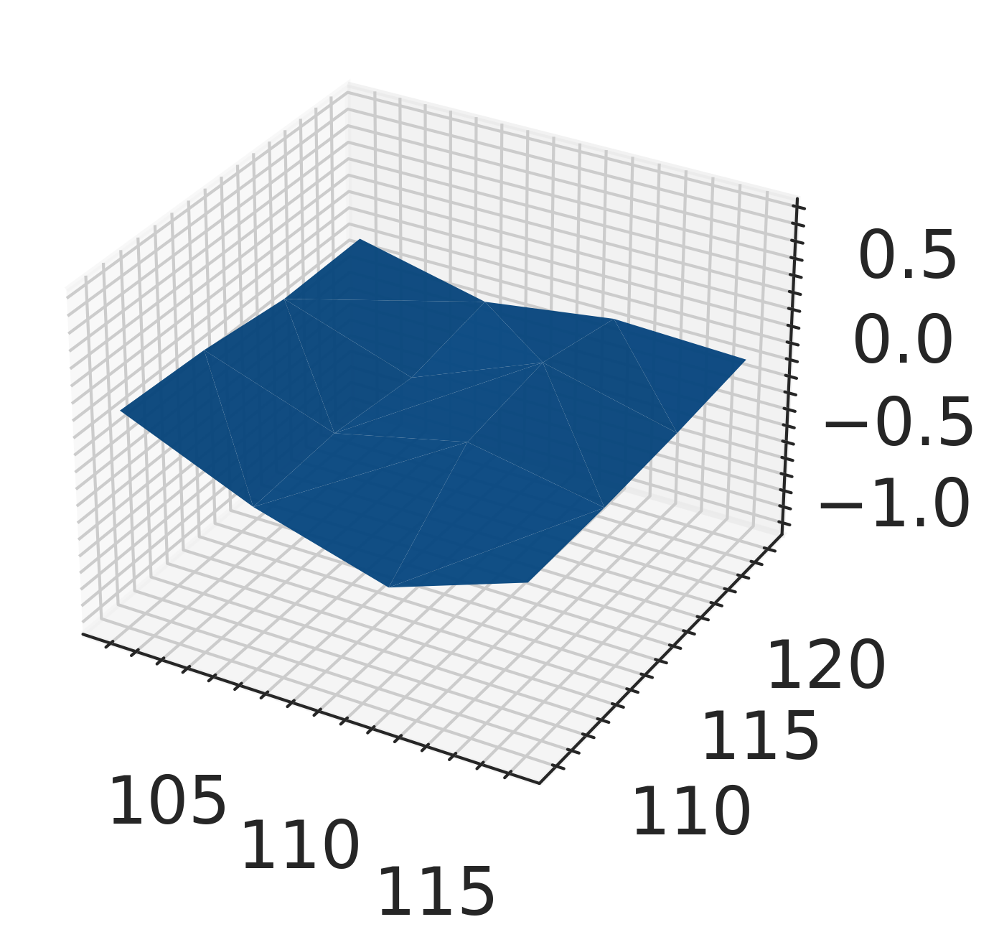

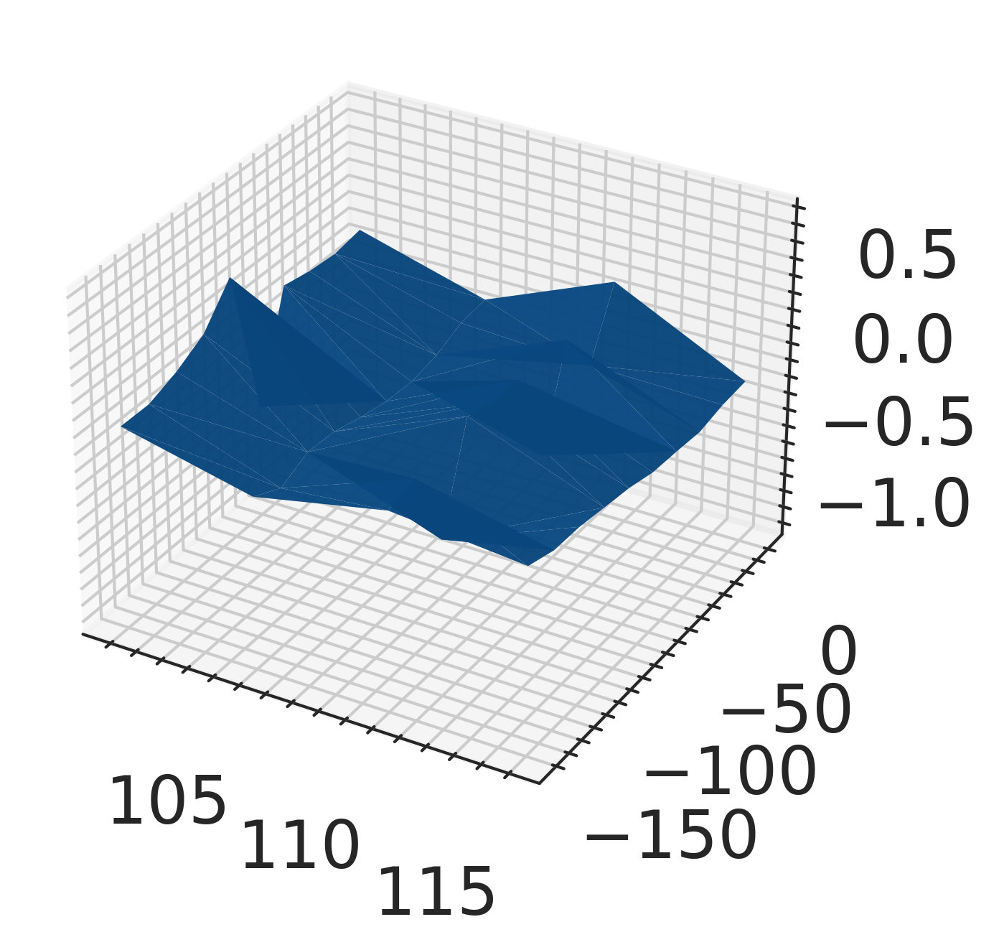

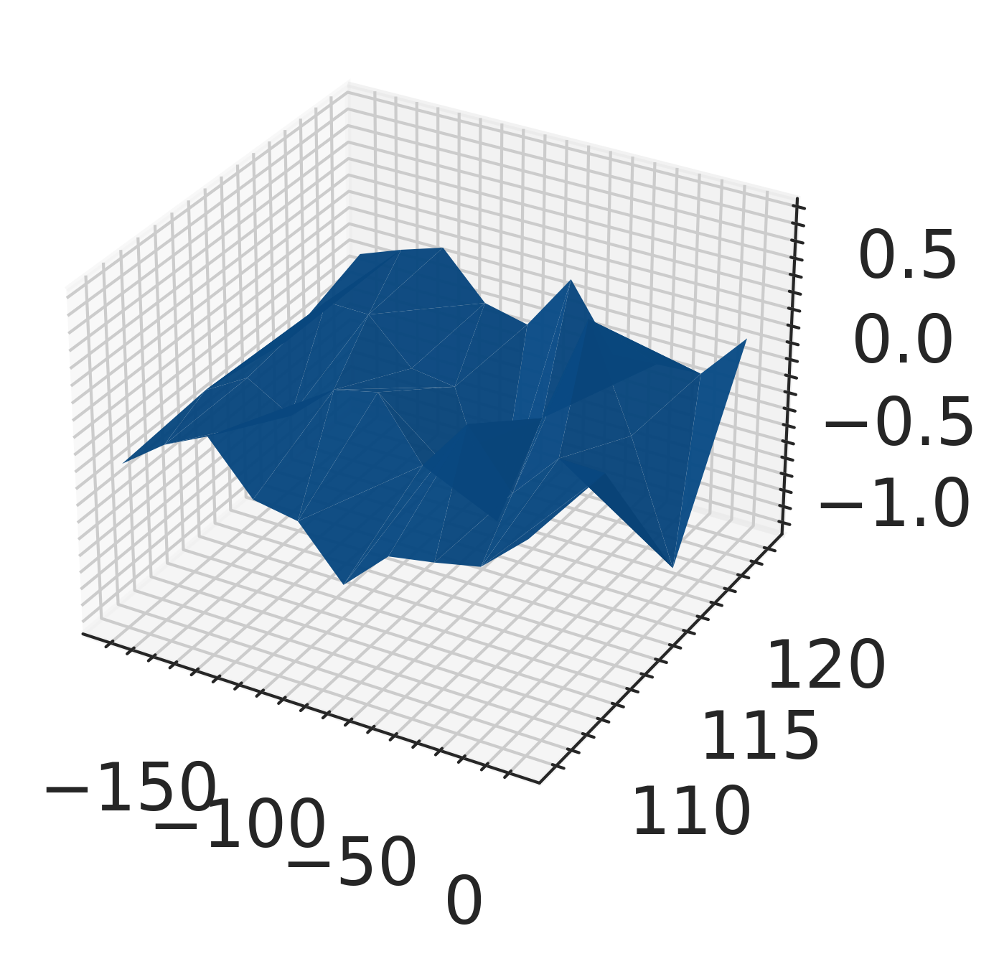

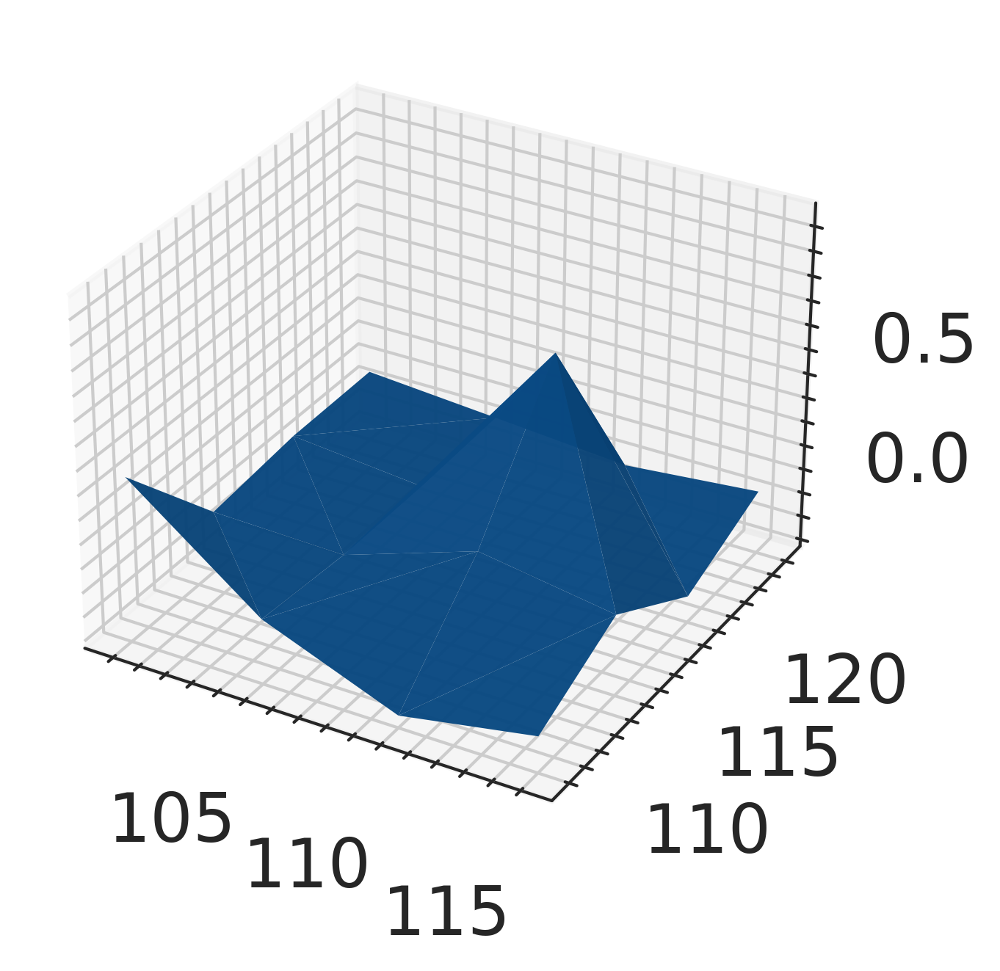

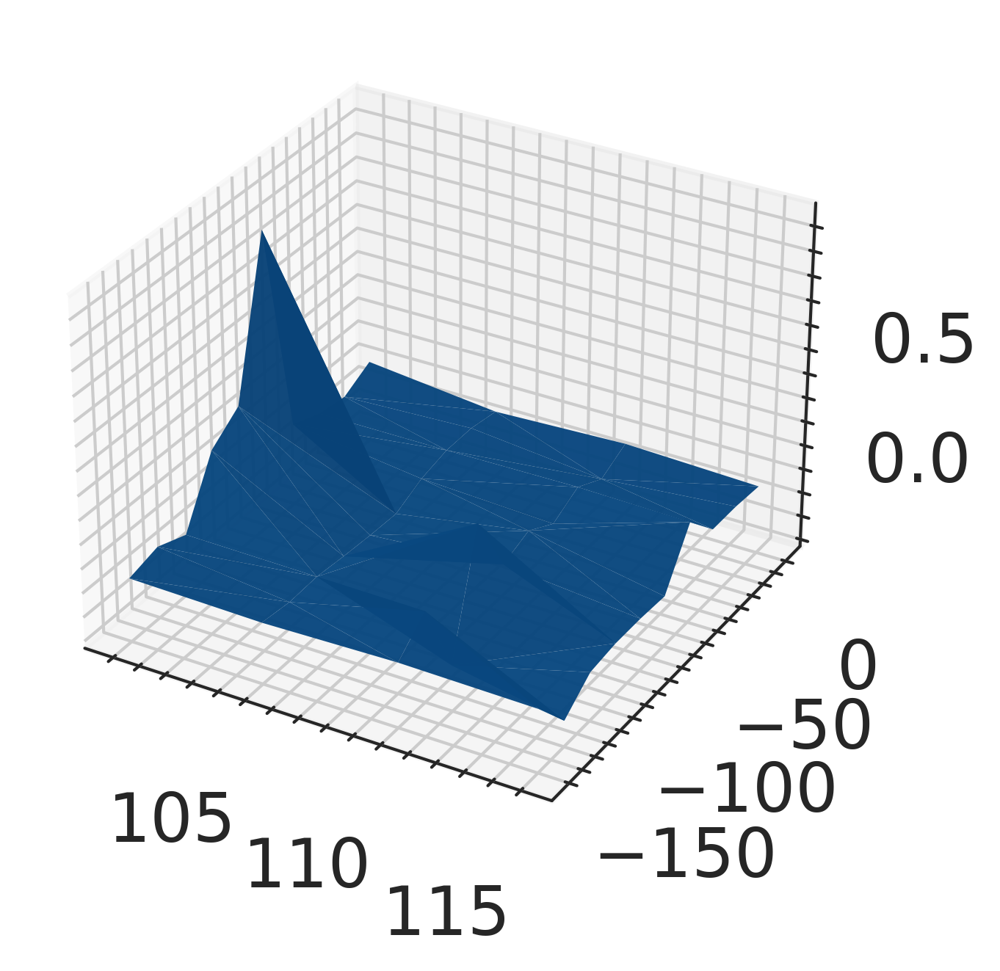

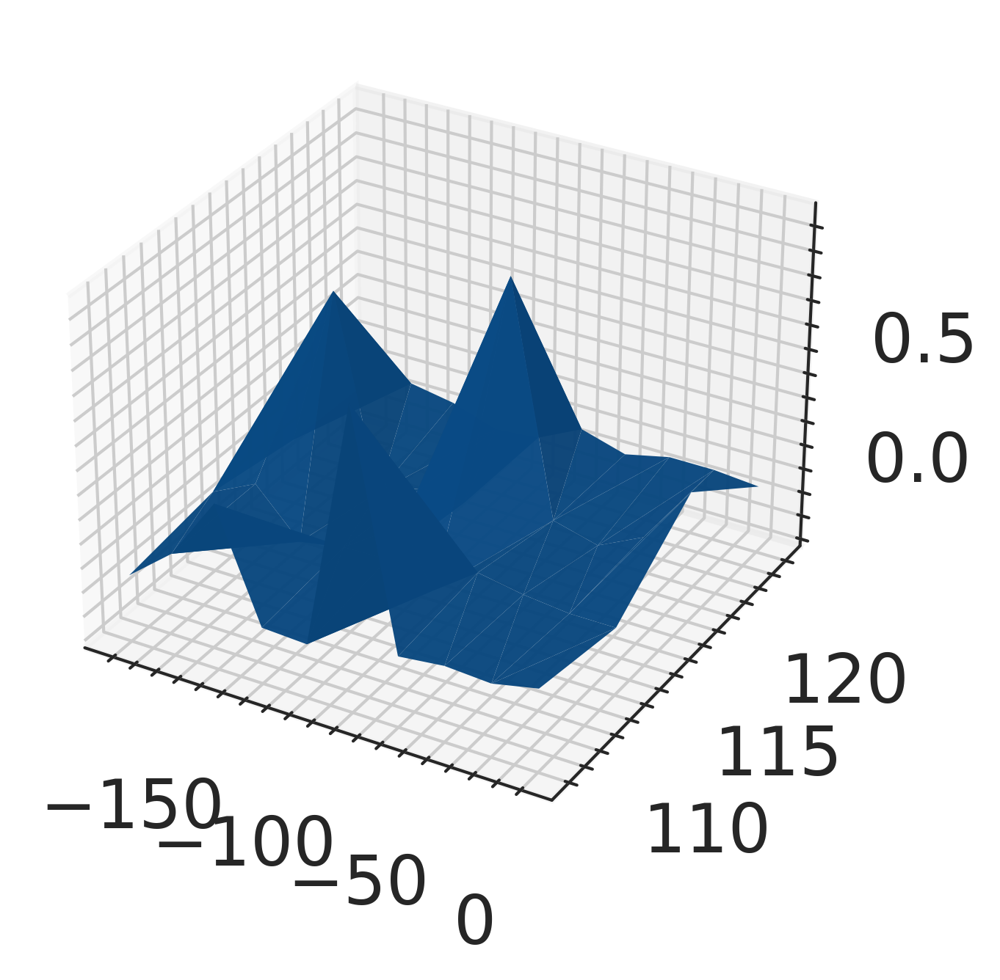

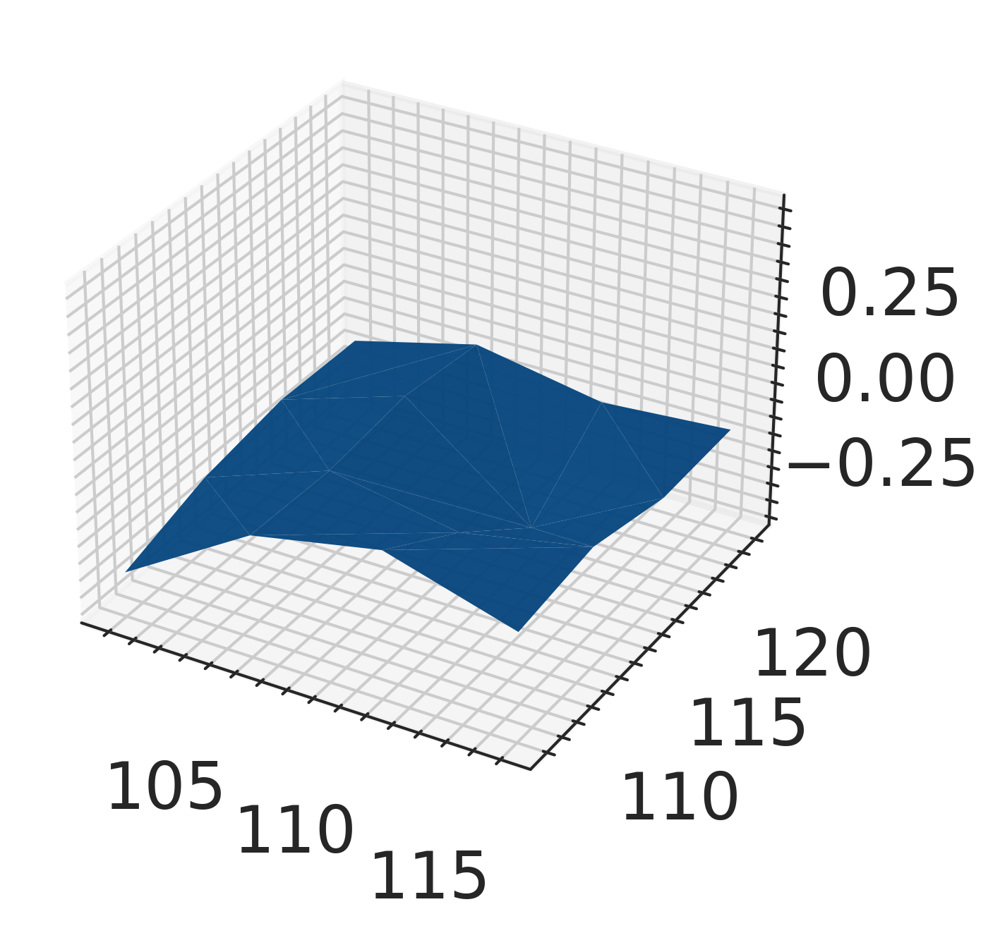

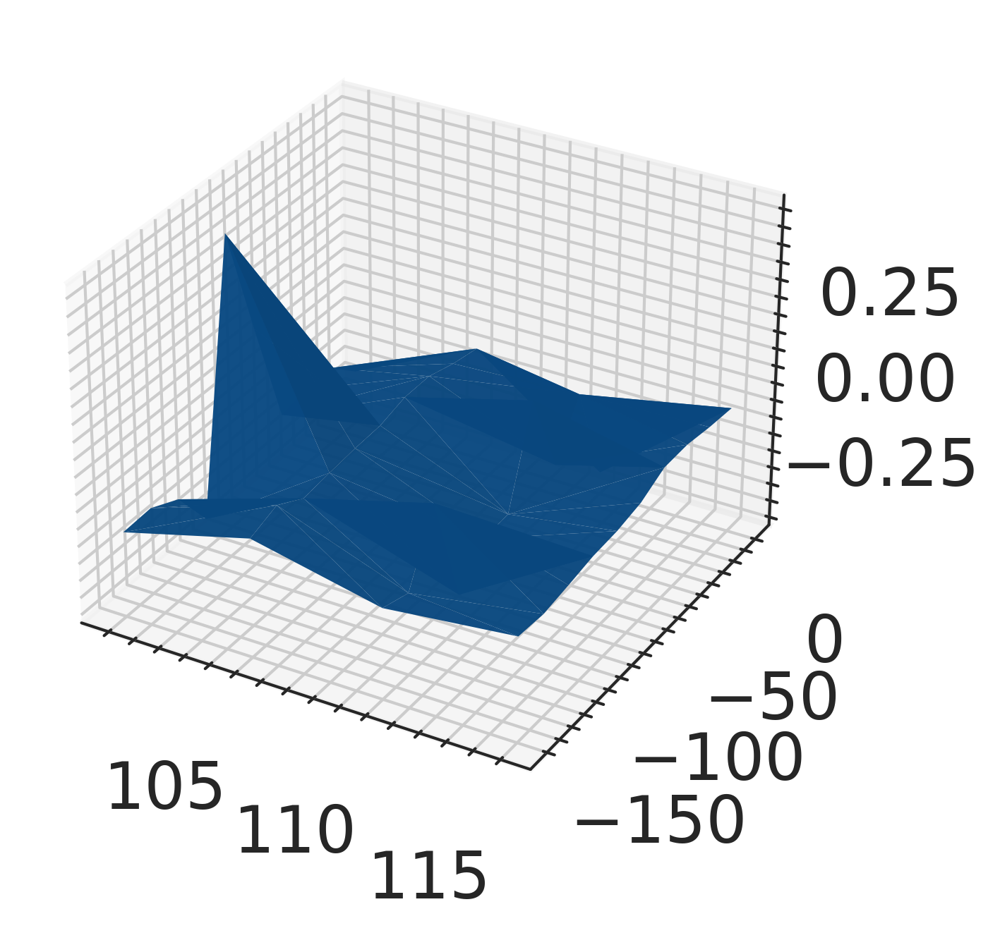

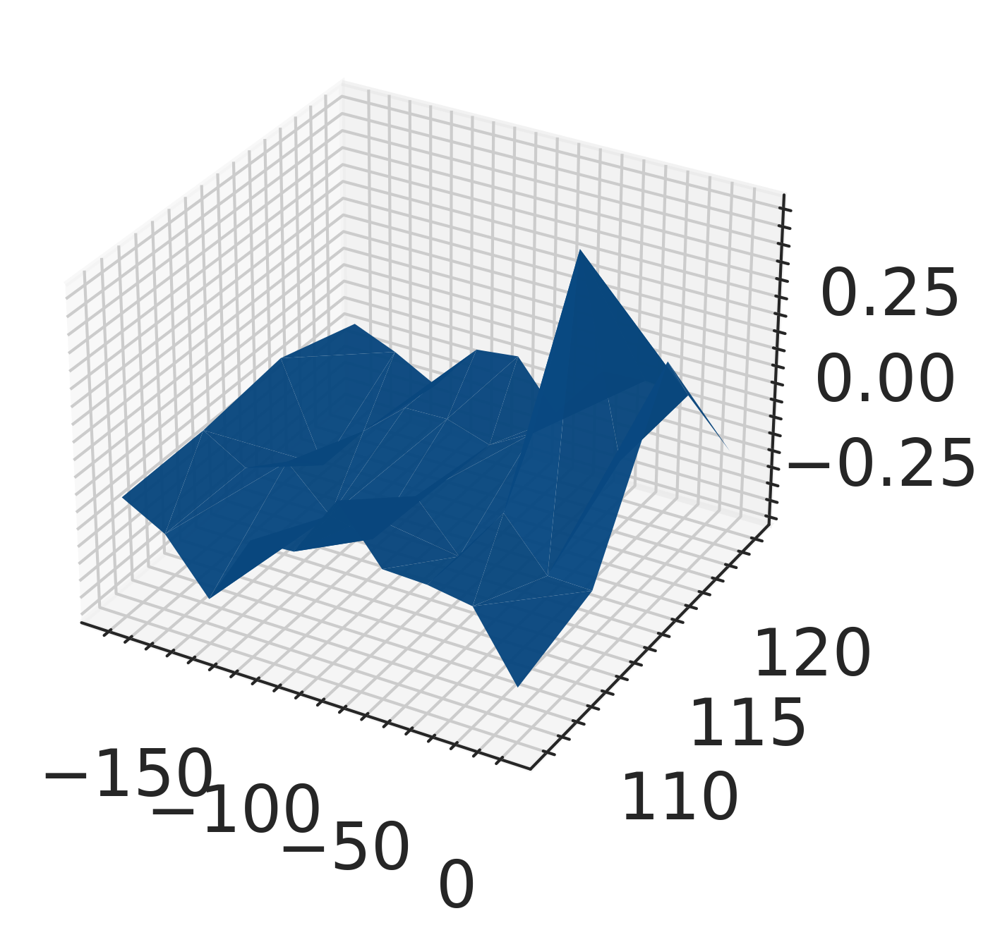

In [562]:
morton_25 = morton_large5
i = 2
for x in ["x", "y", "z"]:
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_trisurf(morton_25["a1"], morton_25["a2"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=0.97)
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_trisurf(morton_25["a1"], morton_25["d1"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=0.97)
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_trisurf(morton_25["d1"], morton_25["a2"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=0.97)


<AxesSubplot:xlabel='Unnamed: 0'>

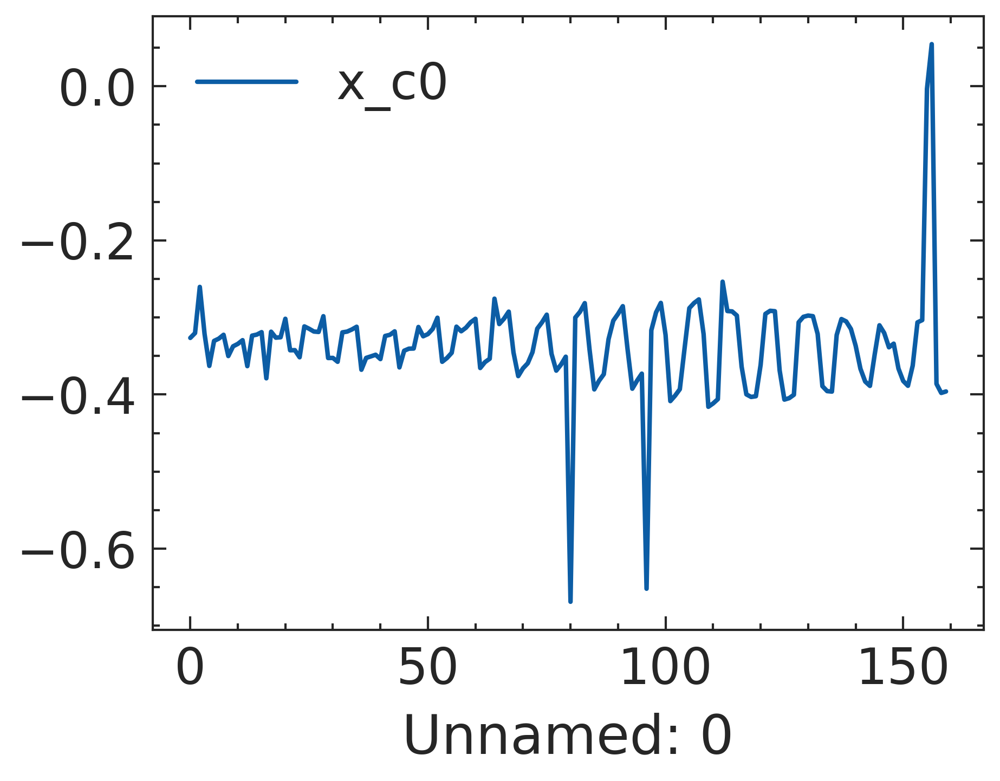

In [831]:
# morton_large_c5.plot("d1", "x_c0", kind="scatter")
# plt.show()
# morton_large_c5.plot("d1", "x_c1", kind="scatter")
morton_large_c5.plot("Unnamed: 0", "x_c0")

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


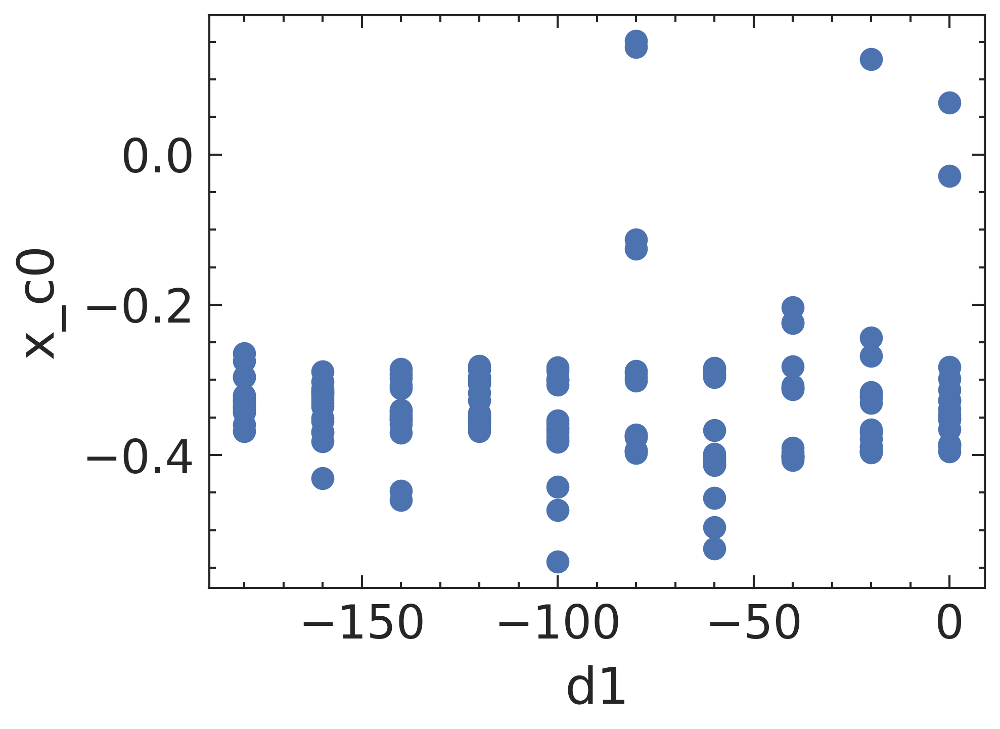

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:xlabel='d1', ylabel='x_c1'>

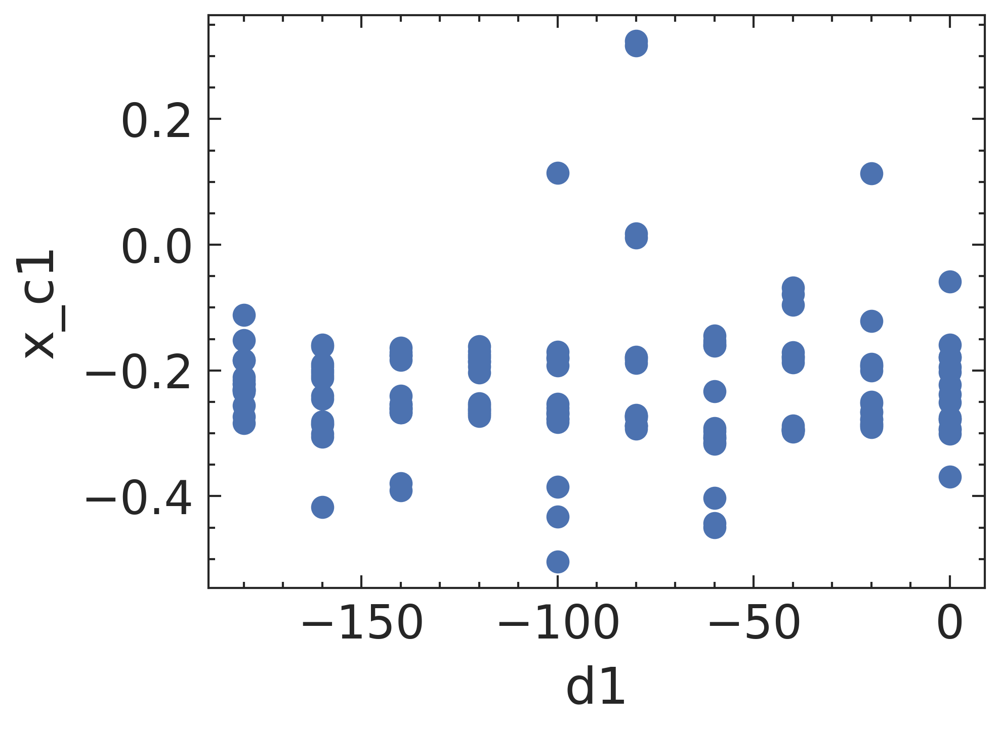

In [575]:
morton_large5.plot("", "x_c0", kind="scatter")
plt.show()
morton_large5.plot("d1", "x_c1", kind="scatter")

In [793]:
cleaned_c5 = morton_large_c5.drop(["Unnamed: 0", "frame", "error"], axis=1)
cleaned_m5 = morton_large5.drop(["Unnamed: 0", "frame", "error"], axis=1)
# cleaned_c5 = cleaned_c5.to_numpy()
avg = (cleaned_c5 + cleaned_m5)/2
avg

,a1,a2,d1,x_c0,x_c1,x_c2,x_c3,x_c4,x_c5,x_c6,...,q_c17,q_c18,q_c19,q_c20,q_c21,q_c22,q_c23,a1_,a2_,d1_
0,116.0,121.0,-180.0,-0.326524,-0.231310,-0.164395,-0.123453,-0.072356,-0.103072,-0.077219,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,3.0,3.0,0.0
1,111.0,121.0,-180.0,-0.320250,-0.210315,-0.136447,-0.088135,-0.144056,-0.156991,-0.010186,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,2.0,3.0,0.0
2,108.5,118.5,-170.0,-0.281226,-0.124186,-0.004826,0.070502,-0.725025,-0.062639,0.783477,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,1.5,2.5,0.5
3,108.5,118.5,-180.0,-0.293002,-0.164001,-0.134946,-0.084633,-0.456935,0.147341,0.355397,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,1.5,2.5,0.0
4,108.5,116.0,-170.0,-0.356926,-0.276189,-0.232614,-0.205439,0.069082,0.008690,-0.175645,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,1.5,2.0,0.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,108.5,118.5,-10.0,-0.200006,-0.161057,-0.662060,-0.737868,0.309918,-0.074398,0.449211,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,1.5,2.5,8.5
156,106.0,118.5,0.0,0.013198,-0.199090,-0.959586,-1.066172,0.323955,-0.103359,0.632162,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,1.0,2.5,9.0
157,111.0,118.5,0.0,-0.368332,-0.289330,-0.712497,-0.751299,0.053000,-0.006855,0.155463,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,2.0,2.5,9.0
158,111.0,121.0,0.0,-0.371874,-0.293258,-0.741304,-0.783188,0.058053,-0.003628,0.151333,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,2.0,3.0,9.0


In [598]:
# avg.plot("a1", "x_c0", kind="scatter")
# plt.show()
# avg.plot("a1", "x_c1", kind="scatter")

In [596]:
# morton_25 = avg
# i = 2
# for x in ["x", "y", "z"]:
#     fig = plt.figure()
#     ax = fig.add_subplot(111, projection='3d')
#     ax.plot_trisurf(morton_25["a1"], morton_25["a2"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=0.97)
#     fig = plt.figure()
#     ax = fig.add_subplot(111, projection='3d')
#     ax.plot_trisurf(morton_25["a1"], morton_25["d1"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=0.97)
#     fig = plt.figure()
#     ax = fig.add_subplot(111, projection='3d')
#     ax.plot_trisurf(morton_25["d1"], morton_25["a2"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=0.97)


In [599]:
morton_large_c5

,Unnamed: 0,frame,error,a1,a2,d1,x_c0,x_c1,x_c2,x_c3,...,q_c14,q_c15,q_c16,q_c17,q_c18,q_c19,q_c20,q_c21,q_c22,q_c23
0,0,0,0.406585,116.0,121.0,-180.0,-0.326524,-0.231310,-0.164395,-0.123453,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
1,1,1,0.465095,111.0,121.0,-180.0,-0.320250,-0.210315,-0.136447,-0.088135,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
2,2,2,1.256947,106.0,121.0,-180.0,-0.260363,-0.088963,0.011396,0.091149,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
3,3,3,1.236037,101.0,121.0,-180.0,-0.321330,-0.216526,-0.072170,-0.020658,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
4,4,4,1.202477,101.0,116.0,-180.0,-0.362868,-0.271079,-0.252224,-0.223018,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,155,155,1.246197,101.0,116.0,0.0,-0.003348,-0.031483,-0.979708,-1.114712,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
156,156,156,1.165345,101.0,121.0,0.0,0.054677,-0.028757,-0.969355,-1.102191,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
157,157,157,1.147133,106.0,121.0,0.0,-0.386131,-0.277616,-0.311611,-0.324552,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
158,158,158,1.156728,111.0,121.0,0.0,-0.397929,-0.292031,-0.335523,-0.349499,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962


In [688]:
import numpy 
import scipy 


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:xlabel='d1', ylabel='x_c0'>

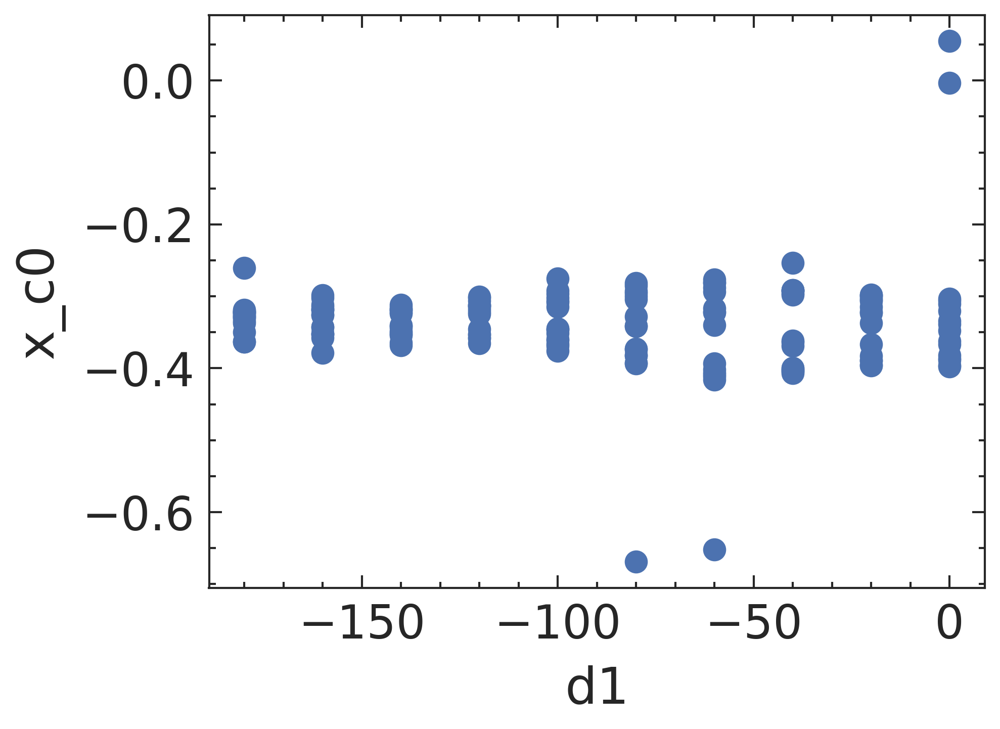

In [606]:
morton_large_c5.plot("d1", "x_c0", kind="scatter")

In [826]:
import scipy.optimize as optimize
import numpy as np
import pickle 

morton_fit = morton_large_c5.copy()

def func(data, a, b,c,d,e,f,g,h,i,j):
    return a*np.sin(b*data[0]+c)+ d + e*data[1]**3 + f*data[1]**2 + g*data[1] + h*data[2]**3 + i*data[2]**2 + j*data[2]

def func2(data, a, b,c,d,g,j):
    return a*np.sin(b*data[0]+c)+ d + g*data[1]**2 + j*data[2]**2

def func3(data, a, b,c,d):
    return a*np.sin(b*data[0]+c)+ d #+ g*data[1] + j*data[2]

def fit_func(key, df):
    A = df[["d1", "a1", "a2", key]].to_numpy()
    guess = (1,1,1,1,1,1,1,1,1,1)
    params, pcov = optimize.curve_fit(func, A[:,:3].T, A[:,3], guess, maxfev=100000)
    perr = numpy.linalg.norm(A[:,3]-func(A[:,:3].T, *params))
    fits = func(A[:,:3].T, *params)
    return params, fits

def fit_func2(key, df):
    A = df[["d1", "a1", "a2", key]].to_numpy()
    guess = (1,1,1,1,1,1)
    params, pcov = optimize.curve_fit(func2, A[:,:3].T, A[:,3], guess, maxfev=100000)
    perr = numpy.linalg.norm(A[:,3]-func2(A[:,:3].T, *params))
    fits = func2(A[:,:3].T, *params)
    return params, fits

def fit_func3(key, df):
    A = df[["d1", "a1", "a2", key]].to_numpy()
    guess = (1,1,1,1)
    params, pcov = optimize.curve_fit(func3, A[:,:3].T, A[:,3], guess, maxfev=100000)
    perr = numpy.linalg.norm(A[:,3]-func3(A[:,:3].T, *params))
    fits = func3(A[:,:3].T, *params)
    return params, fits

keys = []
for i, axis in enumerate(["x", "y", "z"]):
    for c in range(24):
        keys.append(f"{axis}_c{c}")

per_charge_fit = []
for key in keys:
    params, fits = fit_func(key, morton_large_c5)
    per_charge_fit.append(params)
    morton_fit[key] = fits
    

pickeled_model = open("loop-model.pkl", "wb")
pickle.dump(per_charge_fit, pickeled_model)
morton_fit
    

,Unnamed: 0,frame,error,a1,a2,d1,x_c0,x_c1,x_c2,x_c3,...,q_c17,q_c18,q_c19,q_c20,q_c21,q_c22,q_c23,a1_,a2_,d1_
0,0,0,0.406585,116.0,121.0,-180.0,-0.360775,-0.252649,-0.197537,-0.168952,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,3,3,0
1,1,1,0.465095,111.0,121.0,-180.0,-0.336615,-0.233366,-0.192450,-0.164308,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,2,3,0
2,2,2,1.256947,106.0,121.0,-180.0,-0.334126,-0.227253,-0.157492,-0.124224,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,1,3,0
3,3,3,1.236037,101.0,121.0,-180.0,-0.299743,-0.199323,-0.134614,-0.101829,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,0,3,0
4,4,4,1.202477,101.0,116.0,-180.0,-0.295451,-0.195635,-0.205940,-0.180301,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,155,155,1.246197,101.0,116.0,0.0,-0.282396,-0.189918,-0.229230,-0.222801,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,0,2,9
156,156,156,1.165345,101.0,121.0,0.0,-0.286689,-0.193605,-0.157905,-0.144329,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,0,3,9
157,157,157,1.147133,106.0,121.0,0.0,-0.321071,-0.221535,-0.180782,-0.166724,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,1,3,9
158,158,158,1.156728,111.0,121.0,0.0,-0.323560,-0.227649,-0.215741,-0.206807,...,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,2,3,9


In [813]:
keys

['x_c0',
 'x_c1',
 'x_c2',
 'x_c3',
 'x_c4',
 'x_c5',
 'x_c6',
 'x_c7',
 'x_c8',
 'x_c9',
 'x_c10',
 'x_c11',
 'x_c12',
 'x_c13',
 'x_c14',
 'x_c15',
 'x_c16',
 'x_c17',
 'x_c18',
 'x_c19',
 'x_c20',
 'x_c21',
 'x_c22',
 'x_c23',
 'y_c0',
 'y_c1',
 'y_c2',
 'y_c3',
 'y_c4',
 'y_c5',
 'y_c6',
 'y_c7',
 'y_c8',
 'y_c9',
 'y_c10',
 'y_c11',
 'y_c12',
 'y_c13',
 'y_c14',
 'y_c15',
 'y_c16',
 'y_c17',
 'y_c18',
 'y_c19',
 'y_c20',
 'y_c21',
 'y_c22',
 'y_c23',
 'z_c0',
 'z_c1',
 'z_c2',
 'z_c3',
 'z_c4',
 'z_c5',
 'z_c6',
 'z_c7',
 'z_c8',
 'z_c9',
 'z_c10',
 'z_c11',
 'z_c12',
 'z_c13',
 'z_c14',
 'z_c15',
 'z_c16',
 'z_c17',
 'z_c18',
 'z_c19',
 'z_c20',
 'z_c21',
 'z_c22',
 'z_c23']

In [641]:
A[:,3].shape

(160,)

In [640]:
A[:,:3].T.shape

(3, 160)

['0_c0', '0_c1', '0_c2', '0_c3', '0_c4', '0_c5', '0_c6', '0_c7', '0_c8', '0_c9', '0_c10', '0_c11', '0_c12', '0_c13', '0_c14', '0_c15', '0_c16', '0_c17', '0_c18', '0_c19', '0_c20', '0_c21', '0_c22', '0_c23', '1_c0', '1_c1', '1_c2', '1_c3', '1_c4', '1_c5', '1_c6', '1_c7', '1_c8', '1_c9', '1_c10', '1_c11', '1_c12', '1_c13', '1_c14', '1_c15', '1_c16', '1_c17', '1_c18', '1_c19', '1_c20', '1_c21', '1_c22', '1_c23', '2_c0', '2_c1', '2_c2', '2_c3', '2_c4', '2_c5', '2_c6', '2_c7', '2_c8', '2_c9', '2_c10', '2_c11', '2_c12', '2_c13', '2_c14', '2_c15', '2_c16', '2_c17', '2_c18', '2_c19', '2_c20', '2_c21', '2_c22', '2_c23', '3_c0', '3_c1', '3_c2', '3_c3', '3_c4', '3_c5', '3_c6', '3_c7', '3_c8', '3_c9', '3_c10', '3_c11', '3_c12', '3_c13', '3_c14', '3_c15', '3_c16', '3_c17', '3_c18', '3_c19', '3_c20', '3_c21', '3_c22', '3_c23']


In [670]:
diff = morton_fit - morton_large_c5
diff.sum()

Unnamed: 0    0.0
frame         0.0
error         0.0
a1            0.0
a2            0.0
             ... 
q_c19         0.0
q_c20         0.0
q_c21         0.0
q_c22         0.0
q_c23         0.0
Length: 102, dtype: float64

In [689]:
morton_fit2 = morton_large5



def func(data, a, b,c,d,e,f,g,h,i,j):
    return a*np.sin(b*data[0]+c)+ d + e*data[1]**3 + f*data[1]**2 + g*data[1] + h*data[2]**3 + i*data[2]**2 + j*data[2]

def fit_func(key, df):

    A = df[["d1", "a1", "a2", key]].to_numpy()

    guess = (1,1,1,1,1,1,1,1,1,1)
    params, pcov = optimize.curve_fit(func, A[:,:3].T, A[:,3], guess, maxfev=100000)
    perr = numpy.linalg.norm(A[:,3]-func(A[:,:3].T, *params))
    fits = func(A[:,:3].T, *params)
    return params, fits

keys = []
for i, axis in enumerate(["x", "y", "z"]):
    for c in range(24):
        keys.append(f"{axis}_c{c}")

for key in keys:
    params, fits = fit_func(key, morton_large_c5)
    morton_fit2[key] = fits
    


morton_fit2

,Unnamed: 0,frame,error,a1,a2,d1,x_c0,x_c1,x_c2,x_c3,...,q_c14,q_c15,q_c16,q_c17,q_c18,q_c19,q_c20,q_c21,q_c22,q_c23
0,0,0,0.406585,116.0,121.0,-180.0,-0.360775,-0.252649,-0.197537,-0.168952,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
1,1,1,0.465095,111.0,121.0,-180.0,-0.336615,-0.233366,-0.192450,-0.164308,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
2,2,25,2.821593,111.0,116.0,-160.0,-0.334126,-0.227253,-0.157492,-0.124224,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
3,3,7,1.288991,116.0,116.0,-180.0,-0.299743,-0.199323,-0.134614,-0.101829,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
4,4,24,2.298534,116.0,116.0,-160.0,-0.295451,-0.195635,-0.205940,-0.180301,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,155,128,1.252379,116.0,121.0,-20.0,-0.282396,-0.189918,-0.229230,-0.222801,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
156,156,153,1.305266,111.0,116.0,0.0,-0.286689,-0.193605,-0.157905,-0.144329,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
157,157,152,1.275745,116.0,116.0,0.0,-0.321071,-0.221535,-0.180782,-0.166724,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962
158,158,158,1.203648,111.0,121.0,0.0,-0.323560,-0.227649,-0.215741,-0.206807,...,-0.989871,0.525095,0.276201,0.676163,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962


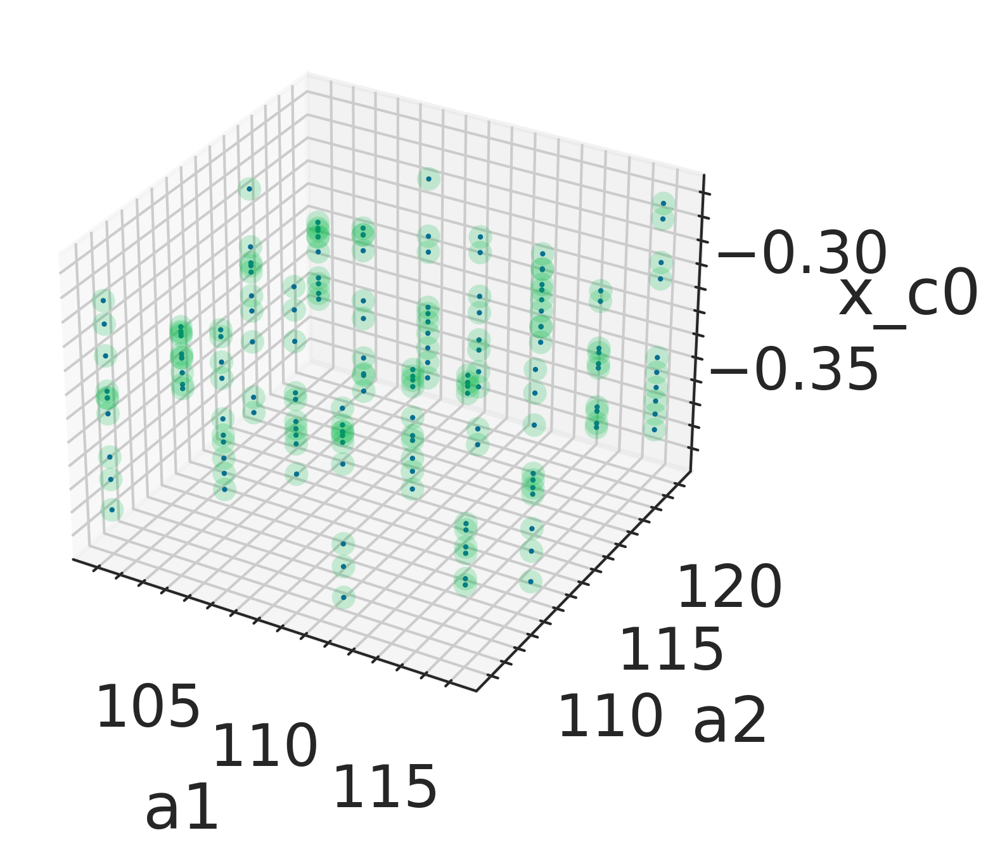

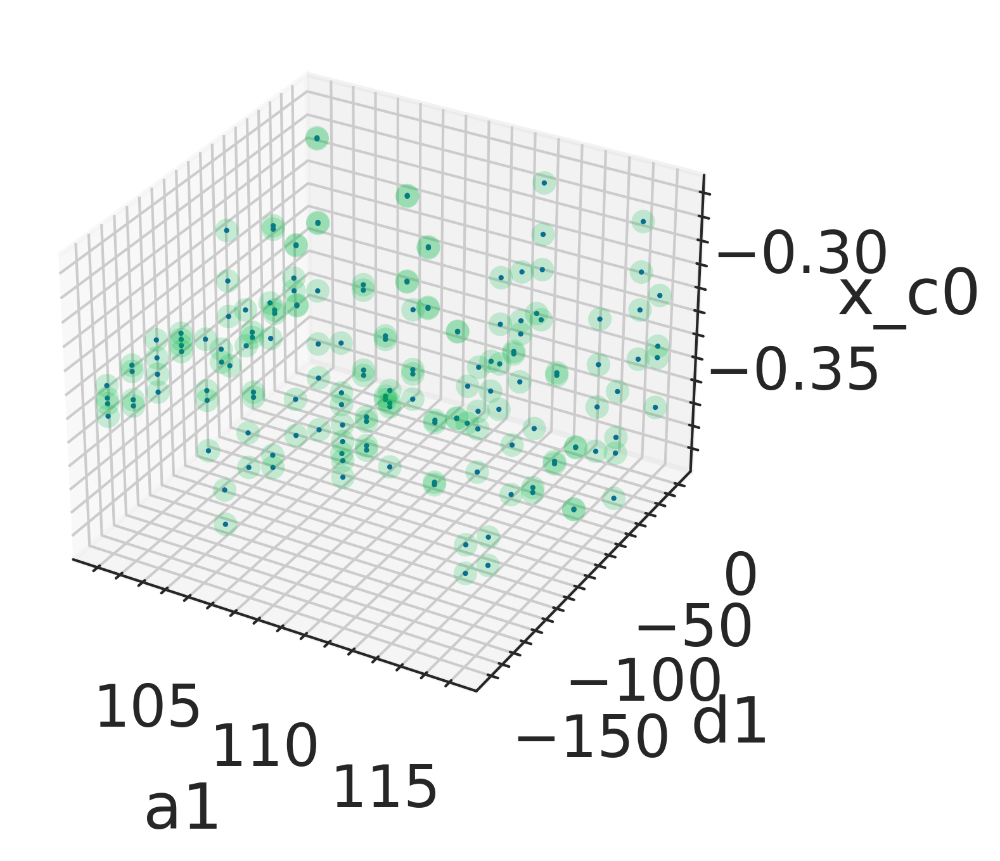

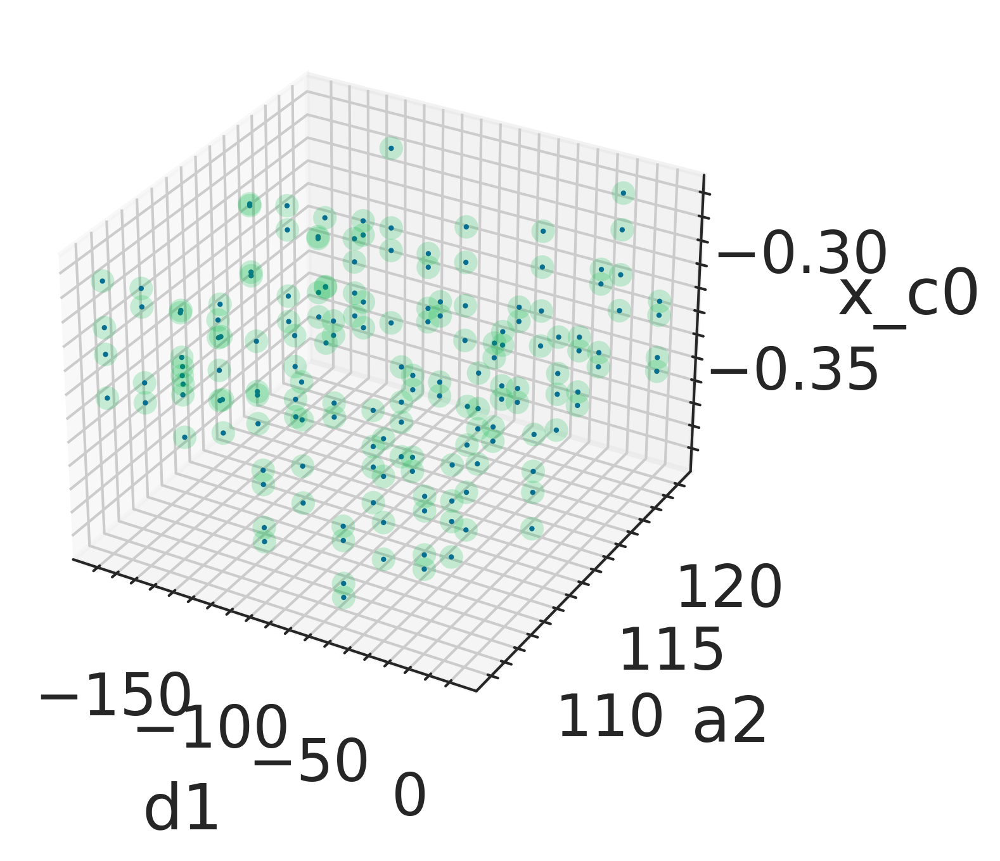

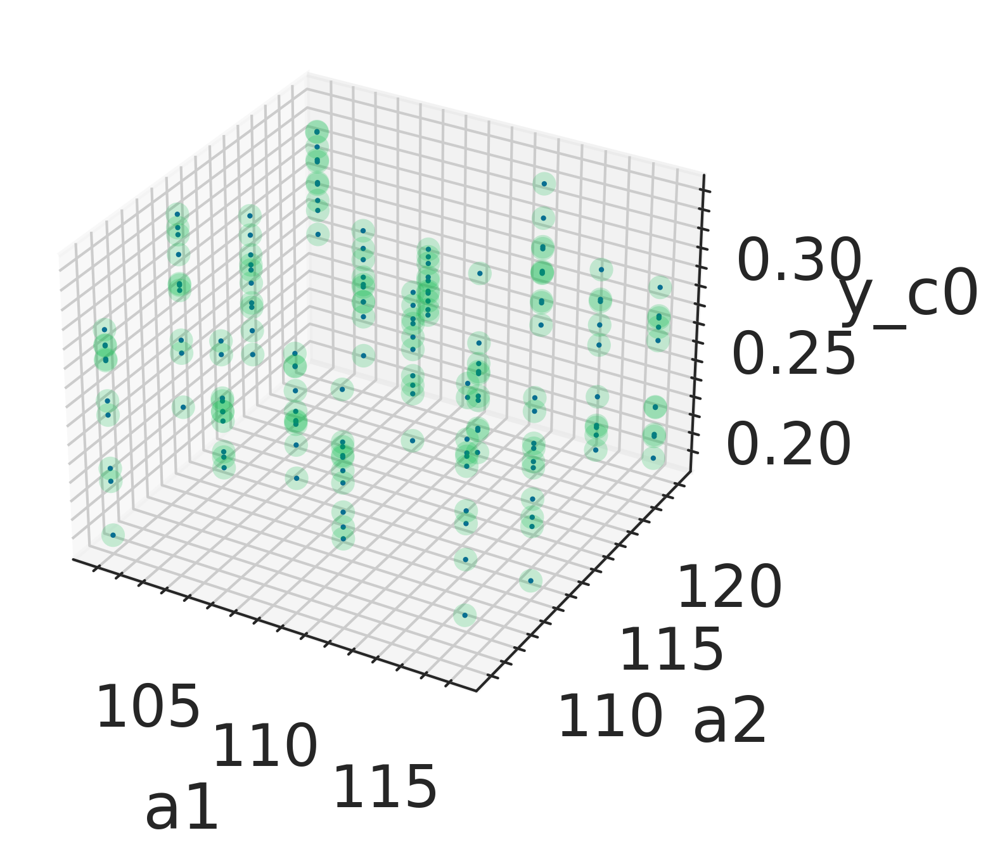

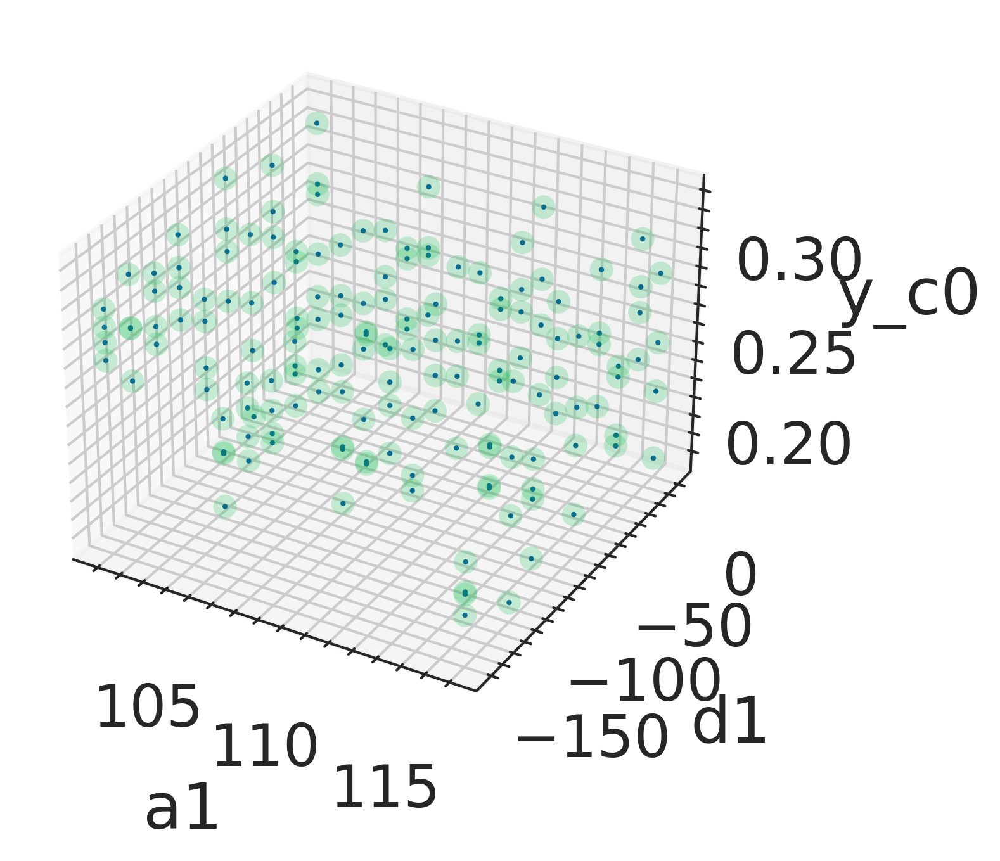

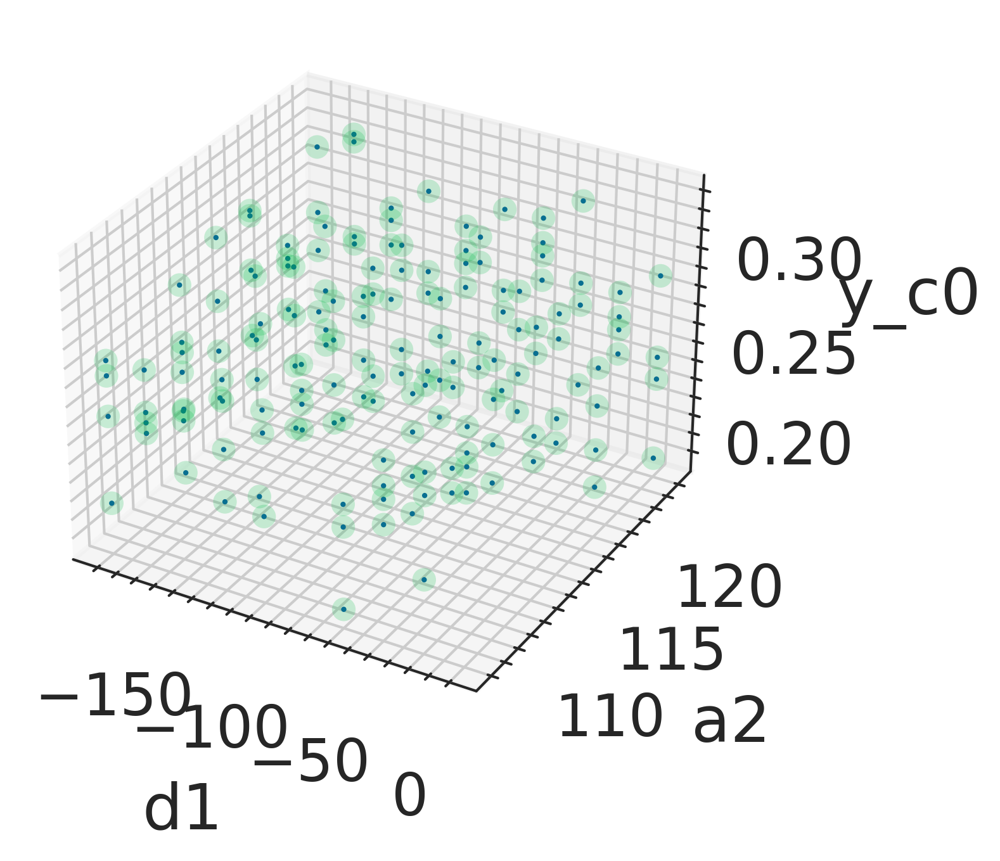

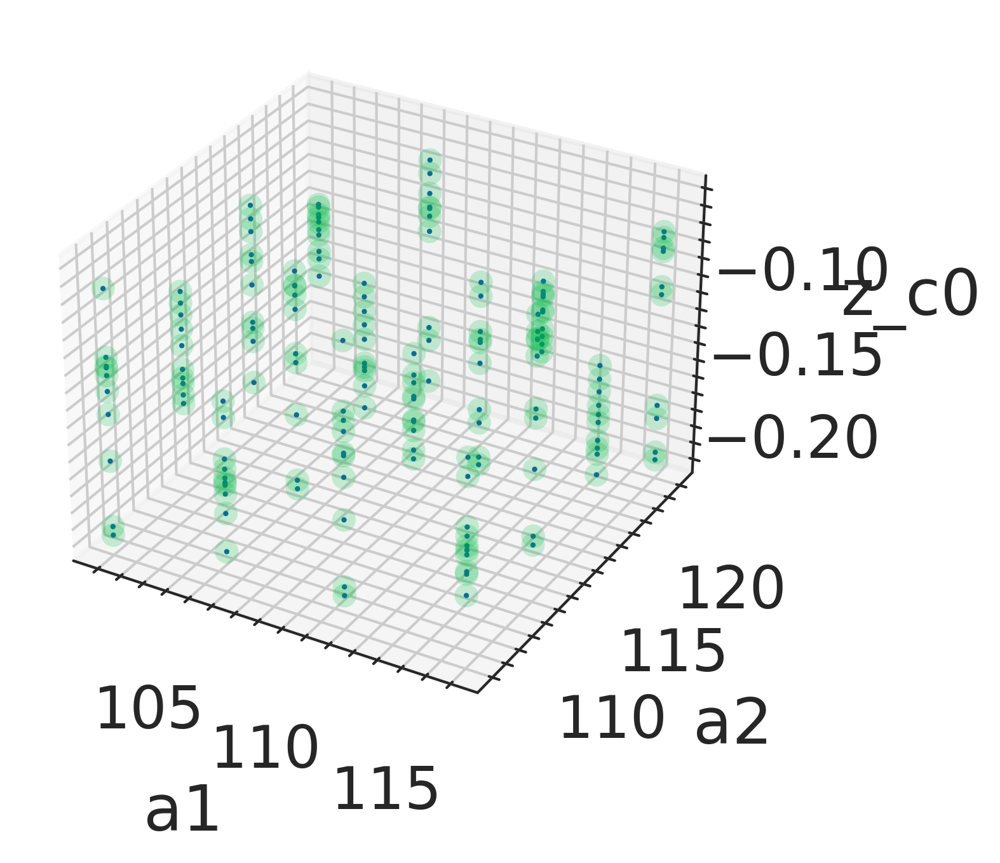

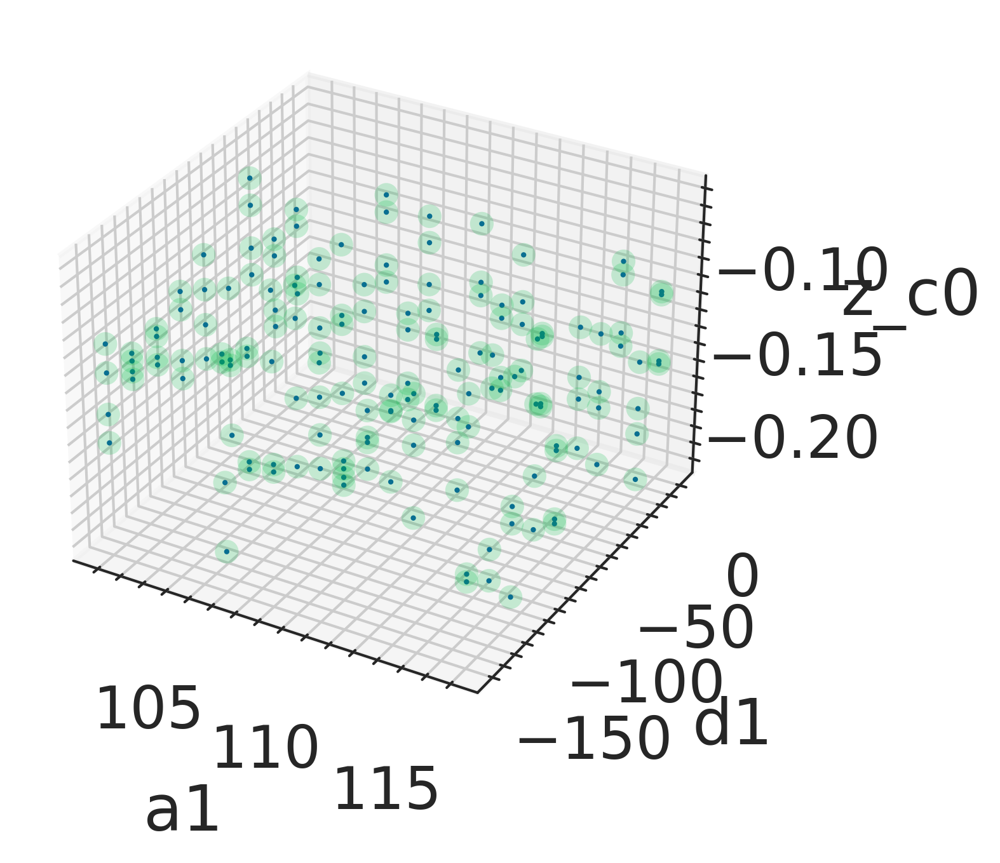

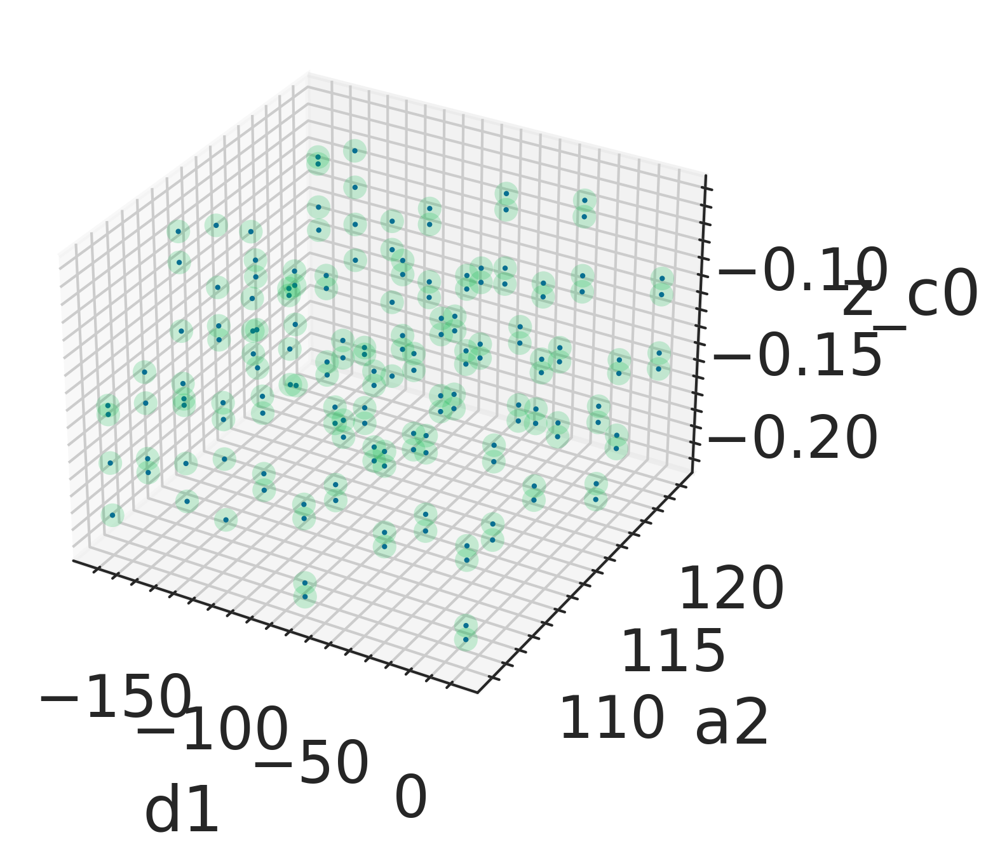

In [691]:
morton_25 = morton_fit2
morton_2 = morton_large5
i = 0
for x in ["x", "y", "z"]:
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(morton_25["a1"], morton_25["a2"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=1, s=1)
    ax.scatter(morton_2["a1"], morton_2["a2"], morton_2[f"{x}_c{i}"], linewidth=0, alpha=0.2)
    ax.set_xlabel("a1")
    ax.set_ylabel("a2")
    ax.set_zlabel(f"{x}_c{i}")
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(morton_25["a1"], morton_25["d1"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=1, s=1)
    ax.scatter(morton_2["a1"], morton_2["d1"], morton_2[f"{x}_c{i}"], linewidth=0, alpha=0.2)
    ax.set_xlabel("a1")
    ax.set_ylabel("d1")
    ax.set_zlabel(f"{x}_c{i}")
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(morton_25["d1"], morton_25["a2"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=1, s=1)
    ax.scatter(morton_2["d1"], morton_2["a2"], morton_2[f"{x}_c{i}"], linewidth=0, alpha=0.2)
    ax.set_xlabel("d1")
    ax.set_ylabel("a2")
    ax.set_zlabel(f"{x}_c{i}")


In [778]:
morton_fit3 = avg.copy()


def func(data, a, b,c,d,e,f,g,h,i,j):
    return a*np.sin(b*data[0]+c)+ d + e*data[1]**3 + f*data[1]**2 + g*data[1] + h*data[2]**3 + i*data[2]**2 + j*data[2]

def fit_func(key, df):

    A = df[["d1", "a1", "a2", key]].to_numpy()

    guess = (1,1,1,1,1,1,1,1,1,1)
    params, pcov = optimize.curve_fit(func, A[:,:3].T, A[:,3], guess, maxfev=100000)
    perr = numpy.linalg.norm(A[:,3]-func(A[:,:3].T, *params))
    fits = func(A[:,:3].T, *params)
    return params, fits

keys = []
for i, axis in enumerate(["x", "y", "z"]):
    for c in range(24):
        keys.append(f"{axis}_c{c}")

for key in keys:
    params, fits = fit_func(key, morton_large_c5)
    morton_fit3[key] = fits
    


morton_fit3

,a1,a1_,a2,a2_,d1,d1_,q_c0,q_c1,q_c10,q_c11,...,z_c21,z_c22,z_c23,z_c3,z_c4,z_c5,z_c6,z_c7,z_c8,z_c9
0,116.0,NaN,121.0,NaN,-180.0,NaN,0.43965,-0.241948,-0.580379,0.610468,...,0.093523,-0.366222,0.024966,0.012121,-0.014598,0.262522,0.299899,0.441599,-0.538108,0.065513
1,111.0,NaN,121.0,NaN,-180.0,NaN,0.43965,-0.241948,-0.580379,0.610468,...,0.110806,-0.353641,0.057498,-0.013155,-0.021048,0.252949,0.327304,0.464806,-0.551032,0.109972
2,108.5,NaN,118.5,NaN,-170.0,NaN,0.43965,-0.241948,-0.580379,0.610468,...,0.093500,-0.371133,0.065445,-0.024173,-0.028328,0.247118,0.330781,0.462520,-0.561667,0.127438
3,108.5,NaN,118.5,NaN,-180.0,NaN,0.43965,-0.241948,-0.580379,0.610468,...,0.133628,-0.326751,0.068186,-0.038903,-0.070826,0.235462,0.358087,0.475357,-0.550320,0.112086
4,108.5,NaN,116.0,NaN,-170.0,NaN,0.43965,-0.241948,-0.580379,0.610468,...,0.140585,-0.322598,0.049236,-0.026782,-0.057306,0.239806,0.385820,0.489422,-0.528566,0.120148
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,108.5,NaN,118.5,NaN,-10.0,NaN,0.43965,-0.241948,-0.580379,0.610468,...,0.179104,-0.309655,0.038355,-0.022757,-0.057026,0.239026,0.384172,0.485767,-0.502637,0.102326
156,106.0,NaN,118.5,NaN,0.0,NaN,0.43965,-0.241948,-0.580379,0.610468,...,0.172148,-0.313808,0.057304,-0.034878,-0.070546,0.234682,0.356438,0.471701,-0.524391,0.094264
157,111.0,NaN,118.5,NaN,0.0,NaN,0.43965,-0.241948,-0.580379,0.610468,...,0.132019,-0.358190,0.054563,-0.020148,-0.028048,0.246338,0.329132,0.458864,-0.535738,0.109616
158,111.0,NaN,121.0,NaN,0.0,NaN,0.43965,-0.241948,-0.580379,0.610468,...,0.149325,-0.340697,0.046617,-0.009129,-0.020768,0.252169,0.325656,0.461150,-0.525103,0.092150


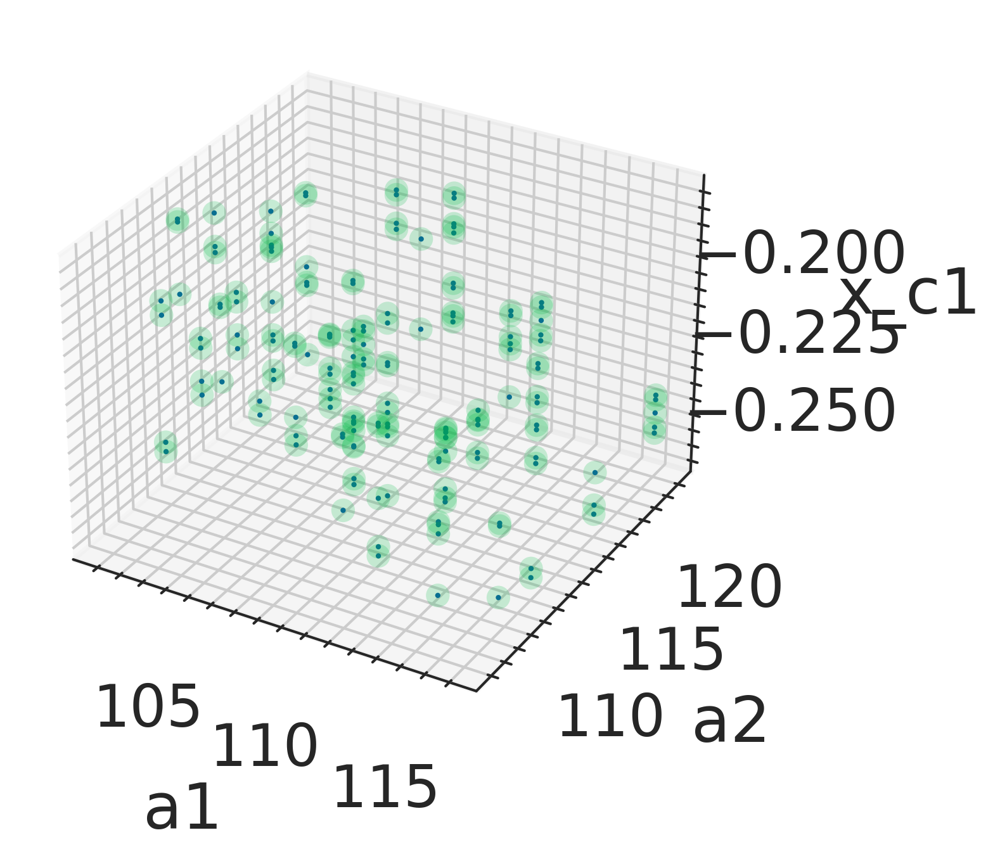

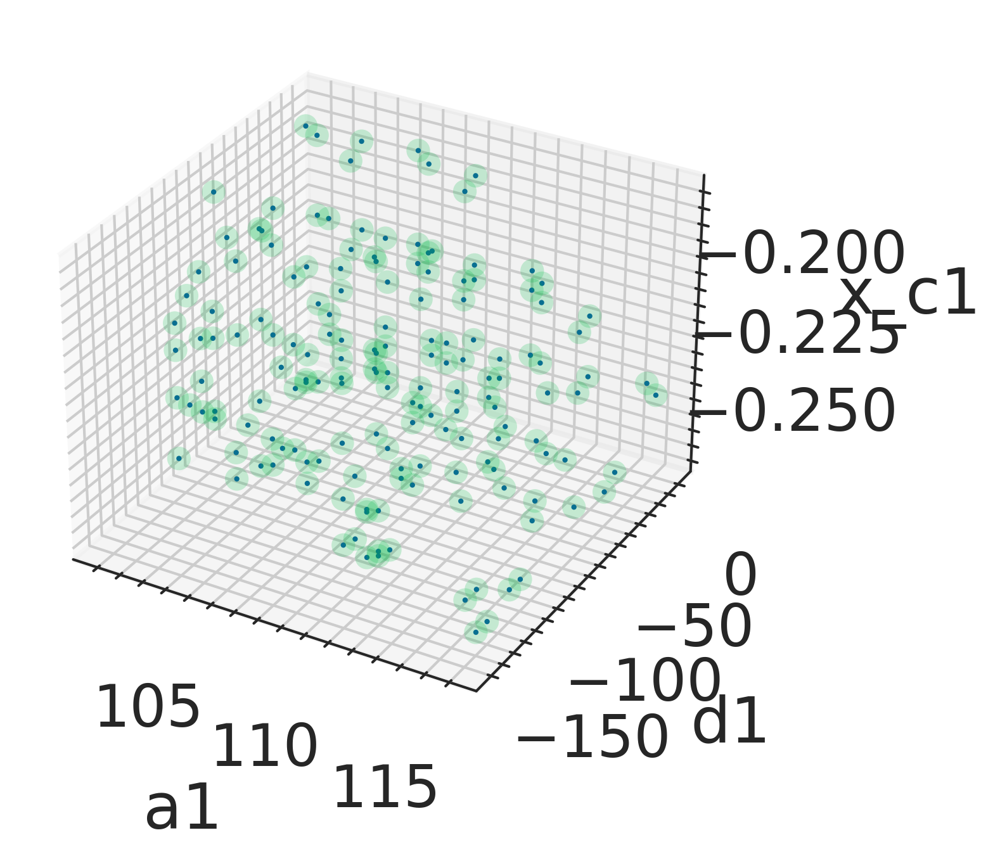

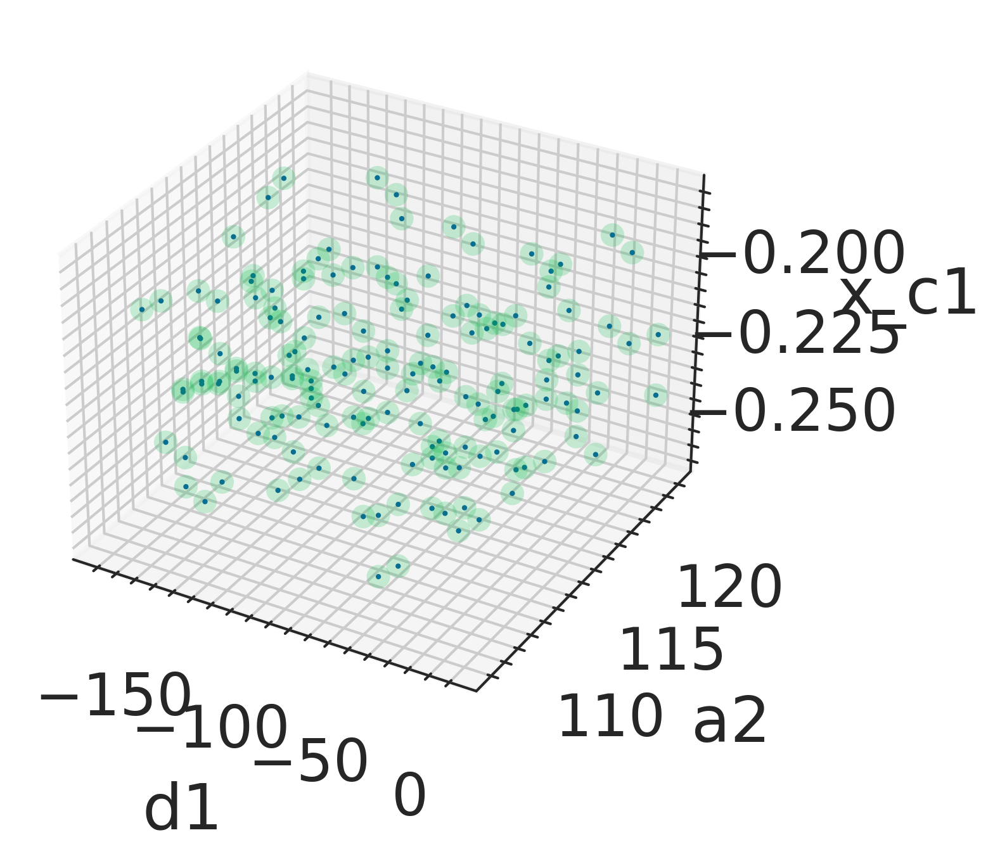

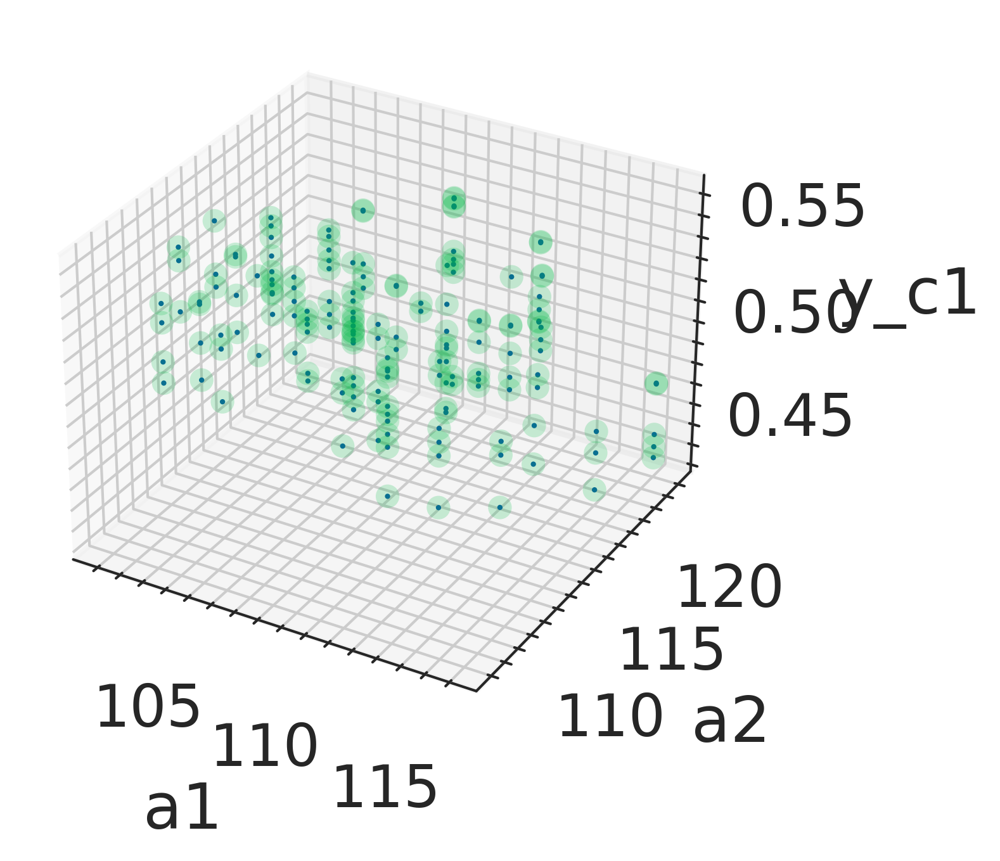

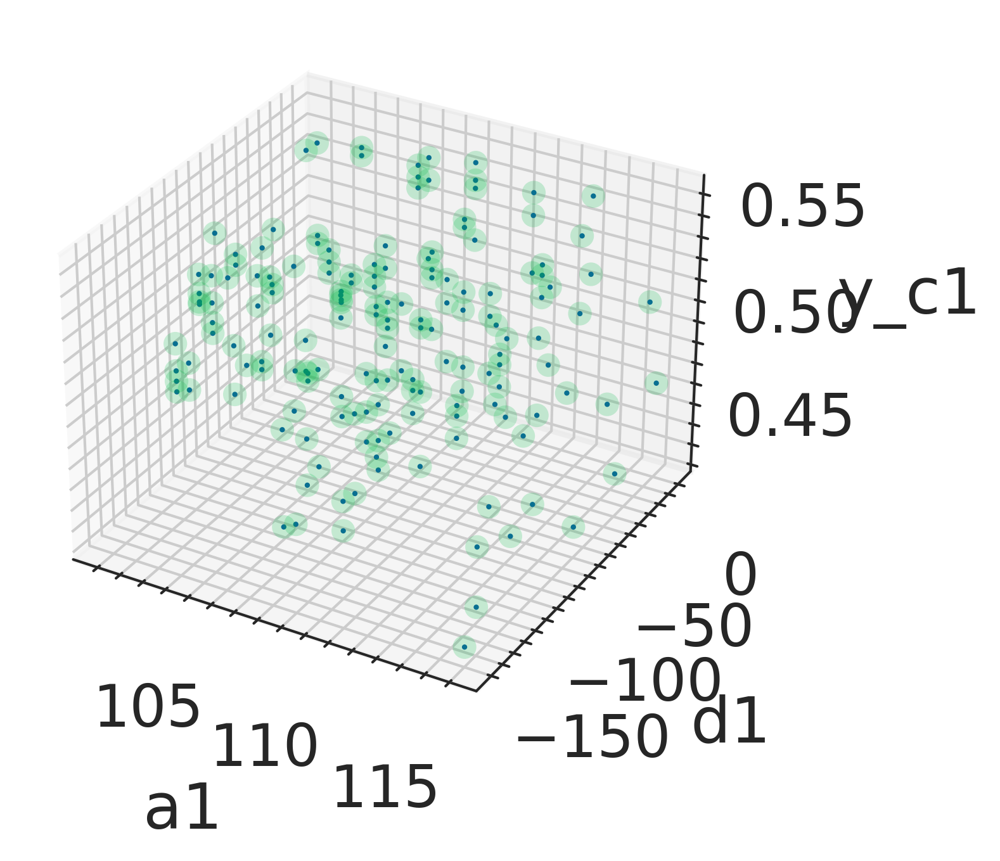

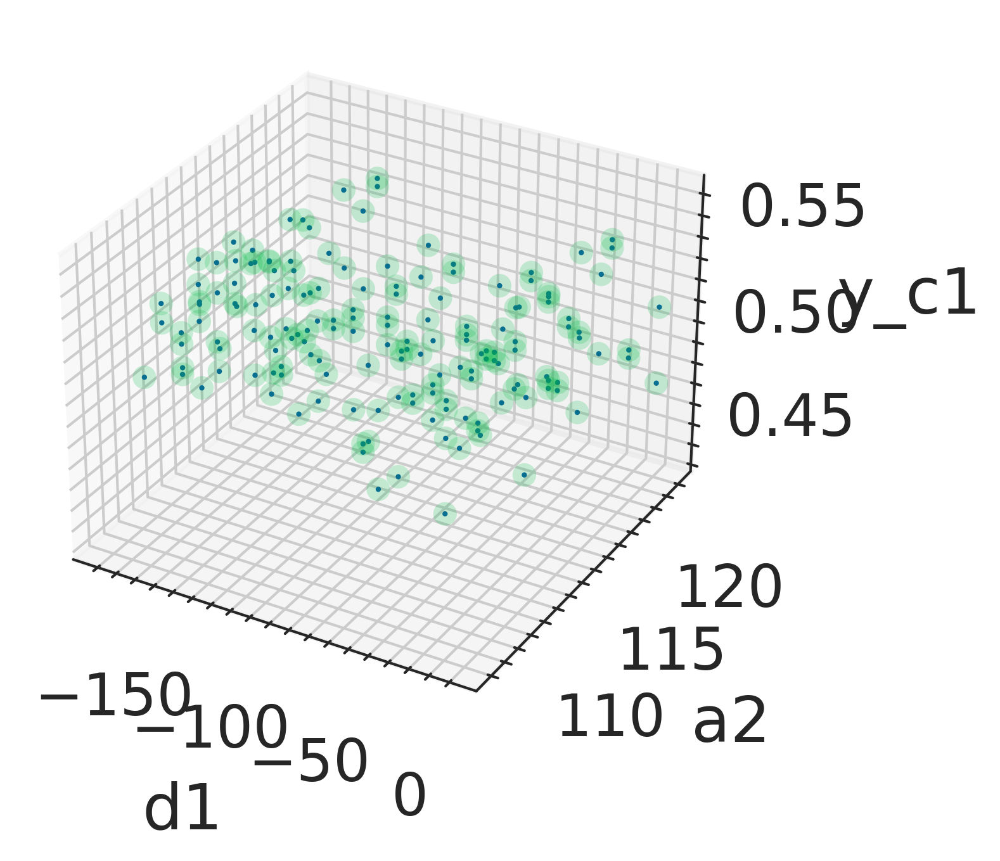

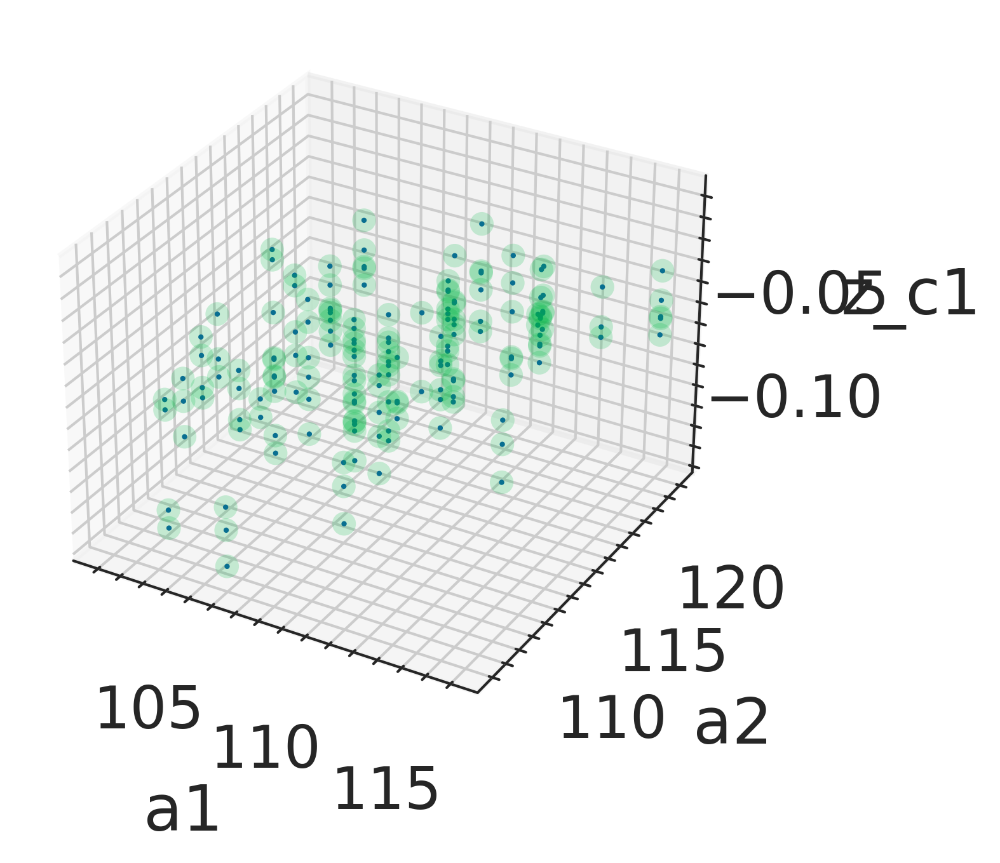

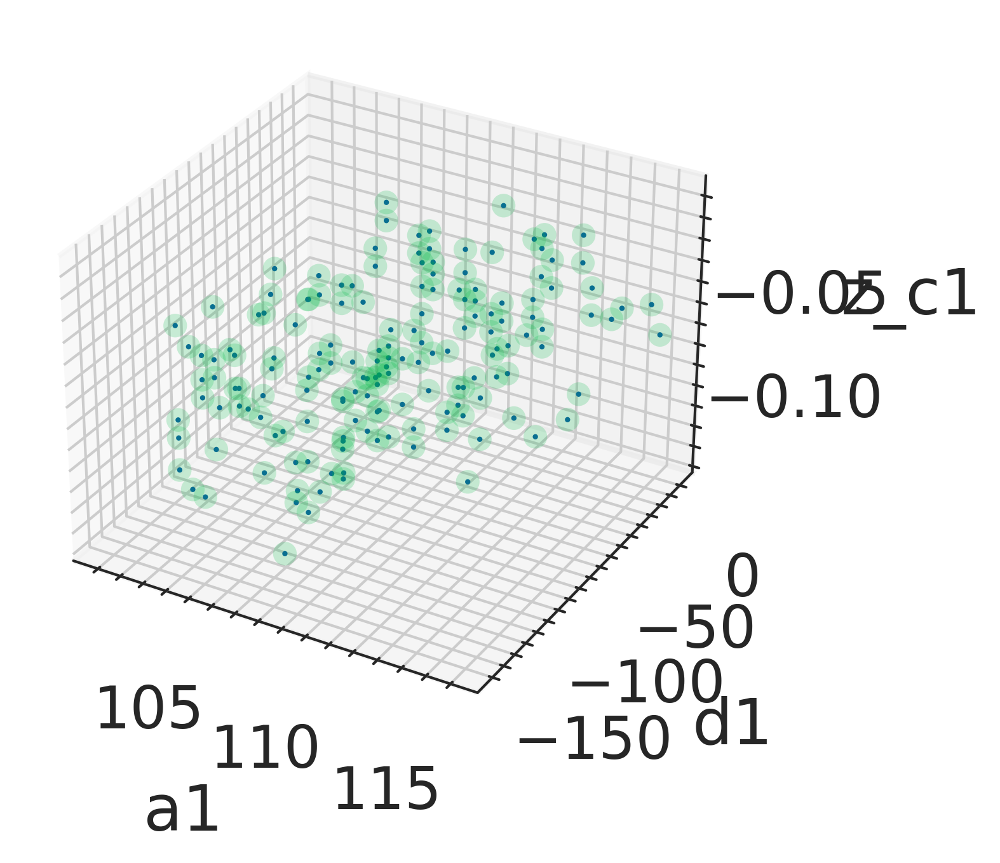

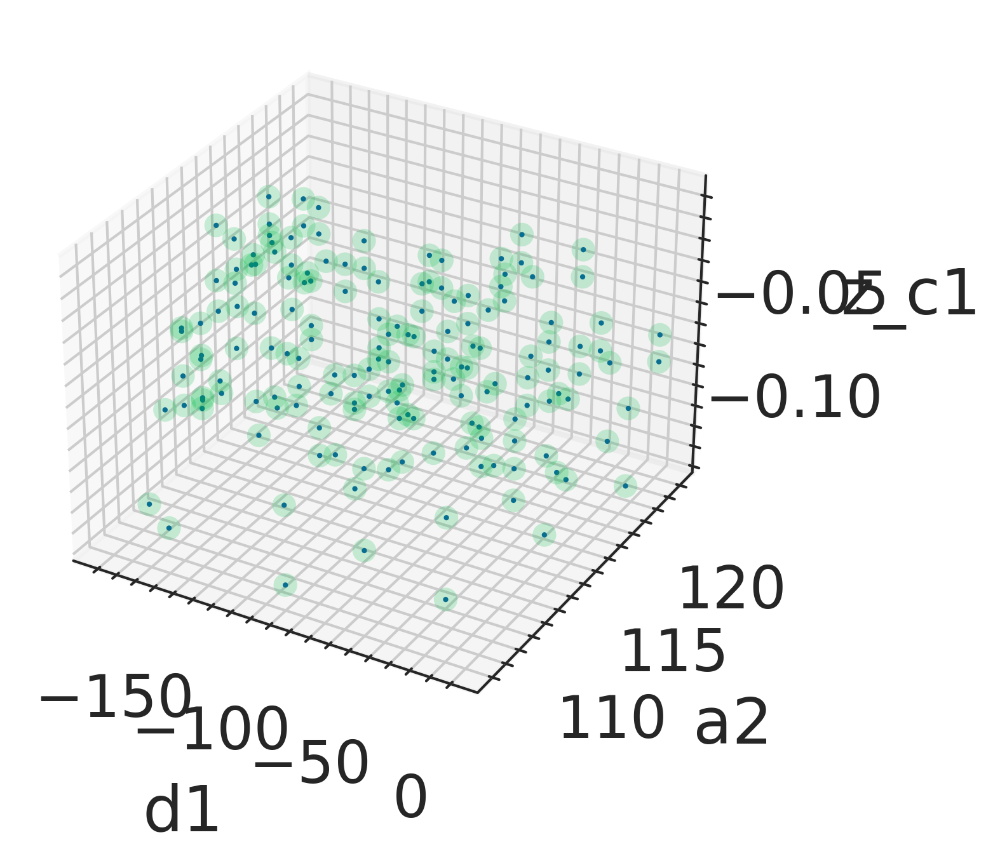

In [695]:
morton_25 = morton_fit3
morton_2 = avg
i = 1
for x in ["x", "y", "z"]:
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(morton_25["a1"], morton_25["a2"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=1, s=1)
    ax.scatter(morton_2["a1"], morton_2["a2"], morton_2[f"{x}_c{i}"], linewidth=0, alpha=0.2)
    ax.set_xlabel("a1")
    ax.set_ylabel("a2")
    ax.set_zlabel(f"{x}_c{i}")
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(morton_25["a1"], morton_25["d1"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=1, s=1)
    ax.scatter(morton_2["a1"], morton_2["d1"], morton_2[f"{x}_c{i}"], linewidth=0, alpha=0.2)
    ax.set_xlabel("a1")
    ax.set_ylabel("d1")
    ax.set_zlabel(f"{x}_c{i}")
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(morton_25["d1"], morton_25["a2"], morton_25[f"{x}_c{i}"], linewidth=0, alpha=1, s=1)
    ax.scatter(morton_2["d1"], morton_2["a2"], morton_2[f"{x}_c{i}"], linewidth=0, alpha=0.2)
    ax.set_xlabel("d1")
    ax.set_ylabel("a2")
    ax.set_zlabel(f"{x}_c{i}")


In [780]:
visited = []
df_ = morton_large_c5
df_ = add_morton_int(df_)
sorted_list, xyz_values = morton_sort(df_, "a1_", "a2_", "d1_")

c_num = 1
for c_num in range(0,24):
    all_distances = []
    for key in range(0,160):
        r = df_[df_["frame"] == key]
        i = np.array([int(r["a1_"]), int(r["a2_"]), int(r["d1_"])])

        gradients.append([last_pos, i])
        colors.append("r")
        alphas.append(1)

        ns = neighbours(i, ranges)
        frame = key_to_frame(df_, i)
    #     print("visiting: frame_", frame)
        visited.append(frame)

        n = [key_to_frame(df_, ii) for ii in ns]
    #     print("neighbours: ", n)

        point1 = df_[df_["frame"] == key][[f"x_c{c_num}", f"y_c{c_num}", f"z_c{c_num}"]]
    #     print(point1)
        distances = []
        for index, neighbour in enumerate(n):

            sub_visit += 1
            #print("    visiting: frame_", neighbour)
            visited.append(neighbour)
            gradients.append([i, ns[index]])
            colors.append("k")
            alphas.append(0.4)

            point2 = df_[df_["frame"] == neighbour][[f"x_c{c_num}", f"y_c{c_num}", f"z_c{c_num}"]]
            distances.append(scipy.spatial.distance.euclidean(point1, point2))

    #         print(key, neighbour, distances[-1])
    #     print(distances)
    #     print(np.mean(distances))
    #     print(np.max(distances))
    #     print()

        last_pos = i
        all_distances.append(distances)

    maxs = [np.max(x) for x in all_distances]
    mean_ = np.mean(maxs)
    std_ = np.std(maxs)
    print(mean_, std_)
    # [np.mean(x) for x in all_distances]

0.25557417565686336 0.27069136811611116
0.26845785123160953 0.23950920230859696
0.4508377059568572 0.3350918925314121
0.48637961964968157 0.33095072397568154
0.4300037477687221 0.29966436667272184
0.38658872200874483 0.2808408050848974
0.4627667373465486 0.3499300211801911
0.19858321184097286 0.31637258881729596
0.2492122007084135 0.25471592902254264
0.30969452737961783 0.346268845096229
0.20612074085602278 0.18978304257192297
0.3137366984762264 0.34787185956012157
0.18637541777099814 0.24857267589990625
0.21396743700867696 0.2755929580196001
0.23080806656415645 0.2905182601731491
0.22184899594409221 0.294582570829848
0.28106121525474304 0.3266341099737859
0.3045501876149361 0.35949897287597776
0.18087740438543884 0.24233164137492755
0.40220852480628777 0.3967209217616527
0.3836402877047997 0.49626712350526414
0.3181840723066038 0.2781860351137271
0.2742232337525391 0.29047795159618733
0.3571496527846301 0.4059805468095267


In [781]:
visited = []
df_ = morton_large5
df_ = add_morton_int(df_)
sorted_list, xyz_values = morton_sort(df_, "a1_", "a2_", "d1_")

c_num = 1
for c_num in range(0,24):
    all_distances = []
    for key in range(0,160):
        r = df_[df_["frame"] == key]
        i = np.array([int(r["a1_"]), int(r["a2_"]), int(r["d1_"])])

        gradients.append([last_pos, i])
        colors.append("r")
        alphas.append(1)

        ns = neighbours(i, ranges)
        frame = key_to_frame(df_, i)
    #     print("visiting: frame_", frame)
        visited.append(frame)

        n = [key_to_frame(df_, ii) for ii in ns]
    #     print("neighbours: ", n)

        point1 = df_[df_["frame"] == key][[f"x_c{c_num}", f"y_c{c_num}", f"z_c{c_num}"]]
    #     print(point1)
        distances = []
        for index, neighbour in enumerate(n):

            sub_visit += 1
            #print("    visiting: frame_", neighbour)
            visited.append(neighbour)
            gradients.append([i, ns[index]])
            colors.append("k")
            alphas.append(0.4)

            point2 = df_[df_["frame"] == neighbour][[f"x_c{c_num}", f"y_c{c_num}", f"z_c{c_num}"]]
            distances.append(scipy.spatial.distance.euclidean(point1, point2))

    #         print(key, neighbour, distances[-1])
    #     print(distances)
    #     print(np.mean(distances))
    #     print(np.max(distances))
    #     print()

        last_pos = i
        all_distances.append(distances)

    maxs = [np.max(x) for x in all_distances]
    mean_ = np.mean(maxs)
    std_ = np.std(maxs)
    print(mean_, std_)
    # [np.mean(x) for x in all_distances]

0.4290784394961259 0.36206191810726296
0.48190571198395526 0.3973910775302228
0.7333239368275632 0.4314535940909594
0.8104226288688616 0.4890503030636909
0.6611646819747532 0.3764304448368422
0.6326783452512078 0.3766463821434212
0.6865145602563851 0.39119181550469617
0.34543365987448366 0.4326990384461931
0.447417776835122 0.3941252609268778
0.5161270560807873 0.4351914932802856
0.3440440548371459 0.25158298040435517
0.5018219223600682 0.3701761279413153
0.42036810932905855 0.4101467516806235
0.4745786306927252 0.3917032025610503
0.5667526349049513 0.48212367875101764
0.5848873925103524 0.4635216366638107
0.6375163501018909 0.5153290546220525
0.6403333660906789 0.45967294786492374
0.27485645104107315 0.2599996892536228
0.7374168882782219 0.45218108971832705
0.7481135183101764 0.549238207988638
0.47805291438873676 0.351205995586182
0.4001422442726228 0.3501104064832104
0.7325340124709498 0.5153884661335298


In [800]:
visited = []
df_ = avg.copy()
df_["frame"] = morton_large5["frame"].copy()
df_ = add_morton_int(df_)
sorted_list, xyz_values = morton_sort(df_, "a1_", "a2_", "d1_")

c_num = 1
for c_num in range(0,24):
    all_distances = []
    for key in range(0,160):
        r = df_[df_["frame"] == key]
        i = np.array([int(r["a1_"]), int(r["a2_"]), int(r["d1_"])])

        gradients.append([last_pos, i])
        colors.append("r")
        alphas.append(1)

        ns = neighbours(i, ranges)
        frame = key_to_frame(df_, i)
    #     print("visiting: frame_", frame)
        visited.append(frame)

        n = [key_to_frame(df_, ii) for ii in ns]
    #     print("neighbours: ", n)

        point1 = df_[df_["frame"] == key][[f"x_c{c_num}", f"y_c{c_num}", f"z_c{c_num}"]]
    #     print(point1)
        distances = []
        for index, neighbour in enumerate(n):

            sub_visit += 1
            #print("    visiting: frame_", neighbour)
            visited.append(neighbour)
            gradients.append([i, ns[index]])
            colors.append("k")
            alphas.append(0.4)

            point2 = df_[df_["frame"] == neighbour][[f"x_c{c_num}", f"y_c{c_num}", f"z_c{c_num}"]]
            distances.append(scipy.spatial.distance.euclidean(point1, point2))

    #         print(key, neighbour, distances[-1])
    #     print(distances)
    #     print(np.mean(distances))
    #     print(np.max(distances))
    #     print()

        last_pos = i
        all_distances.append(distances)

    maxs = [np.max(x) for x in all_distances]
    mean_ = np.mean(maxs)
    std_ = np.std(maxs)
    print(mean_, std_)
    # [np.mean(x) for x in all_distances]

TypeError: cannot convert the series to <class 'int'>

In [798]:
df_

,a1,a2,d1,x_c0,x_c1,x_c2,x_c3,x_c4,x_c5,x_c6,...,q_c18,q_c19,q_c20,q_c21,q_c22,q_c23,a1_,a2_,d1_,frame
0,116.0,121.0,-180.0,-0.326524,-0.231310,-0.164395,-0.123453,-0.072356,-0.103072,-0.077219,...,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,6,6,0,0
1,111.0,121.0,-180.0,-0.320250,-0.210315,-0.136447,-0.088135,-0.144056,-0.156991,-0.010186,...,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,4,6,0,1
2,108.5,118.5,-170.0,-0.281226,-0.124186,-0.004826,0.070502,-0.725025,-0.062639,0.783477,...,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,3,5,1,25
3,108.5,118.5,-180.0,-0.293002,-0.164001,-0.134946,-0.084633,-0.456935,0.147341,0.355397,...,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,3,5,0,7
4,108.5,116.0,-170.0,-0.356926,-0.276189,-0.232614,-0.205439,0.069082,0.008690,-0.175645,...,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,3,4,1,24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,108.5,118.5,-10.0,-0.200006,-0.161057,-0.662060,-0.737868,0.309918,-0.074398,0.449211,...,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,3,5,14,128
156,106.0,118.5,0.0,0.013198,-0.199090,-0.959586,-1.066172,0.323955,-0.103359,0.632162,...,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,2,5,15,153
157,111.0,118.5,0.0,-0.368332,-0.289330,-0.712497,-0.751299,0.053000,-0.006855,0.155463,...,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,4,5,15,152
158,111.0,121.0,0.0,-0.371874,-0.293258,-0.741304,-0.783188,0.058053,-0.003628,0.151333,...,0.463334,-0.992374,0.05878,0.221421,-0.468575,0.24962,4,6,15,158
